In [1]:
import time
import os
from tqdm import tqdm

import pandas as pd
import numpy as np
import cv2
import seaborn as sns
from PIL import Image

import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F

In [3]:
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
import torch.optim as optim
import os

In [4]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('device', device)

device cuda:0


In [49]:
train_dataset_csv = pd.read_csv('Train_Data.csv')
cv_dataset_csv = pd.read_csv('CV_Data.csv')
test_dataset_csv = pd.read_csv('Test_Data.csv')

In [6]:
# print(type(train_dataset_csv))
# print(len(train_dataset_csv))
# train_dataset_csv.head()

# 字典生成

In [7]:
CaptionWordAll = []
CaptionWordLength = []
for idx,data_ in enumerate(train_dataset_csv.iterrows()):
#     print(data_)
    print(data_[1])
    break

Person_id            ../data/NLMCXR/NLMCXR_png/CXR1_1_IM-0001_0
Image1        ../data/NLMCXR/NLMCXR_png/CXR1_1_IM-0001-3001.png
Image2        ../data/NLMCXR/NLMCXR_png/CXR1_1_IM-0001-4001.png
Report        the cardiac silhouette and mediastinum size ar...
Impression                                         normal chest
Name: 0, dtype: object


In [8]:
CaptionWordAll = []
CaptionWordLength = []
for idx,data_ in enumerate(train_dataset_csv.iterrows()):
    caption = data_[1][3]
#     CaptionWordLength.append(len(caption.split(' ')))#修改为split(),否则会出现''单词
    CaptionWordLength.append(len(caption.split()))
    CaptionWordAll.extend(caption.split())

print('平均句子长度为：',np.mean(CaptionWordLength))
print('最大句子长度为：',np.max(CaptionWordLength))
print('最小句子长度为：',np.min(CaptionWordLength))

print('单词总量为：',len(CaptionWordAll))
print('字典长度为：',len(set(CaptionWordAll)))

# 100

from collections import Counter
# 统计频率，按照从高到底排序，这样构建的字典使用频率最高的符号在最前面，查找起来快
counts = Counter(CaptionWordAll)
count_sorted = counts.most_common()
# 删除只出现一次的单词
count_sorted_ = {k: v for k, v in count_sorted if v > 1}
# count_sorted_.pop('')

# 构造字典
# 增加 <pad> 0 <unk> 1 <start> 2 <end> 3  四个作为常用符号

word2id_dict={'<pad>':0,'<unk>':1,'<start>':2,'<end>':3}
id2word_dict={0:'<pad>',1:'<unk>',2:'<start>',3:'<end>'}

for idx,item in enumerate(count_sorted_):
    idx_ = idx+4 # 预留四个做为记录
    item_ = item
    
    word2id_dict[item_] = idx_
    id2word_dict[idx_] = item_

len_dict=len(word2id_dict)

print('修正后字典长度为：',len_dict)

平均句子长度为： 27.158448150833937
最大句子长度为： 137
最小句子长度为： 5
单词总量为： 74903
字典长度为： 1421
修正后字典长度为： 987


In [9]:
# word2id_dict

In [10]:
# count_sorted

In [11]:
import clip

clip.available_models()

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

In [12]:
clip_model, preprocess = clip.load("ViT-B/32",device=device,jit=False,)
# model.cuda().eval()
input_resolution =clip_model.visual.input_resolution
context_length = clip_model.context_length
vocab_size = clip_model.vocab_size

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in clip_model.parameters()]):,}")
print("Input resolution:", input_resolution)
print("Context length:", context_length)
print("Vocab size:", vocab_size)

Model parameters: 151,277,313
Input resolution: 224
Context length: 77
Vocab size: 49408


In [13]:
preprocess

Compose(
    Resize(size=224, interpolation=bicubic, max_size=None, antialias=None)
    CenterCrop(size=(224, 224))
    <function _convert_image_to_rgb at 0x000001DCBAC2F5E0>
    ToTensor()
    Normalize(mean=(0.48145466, 0.4578275, 0.40821073), std=(0.26862954, 0.26130258, 0.27577711))
)

In [14]:
clip_model

CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          

# 图片数据集

In [14]:
class DatasetFromCSV(Dataset):
    def __init__(self, csv_path,preprocess = None):
        # 读取csv文件
        self.data_info = pd.read_csv(csv_path)# 去掉header=None，会读取表头
        #第一列为person_id，以下都为一个列表
        self.person_id = np.asarray(self.data_info.iloc[:, 0])
        self.image1 = np.asarray(self.data_info.iloc[:,1])
        self.image2 = np.asarray(self.data_info.iloc[:,2])
        self.report = np.asarray(self.data_info.iloc[:,3])
        self.impression = np.asarray(self.data_info.iloc[:,3])
        # 长度，train=2758
        self.data_len = len(self.data_info.index)
        
#         self.mode = mode
#         self.w2i_dict = word2id_dict
#         self.maxlength = maxlength # 输入的最长字符数
#         self.padid = 0 # 0为填充符号
#         self.h5f = h5f #暂时去掉文件
        if preprocess is None:
            self.transf = transforms.Compose([transforms.Resize((224,224)),
                                   transforms.ToTensor(),
                                  ])
        else:
            self.transf = preprocess
        
        

    def __getitem__(self, index):
        singel_person_id=self.person_id[index]
        singel_image1=Image.open(self.image1[index])
        singel_image2=Image.open(self.image2[index])
        singel_report=self.report[index]
        singel_impression=self.impression[index]
#         transf=transforms.Compose([transforms.Resize((224,224)),
#                                    transforms.ToTensor(),
#                                   ])
        singel_image1=self.transf(singel_image1)
        singel_image2=self.transf(singel_image2)
    
        return [singel_image1,singel_image2], singel_report,singel_impression, singel_person_id

    def __len__(self):
        return self.data_len


In [15]:
train_dataset = DatasetFromCSV('Train_Data.csv',preprocess = preprocess)
cv_dataset = DatasetFromCSV('CV_Data.csv',preprocess = preprocess)
test_dataset = DatasetFromCSV('Test_Data.csv',preprocess = preprocess)

In [16]:
train_loader=DataLoader(dataset=train_dataset,
                        batch_size=16,
                        shuffle=False,#!!
                        drop_last=True,#!因为Expected input batch_size (4) to match target batch_size (16).错误的原因，暂时修改为TRUE
                        num_workers=0,
                        )
test_loader=DataLoader(dataset=test_dataset,
                        batch_size=16,
                        shuffle=False,#!!
                        drop_last=True,
                        num_workers=0)
cv_loader=DataLoader(dataset=cv_dataset,
                        batch_size=16,
                        shuffle=False,#!!
                        drop_last=True,
                        num_workers=0)

# 提取图像特征

In [23]:
train_dataset_csv

,Person_id,Image1,Image2,Report,Impression
0,../data/NLMCXR/NLMCXR_png/CXR1_1_IM-0001_0,../data/NLMCXR/NLMCXR_png/CXR1_1_IM-0001-3001.png,../data/NLMCXR/NLMCXR_png/CXR1_1_IM-0001-4001.png,the cardiac silhouette and mediastinum size ar...,normal chest
1,../data/NLMCXR/NLMCXR_png/CXR10_IM-0002_0,../data/NLMCXR/NLMCXR_png/CXR10_IM-0002-1001.png,../data/NLMCXR/NLMCXR_png/CXR10_IM-0002-2001.png,the cardiomediastinal silhouette within normal...,no acute cardiopulmonary process
2,../data/NLMCXR/NLMCXR_png/CXR100_IM-0002_0,../data/NLMCXR/NLMCXR_png/CXR100_IM-0002-1001.png,../data/NLMCXR/NLMCXR_png/CXR100_IM-0002-2001.png,both lungs are clear and epanded heart and m...,no active disease
3,../data/NLMCXR/NLMCXR_png/CXR1000_IM-0003_0,../data/NLMCXR/NLMCXR_png/CXR1000_IM-0003-1001...,../data/NLMCXR/NLMCXR_png/CXR1000_IM-0003-2001...,there increased opacity within the right upper...,increased opacity the right upper lobe with as...
4,../data/NLMCXR/NLMCXR_png/CXR1000_IM-0003_1,../data/NLMCXR/NLMCXR_png/CXR1000_IM-0003-1001...,../data/NLMCXR/NLMCXR_png/CXR1000_IM-0003-3001...,there increased opacity within the right upper...,increased opacity the right upper lobe with as...
...,...,...,...,...,...
2753,../data/NLMCXR/NLMCXR_png/CXR3690_IM-1841_0,../data/NLMCXR/NLMCXR_png/CXR3690_IM-1841-1001...,../data/NLMCXR/NLMCXR_png/CXR3690_IM-1841-2001...,the heart again enlarged aorta tortuous th...,stable cardiomegaly without acute disease
2754,../data/NLMCXR/NLMCXR_png/CXR3691_IM-1842_0,../data/NLMCXR/NLMCXR_png/CXR3691_IM-1842-1001...,../data/NLMCXR/NLMCXR_png/CXR3691_IM-1842-3003...,the heart normal size the mediastinum stable...,no acute disease
2755,../data/NLMCXR/NLMCXR_png/CXR3692_IM-1843_0,../data/NLMCXR/NLMCXR_png/CXR3692_IM-1843-1001...,../data/NLMCXR/NLMCXR_png/CXR3692_IM-1843-2001...,stable cardiomediastinal silhouette pulmonar...,no acute cardiopulmonary abnormality
2756,../data/NLMCXR/NLMCXR_png/CXR3693_IM-1844_0,../data/NLMCXR/NLMCXR_png/CXR3693_IM-1844-1001...,../data/NLMCXR/NLMCXR_png/CXR3693_IM-1844-1002...,the lungs are clear bilaterally specifically...,no acute cardiopulmonary abnormality


In [16]:
import h5py

In [17]:
save_path = '../../CLIP-out/h5/'

In [18]:
x=Image.open('../data/NLMCXR/NLMCXR_png/CXR100_IM-0002-2001.png')
preprocess(x).shape

torch.Size([3, 224, 224])

In [50]:
cv_h5f1.close()
cv_h5f2.close()

In [46]:
singel_image1.shape

torch.Size([1, 3, 224, 224])

In [47]:
if not os.path.exists(save_path):
    os.makedirs(save_path)
    
h5f1 = h5py.File(os.path.join(save_path,'train_clip_features1.h5'), 'w')
h5f2 = h5py.File(os.path.join(save_path,'train_clip_features2.h5'), 'w')
for item in train_dataset_csv.iterrows():
    person_id, path1, path2, report, impression = item[1][0],item[1][1],item[1][2],item[1][3],item[1][4],
    #预处理，并升一维
    singel_image1=preprocess(Image.open(path1)).unsqueeze(0).to(device)
    singel_image2=preprocess(Image.open(path2)).unsqueeze(0).to(device)
#     print(singel_image1.shape)# torch.Size([1, 3, 224, 224])
    with torch.no_grad():
        image_features1 = clip_model.encode_image(singel_image1).float()
#         print(image_features1.shape) # torch.Size([1, 512])
        image_features2 = clip_model.encode_image(singel_image2).float()
        # 再把维度降回去
        data1 = image_features1.squeeze().cpu().numpy().astype('float32')
        data2 = image_features2.squeeze().cpu().numpy().astype('float32')

        save_path_h51 = data1
        save_path_h52 = data2
#         h5f1.create_dataset(orie_fin + '_' + item_fin, data=save_path_h51)
#         h5f2.create_dataset(orie_fin + '_' + item_fin, data=save_path_h52)
        h5f1.create_dataset(''.join(person_id), data=save_path_h51)
        h5f2.create_dataset(''.join(person_id), data=save_path_h52)
    
# for batch in train_loader: #采用loader导入数据集、clip提取一个batch16个特征的方法，已废弃
#     i=i+1
#     images, report, impression, person_id = batch
#     image1 = images[0].to(device)
#     image2 = images[1].to(device)
#     report_token = clip.tokenize(texts=report, truncate=True).to(device)
#     with torch.no_grad():
#         image_features1 = clip_model.encode_image(image1).float()
#         image_features2 = clip_model.encode_image(image2).float()
#         data1 = image_features1.cpu().numpy().astype('float32')
#         data2 = image_features2.cpu().numpy().astype('float32')
#         for idx in range(train_loader.batch_size):
#             save_path_h51 = data1[idx]
#     #         h5f1.create_dataset(orie_fin + '_' + item_fin, data=save_path_h51)
#             h5f1.create_dataset(''.join(person_id[idx]), data=save_path_h51)
h5f1.close()
h5f2.close()

In [51]:
# save_path = '../../CLIP-out/h5/'
if not os.path.exists(save_path):
    os.makedirs(save_path)
    
cv_h5f1 = h5py.File(os.path.join(save_path,'cv_clip_features1.h5'), 'w')
cv_h5f2 = h5py.File(os.path.join(save_path,'cv_clip_features2.h5'), 'w')

for item in cv_dataset_csv.iterrows():
    person_id, path1, path2, report, impression = item[1][0],item[1][1],item[1][2],item[1][3],item[1][4],
    #预处理，并升一维
    singel_image1=preprocess(Image.open(path1)).unsqueeze(0).to(device)
    singel_image2=preprocess(Image.open(path2)).unsqueeze(0).to(device)
#     print(singel_image1.shape)# torch.Size([1, 3, 224, 224])
    with torch.no_grad():
        image_features1 = clip_model.encode_image(singel_image1).float()
#         print(image_features1.shape) # torch.Size([1, 512])
        image_features2 = clip_model.encode_image(singel_image2).float()
        # 再把维度降回去
        data1 = image_features1.squeeze().cpu().numpy().astype('float32')
        data2 = image_features2.squeeze().cpu().numpy().astype('float32')

        save_path_h51 = data1
        save_path_h52 = data2
        cv_h5f1.create_dataset(''.join(person_id), data=save_path_h51)
        cv_h5f2.create_dataset(''.join(person_id), data=save_path_h52)
cv_h5f1.close()
cv_h5f2.close()

In [52]:
test_h5f1 = h5py.File(os.path.join(save_path+'test_clip_features1.h5'), 'w')
test_h5f2 = h5py.File(os.path.join(save_path+'test_clip_features2.h5'), 'w')

for item in test_dataset_csv.iterrows():
    person_id, path1, path2, report, impression = item[1][0],item[1][1],item[1][2],item[1][3],item[1][4],
    #预处理，并升一维
    singel_image1=preprocess(Image.open(path1)).unsqueeze(0).to(device)
    singel_image2=preprocess(Image.open(path2)).unsqueeze(0).to(device)
#     print(singel_image1.shape)# torch.Size([1, 3, 224, 224])
    with torch.no_grad():
        image_features1 = clip_model.encode_image(singel_image1).float()
#         print(image_features1.shape) # torch.Size([1, 512])
        image_features2 = clip_model.encode_image(singel_image2).float()
        # 再把维度降回去
        data1 = image_features1.squeeze().cpu().numpy().astype('float32')
        data2 = image_features2.squeeze().cpu().numpy().astype('float32')

        save_path_h51 = data1
        save_path_h52 = data2
        test_h5f1.create_dataset(''.join(person_id), data=save_path_h51)
        test_h5f2.create_dataset(''.join(person_id), data=save_path_h52)
test_h5f1.close()
test_h5f2.close()

In [53]:
import h5py
h5f1 = h5py.File(os.path.join(save_path+'train_clip_features1.h5'), 'r')
h5f2 = h5py.File(os.path.join(save_path+'train_clip_features2.h5'), 'r')
train_feature = h5f1['../data/NLMCXR/NLMCXR_png/CXR1_1_IM-0001_0'] # 
print(np.array(train_feature).shape) # 每个图片保存为一个{{512}}维度的向量

(512,)


# 新数据集

In [59]:
import h5py

class CaptionDataset(Dataset):
    def __init__(self, csv_path,word2id_dict,h5f1,h5f2,maxlength = 40):
        # 读取csv文件
        self.data_info = pd.read_csv(csv_path)# 去掉header=None，会读取表头
        #第一列为person_id，以下都为一个列表
        self.person_id = np.asarray(self.data_info.iloc[:, 0])
        self.image1 = np.asarray(self.data_info.iloc[:,1])
        self.image2 = np.asarray(self.data_info.iloc[:,2])
        self.report = np.asarray(self.data_info.iloc[:,3])
        self.impression = np.asarray(self.data_info.iloc[:,3])
        # 长度，train=2758
        self.data_len = len(self.data_info.index)
        
#         self.mode = mode
        self.w2i_dict = word2id_dict
        self.maxlength = maxlength # 输入的最长字符数
        self.padid = 0 # 0为填充符号
        self.h5f1 = h5f1
        self.h5f2 = h5f2
        

    def __getitem__(self, index):
        singel_person_id=self.person_id[index]
        singel_image1=Image.open(self.image1[index])
        singel_image2=Image.open(self.image2[index])
        singel_report=self.report[index]
        singel_impression=self.impression[index]
        transf=transforms.Compose([transforms.Resize((224,224)),
                                   transforms.ToTensor(),
                                  ])
        singel_image1=transf(singel_image1)
        singel_image2=transf(singel_image2)

        # 读取图像的特征
        img_feature1 = np.array(self.h5f1[singel_person_id]) # 第一个下划线 之前为图片朝向，之后为图像原命名

        # 输入转成idx
        trg,trg_length = self.generIdxList(singel_report) # data

        return img_feature1,trg,trg_length,singel_person_id,[singel_image1,singel_image2], singel_report,singel_impression #特征，
    
#         return [singel_image1,singel_image2], singel_report,singel_impression, singel_person_id

    def __len__(self):
        return self.data_len
    
    
    def generIdxList(self,tdata):
    # 从输入的String中，生成idx的List
        data = tdata.split(' ')
        data_out = []
        # 限制长度，输入'<start>' 和 '<end>'
        data = ['<start>'] + data 

        if len(data)>self.maxlength-1:
            data = data[:self.maxlength-1] # 留一个位置给'<end>
            data = data + ['<end>']

        else:
            # 占位符
            occupy_ = ['<pad>'] * (self.maxlength - 1 - len(data))
            data = data + ['<end>']
            data = data + occupy_

        # word 2 index
        for word in data:

            if self.w2i_dict.get(word)!= None: # 能找到word
                id_ = self.w2i_dict[word]
                data_out.append(id_)
            else:
                id_ = self.w2i_dict['<unk>']
                data_out.append(id_)

        length = len(data_out)-1

        return data_out,length

def stackInput(inputs):

    img_features1 = np.stack([inputsub[0] for inputsub in inputs], axis=0)
    trg = np.stack([inputsub[1] for inputsub in inputs], axis=0)
    trg_length = np.stack([inputsub[2] for inputsub in inputs], axis=0)

#     trg_mask =(trg[:,:-1]!=0).astype(torch.get_default_dtype())
    trg_mask =torch.from_numpy((trg[:,:-1]!=0)).float()
    trg_ = trg[:,1:] # 将start标记更改为 imgfeatures
    
    img_features1=torch.from_numpy(img_features1)
    trg_length=torch.from_numpy(trg_length)
    trg_=torch.from_numpy(trg_)
    trg=torch.from_numpy(trg)
    
    
    return img_features1,trg_length,trg_[:,:-1],trg[:,1:,np.newaxis],trg_mask
    

In [60]:
save_path = '../../CLIP-out/h5/'
train_h5f1 = h5py.File(os.path.join(save_path+'train_clip_features1.h5'), 'r')
train_h5f2 = h5py.File(os.path.join(save_path+'train_clip_features2.h5'), 'r')

cv_h5f1 = h5py.File(os.path.join(save_path+'cv_clip_features1.h5'), 'r')
cv_h5f2 = h5py.File(os.path.join(save_path+'cv_clip_features2.h5'), 'r')

train_dataset = CaptionDataset('Train_Data.csv',word2id_dict,train_h5f1,train_h5f2)
cv_dataset = CaptionDataset('CV_Data.csv',word2id_dict,cv_h5f1,cv_h5f2)
# test_dataset = DatasetFromCSV('Test_Data.csv',word2id_dict)

In [77]:
train_loader=DataLoader(dataset=train_dataset,
                        batch_size=16,
                        shuffle=True,#!!
                        drop_last=True,#!因为Expected input batch_size (4) to match target batch_size (16).错误的原因，暂时修改为TRUE
                        num_workers=0,
                        collate_fn = stackInput)
cv_loader=DataLoader(dataset=cv_dataset,
                    batch_size=16,
                    shuffle=False,#!!
                    drop_last=True,#!因为Expected input batch_size (4) to match target batch_size (16).错误的原因，暂时修改为TRUE
                    num_workers=0,
                    collate_fn = stackInput,)

#  构建模型

In [78]:
class CaptionModel(nn.Module):

    def __init__(self, vocab_size,embedding_dim,hidden_size,num_layers,word2id_dict,id2word_dict):
        
        super(CaptionModel,self).__init__()

        self.hidden_size=hidden_size
        self.num_layers=num_layers        
        self.fc = torch.nn.Linear(512,embedding_dim)
        self.embedding=torch.nn.Embedding(vocab_size,embedding_dim)
        #lstm层
        self.lstm=torch.nn.LSTM (input_size=embedding_dim,
                                hidden_size=hidden_size,
                                num_layers=num_layers,
                                batch_first = True)
        self.word2ix = word2id_dict
        self.ix2word = id2word_dict
        #全连接层
        self.classifier = torch.nn.Linear(hidden_size,vocab_size)

    def forward(self,img_features,trg,trg_length):
        img_features = torch.unsqueeze(self.fc(img_features),dim = 1) 
        embeddings = self.embedding(trg)        
        inputs = torch.cat([img_features,embeddings],dim = 1)
#         print('img_features.shape:',img_features.shape) #img_features.shape: torch.Size([16, 1, 512])
#         print('embeddings.shape:',embeddings.shape) #embeddings.shape: torch.Size([16, 38, 512])
#         print('inputs.shape:',inputs.shape) #inputs.shape: torch.Size([16, 39, 512])
#         outputs,state = self.rnn(inputs,sequence_length = trg_length)
        outputs,state = self.lstm(inputs)
        predict = self.classifier(outputs)

        return predict

    def generate(self, img_feat, eos_token='<end>',
                 beam_size=2,
                 max_caption_length=40,
                 length_normalization_factor=0.0):
        """
        根据图片生成描述,主要是使用beam search算法以得到更好的描述
        """
        cap_gen = CaptionGenerator(embedder=self.embedding,
                                   lstm=self.lstm,
                                   classifier=self.classifier,
                                   eos_id=self.word2ix[eos_token],
                                   beam_size=beam_size,
                                   max_caption_length=max_caption_length,
                                   length_normalization_factor=length_normalization_factor)

        
        img_feat = torch.unsqueeze(img_feat,axis = 0)
        img = torch.unsqueeze(self.fc(img_feat),axis = 0)
        img=img.to(device)
        cap_gen=cap_gen.to(device)
        sentences, score = cap_gen.beam_search(img)
        
        sentences = [' '.join([self.ix2word[int(idx)] for idx in sent]) 
                     for sent in sentences]
        return sentences

In [79]:
# Beam Search
import heapq

class TopN(object):
    """Maintains the top n elements of an incrementally provided set."""

    def __init__(self, n):
        self._n = n
        self._data = []

    def size(self):
        assert self._data is not None
        return len(self._data)

    def push(self, x):
        """Pushes a new element."""
        assert self._data is not None
        if len(self._data) < self._n:
            heapq.heappush(self._data, x)
        else:
            heapq.heappushpop(self._data, x)

    def extract(self, sort=False):
        """
        Extracts all elements from the TopN. This is a destructive operation.
        The only method that can be called immediately after extract() is reset().
        Args:
          sort: Whether to return the elements in descending sorted order.
        Returns:
          A list of data; the top n elements provided to the set.
        """
        assert self._data is not None
        data = self._data
        self._data = None
        if sort:
            data.sort(reverse=True)
        return data

    def reset(self):
        """Returns the TopN to an empty state."""
        self._data = []

class Caption(object):
    """Represents a complete or partial caption."""

    def __init__(self, sentence, state, logprob, score, metadata=None):
        """Initializes the Caption.
        Args:
          sentence: List of word ids in the caption.
          state: Model state after generating the previous word.
          logprob: Log-probability of the caption.
          score: Score of the caption.
          metadata: Optional metadata associated with the partial sentence. If not
            None, a list of strings with the same length as 'sentence'.
        """
        self.sentence = sentence
        self.state = state
        self.logprob = logprob
        self.score = score
        self.metadata = metadata

    def __cmp__(self, other):
        """Compares Captions by score."""
        assert isinstance(other, Caption)
        if self.score == other.score:
            return 0
        elif self.score < other.score:
            return -1
        else:
            return 1

    # For Python 3 compatibility (__cmp__ is deprecated).
    def __lt__(self, other):
        assert isinstance(other, Caption)
        return self.score < other.score

    # Also for Python 3 compatibility.
    def __eq__(self, other):
        assert isinstance(other, Caption)
        return self.score == other.score
# class CaptionGenerator(object):
class CaptionGenerator(nn.Module):
    """Class to generate captions from an image-to-text model."""

    def __init__(self,
                 embedder,
                 lstm,
                 classifier,
                 eos_id,
                 beam_size=3,
                 max_caption_length=100,
                 length_normalization_factor=0.0):
        super(CaptionGenerator,self).__init__()
        """Initializes the generator.
        Args:
          model: recurrent model, with inputs: (input, state) and outputs len(vocab) values
          beam_size: Beam size to use when generating captions.
          max_caption_length: The maximum caption length before stopping the search.
          length_normalization_factor: If != 0, a number x such that captions are
            scored by logprob/length^x, rather than logprob. This changes the
            relative scores of captions depending on their lengths. For example, if
            x > 0 then longer captions will be favored.
        """
        self.embedder = embedder
        self.lstm = lstm
        self.classifier = classifier
        self.eos_id = eos_id
        self.beam_size = beam_size
        self.max_caption_length = max_caption_length
        self.length_normalization_factor = length_normalization_factor

    def beam_search(self, lstm_input, initial_state=None):
        """Runs beam search caption generation on a single image.
        Args:
          initial_state: An initial state for the recurrent model
        Returns:
          A list of Caption sorted by descending score.
        """

        def get_topk_words(embeddings, state):
            output, new_states = self.lstm(embeddings)
            
            output = self.classifier(torch.squeeze(output,axis=0))
#             logprobs = nn.functional.log_softmax(output, axis=-1)
            logprobs = nn.functional.log_softmax(output, dim=-1)

            if len(logprobs.shape) == 3:
                logprobs = torch.squeeze(logprobs)
            logprobs, words = logprobs.topk(self.beam_size, 1)
            return words, logprobs, new_states

        partial_captions  = TopN(self.beam_size)
        complete_captions = TopN(self.beam_size)

        words, logprobs, new_state = get_topk_words(lstm_input, initial_state)

        for k in range(self.beam_size):
            cap = Caption(
                sentence=[words[0, k]],
                state=new_state,
                logprob=logprobs[0, k],
                score=logprobs[0, k])

            partial_captions.push(cap)

        # Run beam search.

        for _ in range(self.max_caption_length - 1):
            partial_captions_list = partial_captions.extract()
            partial_captions.reset()
            input_feed =[c.sentence[-1] for c in partial_captions_list]

            input_feed = torch.tensor(input_feed)
            state_feed = [c.state for c in partial_captions_list]
            if isinstance(state_feed[0], tuple):
                state_feed_h, state_feed_c = zip(*state_feed)
                state_feed = (torch.cat(state_feed_h, 1),
                              torch.cat(state_feed_c, 1))
            else:
                state_feed = torch.cat(state_feed, 1)
            
            input_feed=input_feed.to(device)
            
            embeddings = self.embedder(input_feed)

            words, logprobs, new_states = get_topk_words( 
                embeddings, state_feed)
                
            for i, partial_caption in enumerate(partial_captions_list):
                if isinstance(new_states, tuple):
#                     state = (torch.narrow(new_states[0],axes=[1],starts=[i],ends = [i+1]),
#                              torch.narrow(new_states[1],axes=[1],starts=[i],ends = [i+1]))
                    state = (torch.narrow(new_states[0],dim=1,start=i,length = 1),
                             torch.narrow(new_states[1],dim=1,start=i,length = 1))
                else:
                    state = new_states[i]
                for k in range(self.beam_size):
                    w = words[i, k]
                    sentence = partial_caption.sentence + [w]
                    logprob = partial_caption.logprob + logprobs[i, k]
                    score = logprob
                    if w == self.eos_id:
                        if self.length_normalization_factor > 0:
                            score /= len(sentence)**self.length_normalization_factor
                        beam = Caption(sentence, state, logprob, score)
                        complete_captions.push(beam)
                    else:
                        beam = Caption(sentence, state, logprob, score)
                        partial_captions.push(beam)
            if partial_captions.size() == 0:
                # We have run out of partial candidates; happens when beam_size
                # = 1.
                break

        # If we have no complete captions then fall back to the partial captions.
        # But never output a mixture of complete and partial captions because a
        # partial caption could have a higher score than all the complete
        # captions.
        if not complete_captions.size():
            complete_captions = partial_captions

        caps = complete_captions.extract(sort=True)

        return [c.sentence for c in caps], [c.score for c in caps]

In [80]:
#定义损失函数
class CrossEntropy(nn.Module):
    def __init__(self):
        super(CrossEntropy,self).__init__()

    def forward(self,predicts,label,trg_mask):
#         cost=0.
        loss=nn.CrossEntropyLoss()
        
        '''
        predicts:  torch.Size([16, 39, 989])
        label:  torch.Size([16, 39, 1])
        
        label_mask : shape=[16, 39]
        
        '''
        word_loss_list=[]
        rep_loss_list=[]#存放一个batch的所有loss
        for rep in range(len(predicts)):
            word_loss_list=[]#存放一篇rep中各个单词的loss
            for word in range(len(predicts[rep])):

                cost = loss(torch.unsqueeze(predicts[rep][word],0) , label[rep][word].long()).unsqueeze(0).unsqueeze(0)
                word_loss_list.append(cost)
            word_loss = torch.cat(word_loss_list,dim=0).unsqueeze(0)
            rep_loss_list.append(word_loss)

        rep_loss = torch.cat(rep_loss_list,dim=0)
        
#         print('rep_loss.shape: ',rep_loss.shape)# rep_loss.shape:  torch.Size([16, 39, 1])
#         print('word_loss.shape: ',word_loss.shape)# word_loss.shape:  torch.Size([1, 39, 1])
        # rep_loss_list

        # 删除axis=2 shape上为1的维度
        rep_loss=torch.squeeze(rep_loss)
#         print(rep_loss.shape) # torch.Size([16, 39])
        
        # trg_mask 的形状[batch_size,suqence_len]
        masked_cost=rep_loss*trg_mask
        
        return torch.mean(torch.mean(masked_cost,axis=[0]))

In [81]:
epochs=30
word_size = len_dict #（字典）个数
eos_id=word2id_dict['<end>']
num_layers=32
hidden_size=512
embedding_dim=512
lr=1e-3
maxlength=40
model_path='../output'

In [82]:
model=CaptionModel(word_size,embedding_dim,hidden_size,num_layers,word2id_dict,id2word_dict)
model.to(device)

CaptionModel(
  (fc): Linear(in_features=512, out_features=512, bias=True)
  (embedding): Embedding(987, 512)
  (lstm): LSTM(512, 512, num_layers=32, batch_first=True)
  (classifier): Linear(in_features=512, out_features=987, bias=True)
)

In [83]:
batch_size = 16
# crossentropyloss = nn.CrossEntropyLoss().to(device)
# loss_txt = nn.CrossEntropyLoss().to(device)
# perplexity  = torch.exp(loss)
optimizer = optim.Adam(model.parameters(), lr=lr)

In [84]:
loss_fn = CrossEntropy().to(device)

In [85]:
if hasattr(torch.cuda, 'empty_cache'):
    torch.cuda.empty_cache()

In [86]:
torch.cuda.empty_cache()

In [87]:

model.train()



for epoch in range(epochs):
# for epoch in range(1):
    train_loss=0.0
    
    for batch_id, batch in enumerate(train_loader):
        img_features1,trg_length,inputs,label,label_mask = batch[0].to(device),batch[1].to(device),batch[2].to(device),batch[3].to(device), batch[4].to(device)  # 数据
        
#         images, report, person_id = batch
#         image1 = images[0].to(device)
#         image2 = images[1].to(device)
# #         report='<start>' + report + '<end>'
#         image_features1 = np.array(h5f1[person_id])
#         image_features2 = np.array(h5f2[person_id])
# #         report_token = clip.tokenize(texts=report, truncate=True).to(device)

        predicts = model(img_features1,inputs,trg_length)    # 预测结果
#         print('img_features1: ',img_features1.shape)
#         print('trg_length: ',trg_length.shape)
#         print('inputs: ',inputs.shape)
#         print('label: ',label.shape)
#         print('label_mask: ',label_mask.shape)
#         print('predicts: ',predicts.shape)

        # 计算损失 等价于 prepare 中loss的设置
        loss = loss_fn(predicts, label , label_mask)

#         # 计算困惑度 等价于 prepare 中metrics的设置
#         correct = perplexity.compute(predicts, label)
#         perplexity.update(correct.numpy())
#         ppl = perplexity.accumulate()
        
        # 下面的反向传播、打印训练信息、更新参数、梯度清零都被封装到 Model.fit() 中

        # 反向传播
        loss.backward()

        if (batch_id+1) % 20 == 0:
#             print("epoch: {}, batch_id: {}, loss is: {}, ppl is: {}".format(epoch+1, batch_id+1, loss.item(), ppl))
            print("epoch: {}, batch_id: {}, loss is: {}".format(epoch+1, batch_id+1, loss.item()))
            print(predicts)

            # 保存模型参数，文件名为Unet_model.pdparams
            torch.save(model.state_dict(), '../../CLIP-out/LSTMmodel01.pth')

        # 更新参数
        optimizer.step()

        # 梯度清零
        optimizer.zero_grad()

epoch: 1, batch_id: 20, loss is: 3.9941136837005615
tensor([[[ 2.2391,  3.7444, -2.8784,  ..., -2.7955, -3.3226, -2.0386],
         [ 3.2355,  5.4420, -4.1143,  ..., -4.0140, -4.8203, -2.9618],
         [ 3.4099,  5.7535, -4.3150,  ..., -4.2308, -5.0706, -3.1123],
         ...,
         [ 3.4441,  5.8159, -4.3502,  ..., -4.2720, -5.1146, -3.1408],
         [ 3.4441,  5.8159, -4.3502,  ..., -4.2720, -5.1146, -3.1408],
         [ 3.4441,  5.8159, -4.3502,  ..., -4.2720, -5.1146, -3.1408]],

        [[ 2.2391,  3.7444, -2.8784,  ..., -2.7955, -3.3226, -2.0386],
         [ 3.2355,  5.4420, -4.1143,  ..., -4.0140, -4.8203, -2.9618],
         [ 3.4099,  5.7535, -4.3150,  ..., -4.2308, -5.0706, -3.1123],
         ...,
         [ 3.4441,  5.8159, -4.3502,  ..., -4.2720, -5.1146, -3.1408],
         [ 3.4441,  5.8159, -4.3502,  ..., -4.2720, -5.1146, -3.1408],
         [ 3.4441,  5.8159, -4.3502,  ..., -4.2720, -5.1146, -3.1408]],

        [[ 2.2391,  3.7444, -2.8784,  ..., -2.7955, -3.3226, -2.

epoch: 1, batch_id: 80, loss is: 3.5359747409820557
tensor([[[ 0.5416,  2.5987, -4.2140,  ..., -2.9112, -4.2099, -3.2491],
         [ 1.1420,  3.5513, -5.0266,  ..., -3.4775, -5.5219, -4.3617],
         [ 1.5876,  4.1984, -5.2991,  ..., -3.5676, -5.8490, -4.5275],
         ...,
         [ 2.8768,  5.3200, -5.6112,  ..., -3.8295, -6.2714, -4.8796],
         [ 2.8803,  5.3224, -5.6130,  ..., -3.8309, -6.2749, -4.8818],
         [ 2.8835,  5.3248, -5.6147,  ..., -3.8323, -6.2782, -4.8840]],

        [[ 0.5416,  2.5987, -4.2140,  ..., -2.9112, -4.2099, -3.2491],
         [ 1.1420,  3.5513, -5.0266,  ..., -3.4775, -5.5219, -4.3617],
         [ 1.5876,  4.1984, -5.2991,  ..., -3.5676, -5.8490, -4.5275],
         ...,
         [ 2.8768,  5.3200, -5.6112,  ..., -3.8295, -6.2714, -4.8796],
         [ 2.8803,  5.3224, -5.6130,  ..., -3.8309, -6.2749, -4.8818],
         [ 2.8835,  5.3248, -5.6147,  ..., -3.8323, -6.2782, -4.8840]],

        [[ 0.5416,  2.5987, -4.2140,  ..., -2.9112, -4.2099, -3.

epoch: 1, batch_id: 140, loss is: 3.607219934463501
tensor([[[-0.9554,  2.3975, -4.9072,  ..., -4.3320, -4.7731, -4.0630],
         [-0.6978,  3.2291, -5.8335,  ..., -4.9027, -6.1514, -5.2613],
         [-0.0632,  4.1662, -6.0106,  ..., -5.0459, -6.2871, -5.4917],
         ...,
         [ 3.6064,  5.3531, -6.1161,  ..., -4.6170, -6.5424, -5.4895],
         [ 3.6162,  5.3549, -6.1174,  ..., -4.6166, -6.5463, -5.4911],
         [ 3.6247,  5.3566, -6.1188,  ..., -4.6164, -6.5498, -5.4926]],

        [[-0.9554,  2.3975, -4.9072,  ..., -4.3320, -4.7731, -4.0630],
         [-0.6978,  3.2291, -5.8335,  ..., -4.9027, -6.1514, -5.2613],
         [-0.0632,  4.1662, -6.0106,  ..., -5.0459, -6.2871, -5.4917],
         ...,
         [ 3.6064,  5.3531, -6.1161,  ..., -4.6170, -6.5424, -5.4895],
         [ 3.6162,  5.3549, -6.1174,  ..., -4.6166, -6.5463, -5.4911],
         [ 3.6247,  5.3566, -6.1188,  ..., -4.6164, -6.5498, -5.4926]],

        [[-0.9554,  2.3975, -4.9072,  ..., -4.3320, -4.7731, -4.

epoch: 2, batch_id: 40, loss is: 3.50732421875
tensor([[[-1.6319,  1.9529, -5.2766,  ..., -4.2591, -3.7300, -3.4047],
         [-1.6717,  2.7252, -6.0950,  ..., -4.4078, -4.5009, -4.0262],
         [-1.0297,  3.6957, -6.3009,  ..., -4.5418, -4.2994, -4.1557],
         ...,
         [ 4.1713,  5.3315, -6.3618,  ..., -4.1567, -4.4022, -3.9789],
         [ 4.1759,  5.3326, -6.3624,  ..., -4.1577, -4.4030, -3.9796],
         [ 4.1795,  5.3336, -6.3631,  ..., -4.1588, -4.4036, -3.9803]],

        [[-1.6319,  1.9529, -5.2766,  ..., -4.2591, -3.7300, -3.4047],
         [-1.6717,  2.7252, -6.0950,  ..., -4.4078, -4.5009, -4.0262],
         [-1.0297,  3.6957, -6.3009,  ..., -4.5418, -4.2994, -4.1557],
         ...,
         [ 4.1713,  5.3315, -6.3618,  ..., -4.1567, -4.4022, -3.9789],
         [ 4.1759,  5.3326, -6.3624,  ..., -4.1577, -4.4030, -3.9796],
         [ 4.1795,  5.3336, -6.3631,  ..., -4.1588, -4.4036, -3.9803]],

        [[-1.6319,  1.9529, -5.2766,  ..., -4.2591, -3.7300, -3.4047]

epoch: 2, batch_id: 100, loss is: 3.0322225093841553
tensor([[[-2.0531,  1.9727, -5.7001,  ..., -4.3013, -4.5864, -4.3256],
         [-2.4009,  2.6640, -6.2646,  ..., -4.2486, -5.2081, -4.9393],
         [-1.8106,  3.7137, -6.4527,  ..., -4.2916, -4.8931, -5.0697],
         ...,
         [ 3.8645,  5.3636, -6.2720,  ..., -3.6229, -4.8310, -4.8671],
         [ 3.8845,  5.3671, -6.2710,  ..., -3.6257, -4.8363, -4.8691],
         [ 3.9008,  5.3701, -6.2703,  ..., -3.6282, -4.8407, -4.8710]],

        [[-2.0531,  1.9727, -5.7001,  ..., -4.3013, -4.5864, -4.3256],
         [-2.4009,  2.6640, -6.2646,  ..., -4.2486, -5.2081, -4.9393],
         [-1.8106,  3.7137, -6.4527,  ..., -4.2916, -4.8931, -5.0697],
         ...,
         [ 3.8645,  5.3636, -6.2720,  ..., -3.6229, -4.8310, -4.8671],
         [ 3.8845,  5.3671, -6.2710,  ..., -3.6257, -4.8363, -4.8691],
         [ 3.9008,  5.3701, -6.2703,  ..., -3.6282, -4.8407, -4.8710]],

        [[-2.0531,  1.9727, -5.7001,  ..., -4.3013, -4.5864, -4

epoch: 2, batch_id: 160, loss is: 3.5431876182556152
tensor([[[-2.3591,  1.7589, -5.8764,  ..., -4.5812, -4.1259, -4.6231],
         [-2.8352,  2.6203, -6.4541,  ..., -4.5125, -4.4462, -5.1505],
         [-2.2667,  3.5082, -6.6795,  ..., -4.4429, -3.8643, -5.2406],
         ...,
         [ 3.8685,  5.4875, -6.3980,  ..., -3.5630, -3.4933, -5.1190],
         [ 3.8943,  5.4941, -6.4003,  ..., -3.5719, -3.5055, -5.1255],
         [ 3.9154,  5.4998, -6.4029,  ..., -3.5800, -3.5162, -5.1314]],

        [[-2.3591,  1.7589, -5.8764,  ..., -4.5812, -4.1259, -4.6231],
         [-2.8352,  2.6203, -6.4541,  ..., -4.5125, -4.4462, -5.1505],
         [-2.2667,  3.5082, -6.6795,  ..., -4.4429, -3.8643, -5.2406],
         ...,
         [ 3.8685,  5.4875, -6.3980,  ..., -3.5630, -3.4933, -5.1190],
         [ 3.8943,  5.4941, -6.4003,  ..., -3.5719, -3.5055, -5.1255],
         [ 3.9154,  5.4998, -6.4029,  ..., -3.5800, -3.5162, -5.1314]],

        [[-2.3591,  1.7589, -5.8764,  ..., -4.5812, -4.1259, -4

epoch: 3, batch_id: 60, loss is: 3.5818662643432617
tensor([[[-2.4544,  1.6490, -6.2781,  ..., -4.8411, -5.4120, -4.3304],
         [-3.0462,  2.6200, -6.8619,  ..., -4.6281, -5.7230, -4.6595],
         [-2.4018,  3.6347, -7.1981,  ..., -4.4511, -5.1403, -4.5446],
         ...,
         [ 4.1973,  5.7406, -6.7112,  ..., -3.4584, -4.8251, -4.3498],
         [ 4.1989,  5.7411, -6.7118,  ..., -3.4599, -4.8260, -4.3509],
         [ 4.2002,  5.7415, -6.7125,  ..., -3.4614, -4.8269, -4.3519]],

        [[-2.4544,  1.6490, -6.2781,  ..., -4.8411, -5.4120, -4.3304],
         [-3.0462,  2.6200, -6.8619,  ..., -4.6281, -5.7230, -4.6595],
         [-2.4018,  3.6347, -7.1981,  ..., -4.4511, -5.1403, -4.5446],
         ...,
         [ 4.1973,  5.7406, -6.7112,  ..., -3.4584, -4.8251, -4.3498],
         [ 4.1989,  5.7411, -6.7118,  ..., -3.4599, -4.8260, -4.3509],
         [ 4.2002,  5.7415, -6.7125,  ..., -3.4614, -4.8269, -4.3519]],

        [[-2.4544,  1.6490, -6.2781,  ..., -4.8411, -5.4120, -4.

epoch: 3, batch_id: 120, loss is: 3.711512804031372
tensor([[[-2.5615,  1.5217, -6.2738,  ..., -5.5965, -5.0605, -4.9154],
         [-3.1197,  2.6651, -6.9516,  ..., -5.5964, -5.1892, -5.3220],
         [-2.4876,  3.6633, -7.2786,  ..., -5.4113, -4.4334, -5.2373],
         ...,
         [ 4.1120,  5.3715, -6.5565,  ..., -3.9621, -3.7321, -5.0561],
         [ 4.1466,  5.3787, -6.5501,  ..., -3.9671, -3.7497, -5.0623],
         [ 4.1755,  5.3849, -6.5452,  ..., -3.9718, -3.7650, -5.0679]],

        [[-2.5615,  1.5217, -6.2738,  ..., -5.5965, -5.0605, -4.9154],
         [-3.1197,  2.6651, -6.9516,  ..., -5.5964, -5.1892, -5.3220],
         [-2.4876,  3.6633, -7.2786,  ..., -5.4113, -4.4334, -5.2373],
         ...,
         [ 4.1120,  5.3715, -6.5565,  ..., -3.9621, -3.7321, -5.0561],
         [ 4.1466,  5.3787, -6.5501,  ..., -3.9671, -3.7497, -5.0623],
         [ 4.1755,  5.3849, -6.5452,  ..., -3.9718, -3.7650, -5.0679]],

        [[-2.5615,  1.5217, -6.2738,  ..., -5.5965, -5.0605, -4.

epoch: 4, batch_id: 20, loss is: 3.547736644744873
tensor([[[-2.8764,  1.3674, -6.5861,  ..., -6.1894, -6.0748, -5.4224],
         [-3.5068,  2.6365, -7.2466,  ..., -6.2179, -6.2658, -5.9015],
         [-2.9225,  3.3393, -7.5190,  ..., -5.9244, -5.4897, -5.7525],
         ...,
         [ 3.6692,  5.3266, -6.6047,  ..., -4.5013, -4.5987, -5.4305],
         [ 3.7268,  5.3354, -6.5854,  ..., -4.5093, -4.6274, -5.4381],
         [ 3.7767,  5.3431, -6.5692,  ..., -4.5173, -4.6538, -5.4455]],

        [[-2.8764,  1.3674, -6.5861,  ..., -6.1894, -6.0748, -5.4224],
         [-3.5068,  2.6365, -7.2466,  ..., -6.2179, -6.2658, -5.9015],
         [-2.9225,  3.3393, -7.5190,  ..., -5.9244, -5.4897, -5.7525],
         ...,
         [ 3.6692,  5.3266, -6.6047,  ..., -4.5013, -4.5987, -5.4305],
         [ 3.7268,  5.3354, -6.5854,  ..., -4.5093, -4.6274, -5.4381],
         [ 3.7767,  5.3431, -6.5692,  ..., -4.5173, -4.6538, -5.4455]],

        [[-2.8764,  1.3674, -6.5861,  ..., -6.1894, -6.0748, -5.4

epoch: 4, batch_id: 80, loss is: 3.811472177505493
tensor([[[-2.8685,  1.2016, -6.7220,  ..., -6.4210, -5.6927, -5.6045],
         [-3.3699,  2.6479, -7.4744,  ..., -6.5129, -5.8571, -6.1766],
         [-2.7716,  3.4434, -7.7990,  ..., -6.2013, -4.9460, -6.0419],
         ...,
         [ 3.7011,  5.3481, -6.9026,  ..., -4.7747, -3.7633, -5.6842],
         [ 3.7647,  5.3580, -6.8768,  ..., -4.7806, -3.7962, -5.6898],
         [ 3.8247,  5.3676, -6.8525,  ..., -4.7865, -3.8276, -5.6954]],

        [[-2.8685,  1.2016, -6.7220,  ..., -6.4210, -5.6927, -5.6045],
         [-3.3699,  2.6479, -7.4744,  ..., -6.5129, -5.8571, -6.1766],
         [-2.7716,  3.4434, -7.7990,  ..., -6.2013, -4.9460, -6.0419],
         ...,
         [ 3.7011,  5.3481, -6.9026,  ..., -4.7747, -3.7633, -5.6842],
         [ 3.7647,  5.3580, -6.8768,  ..., -4.7806, -3.7962, -5.6898],
         [ 3.8247,  5.3676, -6.8525,  ..., -4.7865, -3.8276, -5.6954]],

        [[-2.8685,  1.2016, -6.7220,  ..., -6.4210, -5.6927, -5.6

epoch: 4, batch_id: 140, loss is: 3.534959077835083
tensor([[[-2.9805,  1.3331, -6.9208,  ..., -6.1054, -6.3608, -5.8638],
         [-3.5785,  2.8900, -7.7061,  ..., -6.0655, -6.5247, -6.4196],
         [-2.9217,  3.6200, -8.0621,  ..., -5.6661, -5.6118, -6.2811],
         ...,
         [ 4.2672,  5.6392, -6.9691,  ..., -4.2686, -4.6451, -6.0823],
         [ 4.2891,  5.6452, -6.9579,  ..., -4.2740, -4.6596, -6.0870],
         [ 4.3088,  5.6506, -6.9476,  ..., -4.2789, -4.6727, -6.0913]],

        [[-2.9805,  1.3331, -6.9208,  ..., -6.1054, -6.3608, -5.8638],
         [-3.5785,  2.8900, -7.7061,  ..., -6.0655, -6.5247, -6.4196],
         [-2.9217,  3.6200, -8.0621,  ..., -5.6661, -5.6118, -6.2811],
         ...,
         [ 4.2672,  5.6392, -6.9691,  ..., -4.2686, -4.6451, -6.0823],
         [ 4.2891,  5.6452, -6.9579,  ..., -4.2740, -4.6596, -6.0870],
         [ 4.3088,  5.6506, -6.9476,  ..., -4.2789, -4.6727, -6.0913]],

        [[-2.9805,  1.3331, -6.9208,  ..., -6.1054, -6.3608, -5.

epoch: 5, batch_id: 40, loss is: 3.2449305057525635
tensor([[[-3.1997,  1.2091, -6.9522,  ..., -6.2775, -6.8132, -5.2698],
         [-3.8408,  2.8631, -7.7687,  ..., -6.2892, -7.0208, -5.6187],
         [-3.1264,  3.5504, -8.1487,  ..., -5.8096, -6.1571, -5.3398],
         ...,
         [ 4.0115,  5.5693, -6.8964,  ..., -4.0282, -5.1358, -4.9733],
         [ 4.0733,  5.5812, -6.8693,  ..., -4.0377, -5.1701, -4.9836],
         [ 4.1246,  5.5911, -6.8457,  ..., -4.0452, -5.1983, -4.9918]],

        [[-3.1997,  1.2091, -6.9522,  ..., -6.2775, -6.8132, -5.2698],
         [-3.8408,  2.8631, -7.7687,  ..., -6.2892, -7.0208, -5.6187],
         [-3.1264,  3.5504, -8.1487,  ..., -5.8096, -6.1571, -5.3398],
         ...,
         [ 4.0115,  5.5693, -6.8964,  ..., -4.0282, -5.1358, -4.9733],
         [ 4.0733,  5.5812, -6.8693,  ..., -4.0377, -5.1701, -4.9836],
         [ 4.1246,  5.5911, -6.8457,  ..., -4.0452, -5.1983, -4.9918]],

        [[-3.1997,  1.2091, -6.9522,  ..., -6.2775, -6.8132, -5.

epoch: 5, batch_id: 100, loss is: 3.1536078453063965
tensor([[[-3.2862,  1.0097, -7.0001,  ..., -5.8396, -6.1757, -5.5952],
         [-3.9757,  2.6715, -7.6747,  ..., -5.7034, -6.2204, -5.8975],
         [-3.2803,  3.4992, -8.1184,  ..., -5.1138, -5.3157, -5.6678],
         ...,
         [ 4.2052,  5.4655, -6.6670,  ..., -3.0905, -4.2538, -5.3270],
         [ 4.2286,  5.4693, -6.6511,  ..., -3.0919, -4.2649, -5.3295],
         [ 4.2477,  5.4725, -6.6380,  ..., -3.0930, -4.2738, -5.3316]],

        [[-3.2862,  1.0097, -7.0001,  ..., -5.8396, -6.1757, -5.5952],
         [-3.9757,  2.6715, -7.6747,  ..., -5.7034, -6.2204, -5.8975],
         [-3.2803,  3.4992, -8.1184,  ..., -5.1138, -5.3157, -5.6678],
         ...,
         [ 4.2052,  5.4655, -6.6670,  ..., -3.0905, -4.2538, -5.3270],
         [ 4.2286,  5.4693, -6.6511,  ..., -3.0919, -4.2649, -5.3295],
         [ 4.2477,  5.4725, -6.6380,  ..., -3.0930, -4.2738, -5.3316]],

        [[-3.2862,  1.0097, -7.0001,  ..., -5.8396, -6.1757, -5

epoch: 5, batch_id: 160, loss is: 3.4922537803649902
tensor([[[-3.2789,  0.8143, -7.2088,  ..., -6.7554, -6.8197, -5.7854],
         [-3.9917,  2.6272, -7.9554,  ..., -6.7790, -7.0004, -6.1042],
         [-3.3041,  3.3150, -8.2768,  ..., -6.2555, -6.0799, -5.7968],
         ...,
         [ 3.8659,  5.4047, -7.0954,  ..., -4.2008, -4.6898, -5.3876],
         [ 3.9360,  5.4162, -7.0572,  ..., -4.2129, -4.7336, -5.3988],
         [ 4.0036,  5.4274, -7.0204,  ..., -4.2251, -4.7764, -5.4100]],

        [[-3.2789,  0.8143, -7.2088,  ..., -6.7554, -6.8197, -5.7854],
         [-3.9917,  2.6272, -7.9554,  ..., -6.7790, -7.0004, -6.1042],
         [-3.3041,  3.3150, -8.2768,  ..., -6.2555, -6.0799, -5.7968],
         ...,
         [ 3.8659,  5.4047, -7.0954,  ..., -4.2008, -4.6898, -5.3876],
         [ 3.9360,  5.4162, -7.0572,  ..., -4.2129, -4.7336, -5.3988],
         [ 4.0036,  5.4274, -7.0204,  ..., -4.2251, -4.7764, -5.4100]],

        [[-3.2789,  0.8143, -7.2088,  ..., -6.7554, -6.8197, -5

epoch: 6, batch_id: 60, loss is: 3.718207359313965
tensor([[[-3.2916,  1.1218, -7.3813,  ..., -6.3443, -7.2746, -5.7468],
         [-4.0681,  2.7938, -8.1127,  ..., -6.2287, -7.4385, -5.9656],
         [-3.3365,  3.3860, -8.5117,  ..., -5.5547, -6.5851, -5.6028],
         ...,
         [ 3.9508,  5.5422, -7.1975,  ..., -3.3580, -5.3629, -5.2236],
         [ 4.0259,  5.5558, -7.1534,  ..., -3.3772, -5.4159, -5.2413],
         [ 4.0948,  5.5682, -7.1112,  ..., -3.3944, -5.4644, -5.2573]],

        [[-3.2916,  1.1218, -7.3813,  ..., -6.3443, -7.2746, -5.7468],
         [-4.0681,  2.7938, -8.1127,  ..., -6.2287, -7.4385, -5.9656],
         [-3.3365,  3.3860, -8.5117,  ..., -5.5547, -6.5851, -5.6028],
         ...,
         [ 3.9508,  5.5422, -7.1975,  ..., -3.3580, -5.3629, -5.2236],
         [ 4.0259,  5.5558, -7.1534,  ..., -3.3772, -5.4159, -5.2413],
         [ 4.0948,  5.5682, -7.1112,  ..., -3.3944, -5.4644, -5.2573]],

        [[-3.2916,  1.1218, -7.3813,  ..., -6.3443, -7.2746, -5.7

epoch: 6, batch_id: 120, loss is: 2.8855106830596924
tensor([[[-3.4543,  0.8375, -7.4190,  ..., -7.0035, -6.7560, -6.0631],
         [-4.1969,  2.6378, -8.1826,  ..., -6.9976, -6.8239, -6.3083],
         [-3.5248,  3.3515, -8.5478,  ..., -6.4097, -5.8727, -5.9743],
         ...,
         [ 4.1383,  5.5253, -6.8422,  ..., -4.2611, -4.6765, -5.5365],
         [ 4.1764,  5.5302, -6.8096,  ..., -4.2683, -4.7047, -5.5432],
         [ 4.2076,  5.5342, -6.7831,  ..., -4.2745, -4.7285, -5.5489]],

        [[-3.4543,  0.8375, -7.4190,  ..., -7.0035, -6.7560, -6.0631],
         [-4.1969,  2.6378, -8.1826,  ..., -6.9976, -6.8239, -6.3083],
         [-3.5248,  3.3515, -8.5478,  ..., -6.4097, -5.8727, -5.9743],
         ...,
         [ 4.1383,  5.5253, -6.8422,  ..., -4.2611, -4.6765, -5.5365],
         [ 4.1764,  5.5302, -6.8096,  ..., -4.2683, -4.7047, -5.5432],
         [ 4.2076,  5.5342, -6.7831,  ..., -4.2745, -4.7285, -5.5489]],

        [[-3.4543,  0.8375, -7.4190,  ..., -7.0035, -6.7560, -6

epoch: 7, batch_id: 20, loss is: 3.127840995788574
tensor([[[-3.5877,  0.7974, -7.5483,  ..., -7.4015, -7.2918, -5.8075],
         [-4.3371,  2.7790, -8.3839,  ..., -7.4592, -7.3976, -5.9267],
         [-3.5612,  3.5737, -8.8886,  ..., -6.9106, -6.4972, -5.5288],
         ...,
         [ 4.0114,  5.2730, -7.1295,  ..., -4.8581, -5.3319, -5.0092],
         [ 4.0853,  5.2839, -7.0767,  ..., -4.8825, -5.3958, -5.0354],
         [ 4.1452,  5.2927, -7.0313,  ..., -4.9024, -5.4473, -5.0569]],

        [[-3.5877,  0.7974, -7.5483,  ..., -7.4015, -7.2918, -5.8075],
         [-4.3371,  2.7790, -8.3839,  ..., -7.4592, -7.3976, -5.9267],
         [-3.5612,  3.5737, -8.8886,  ..., -6.9106, -6.4972, -5.5288],
         ...,
         [ 4.0114,  5.2730, -7.1295,  ..., -4.8581, -5.3319, -5.0092],
         [ 4.0853,  5.2839, -7.0767,  ..., -4.8825, -5.3958, -5.0354],
         [ 4.1452,  5.2927, -7.0313,  ..., -4.9024, -5.4473, -5.0569]],

        [[-3.5877,  0.7974, -7.5483,  ..., -7.4015, -7.2918, -5.8

epoch: 7, batch_id: 80, loss is: 3.2491819858551025
tensor([[[-3.5994,  0.6131, -7.5840,  ..., -7.1622, -7.5480, -5.6290],
         [-4.3372,  2.6492, -8.5265,  ..., -7.2517, -7.7639, -5.7739],
         [-3.6077,  3.3687, -9.0050,  ..., -6.6164, -6.8811, -5.3255],
         ...,
         [ 4.1761,  5.4213, -7.0874,  ..., -4.2995, -5.6298, -4.6971],
         [ 4.2221,  5.4289, -7.0447,  ..., -4.3117, -5.6645, -4.7124],
         [ 4.2605,  5.4353, -7.0081,  ..., -4.3217, -5.6930, -4.7252]],

        [[-3.5994,  0.6131, -7.5840,  ..., -7.1622, -7.5480, -5.6290],
         [-4.3372,  2.6492, -8.5265,  ..., -7.2517, -7.7639, -5.7739],
         [-3.6077,  3.3687, -9.0050,  ..., -6.6164, -6.8811, -5.3255],
         ...,
         [ 4.1761,  5.4213, -7.0874,  ..., -4.2995, -5.6298, -4.6971],
         [ 4.2221,  5.4289, -7.0447,  ..., -4.3117, -5.6645, -4.7124],
         [ 4.2605,  5.4353, -7.0081,  ..., -4.3217, -5.6930, -4.7252]],

        [[-3.5994,  0.6131, -7.5840,  ..., -7.1622, -7.5480, -5.

epoch: 7, batch_id: 140, loss is: 3.8225293159484863
tensor([[[-3.6329,  0.5607, -7.6084,  ..., -7.4021, -7.2599, -6.1917],
         [-4.4701,  2.5623, -8.3766,  ..., -7.4122, -7.3193, -6.2557],
         [-3.7325,  3.2329, -8.8167,  ..., -6.8496, -6.3469, -5.8374],
         ...,
         [ 4.1604,  5.3577, -7.1625,  ..., -4.6564, -5.0675, -5.3539],
         [ 4.2204,  5.3639, -7.0993,  ..., -4.6668, -5.1115, -5.3657],
         [ 4.2731,  5.3689, -7.0407,  ..., -4.6741, -5.1480, -5.3745]],

        [[-3.6329,  0.5607, -7.6084,  ..., -7.4021, -7.2599, -6.1917],
         [-4.4701,  2.5623, -8.3766,  ..., -7.4122, -7.3193, -6.2557],
         [-3.7325,  3.2329, -8.8167,  ..., -6.8496, -6.3469, -5.8374],
         ...,
         [ 4.1604,  5.3577, -7.1625,  ..., -4.6564, -5.0675, -5.3539],
         [ 4.2204,  5.3639, -7.0993,  ..., -4.6668, -5.1115, -5.3657],
         [ 4.2731,  5.3689, -7.0407,  ..., -4.6741, -5.1480, -5.3745]],

        [[-3.6329,  0.5607, -7.6084,  ..., -7.4021, -7.2599, -6

epoch: 8, batch_id: 40, loss is: 3.308171272277832
tensor([[[-3.7627,  0.7992, -7.8628,  ..., -7.3105, -7.6178, -6.3353],
         [-4.5884,  2.8470, -8.7288,  ..., -7.3266, -7.7338, -6.4444],
         [-3.8255,  3.5925, -9.2197,  ..., -6.7240, -6.8052, -6.0028],
         ...,
         [ 4.1834,  5.5361, -7.1877,  ..., -4.4757, -5.4867, -5.4584],
         [ 4.2455,  5.5473, -7.1326,  ..., -4.4957, -5.5440, -5.4788],
         [ 4.2990,  5.5570, -7.0855,  ..., -4.5134, -5.5940, -5.4966]],

        [[-3.7627,  0.7992, -7.8628,  ..., -7.3105, -7.6178, -6.3353],
         [-4.5884,  2.8470, -8.7288,  ..., -7.3266, -7.7338, -6.4444],
         [-3.8255,  3.5925, -9.2197,  ..., -6.7240, -6.8052, -6.0028],
         ...,
         [ 4.1834,  5.5361, -7.1877,  ..., -4.4757, -5.4867, -5.4584],
         [ 4.2455,  5.5473, -7.1326,  ..., -4.4957, -5.5440, -5.4788],
         [ 4.2990,  5.5570, -7.0855,  ..., -4.5134, -5.5940, -5.4966]],

        [[-3.7627,  0.7992, -7.8628,  ..., -7.3105, -7.6178, -6.3

epoch: 8, batch_id: 100, loss is: 3.1393001079559326
tensor([[[-3.7648,  0.8031, -7.9779,  ..., -7.2177, -7.9322, -6.5222],
         [-4.5676,  3.0301, -8.8814,  ..., -7.1415, -8.0877, -6.6497],
         [-3.8426,  3.6753, -9.2760,  ..., -6.4860, -7.1513, -6.1794],
         ...,
         [ 4.2743,  5.4583, -6.9683,  ..., -4.3658, -5.9145, -5.6699],
         [ 4.3174,  5.4635, -6.9277,  ..., -4.3805, -5.9506, -5.6831],
         [ 4.3503,  5.4673, -6.8960,  ..., -4.3913, -5.9777, -5.6928]],

        [[-3.7648,  0.8031, -7.9779,  ..., -7.2177, -7.9322, -6.5222],
         [-4.5676,  3.0301, -8.8814,  ..., -7.1415, -8.0877, -6.6497],
         [-3.8426,  3.6753, -9.2760,  ..., -6.4860, -7.1513, -6.1794],
         ...,
         [ 4.2743,  5.4583, -6.9683,  ..., -4.3658, -5.9145, -5.6699],
         [ 4.3174,  5.4635, -6.9277,  ..., -4.3805, -5.9506, -5.6831],
         [ 4.3503,  5.4673, -6.8960,  ..., -4.3913, -5.9777, -5.6928]],

        [[-3.7648,  0.8031, -7.9779,  ..., -7.2177, -7.9322, -6

epoch: 8, batch_id: 160, loss is: 3.49444580078125
tensor([[[-3.8966,  0.5538, -7.9507,  ..., -7.2759, -7.4998, -6.7655],
         [-4.6572,  2.7240, -8.9279,  ..., -7.3234, -7.5717, -6.9683],
         [-3.8898,  3.3080, -9.3599,  ..., -6.6409, -6.6266, -6.5813],
         ...,
         [ 3.9497,  5.2798, -7.5603,  ..., -4.0925, -5.0231, -5.9460],
         [ 4.0262,  5.2905, -7.4971,  ..., -4.1226, -5.0969, -5.9718],
         [ 4.1020,  5.3018, -7.4320,  ..., -4.1518, -5.1688, -5.9970]],

        [[-3.8966,  0.5538, -7.9507,  ..., -7.2759, -7.4998, -6.7655],
         [-4.6572,  2.7240, -8.9279,  ..., -7.3234, -7.5717, -6.9683],
         [-3.8898,  3.3080, -9.3599,  ..., -6.6409, -6.6266, -6.5813],
         ...,
         [ 3.9497,  5.2798, -7.5603,  ..., -4.0925, -5.0231, -5.9460],
         [ 4.0262,  5.2905, -7.4971,  ..., -4.1226, -5.0969, -5.9718],
         [ 4.1020,  5.3018, -7.4320,  ..., -4.1518, -5.1688, -5.9970]],

        [[-3.8966,  0.5538, -7.9507,  ..., -7.2759, -7.4998, -6.7

epoch: 9, batch_id: 60, loss is: 3.220726490020752
tensor([[[-4.0015,  0.5611, -8.0151,  ..., -7.2619, -7.9713, -7.0065],
         [-4.7005,  2.9982, -9.1167,  ..., -7.3684, -8.1831, -7.3988],
         [-3.9588,  3.5440, -9.5652,  ..., -6.6522, -7.2587, -7.0087],
         ...,
         [ 3.8684,  5.4924, -7.5806,  ..., -4.0974, -5.5817, -6.3126],
         [ 3.9107,  5.4986, -7.5402,  ..., -4.1152, -5.6248, -6.3286],
         [ 3.9537,  5.5052, -7.4982,  ..., -4.1328, -5.6676, -6.3444]],

        [[-4.0015,  0.5611, -8.0151,  ..., -7.2619, -7.9713, -7.0065],
         [-4.7005,  2.9982, -9.1167,  ..., -7.3684, -8.1831, -7.3988],
         [-3.9588,  3.5440, -9.5652,  ..., -6.6522, -7.2587, -7.0087],
         ...,
         [ 3.8684,  5.4924, -7.5806,  ..., -4.0974, -5.5817, -6.3126],
         [ 3.9107,  5.4986, -7.5402,  ..., -4.1152, -5.6248, -6.3286],
         [ 3.9537,  5.5052, -7.4982,  ..., -4.1328, -5.6676, -6.3444]],

        [[-4.0015,  0.5611, -8.0151,  ..., -7.2619, -7.9713, -7.0

epoch: 9, batch_id: 120, loss is: 3.5967516899108887
tensor([[[-4.0572,  0.4275, -8.1754,  ..., -7.3540, -7.6244, -7.1806],
         [-4.8883,  2.5262, -9.1076,  ..., -7.3274, -7.6300, -7.3927],
         [-4.1058,  3.3987, -9.6096,  ..., -6.6011, -6.6738, -7.0656],
         ...,
         [ 3.9856,  5.4012, -7.5666,  ..., -3.9095, -5.0183, -6.4110],
         [ 4.0553,  5.4105, -7.4942,  ..., -3.9392, -5.0834, -6.4329],
         [ 4.1238,  5.4202, -7.4221,  ..., -3.9681, -5.1471, -6.4548]],

        [[-4.0572,  0.4275, -8.1754,  ..., -7.3540, -7.6244, -7.1806],
         [-4.8883,  2.5262, -9.1076,  ..., -7.3274, -7.6300, -7.3927],
         [-4.1058,  3.3987, -9.6096,  ..., -6.6011, -6.6738, -7.0656],
         ...,
         [ 3.9856,  5.4012, -7.5666,  ..., -3.9095, -5.0183, -6.4110],
         [ 4.0553,  5.4105, -7.4942,  ..., -3.9392, -5.0834, -6.4329],
         [ 4.1238,  5.4202, -7.4221,  ..., -3.9681, -5.1471, -6.4548]],

        [[-4.0572,  0.4275, -8.1754,  ..., -7.3540, -7.6244, -7

epoch: 10, batch_id: 20, loss is: 3.1559946537017822
tensor([[[-4.0426,  0.2659, -8.2462,  ..., -7.7918, -8.0010, -6.3343],
         [-4.8029,  2.5021, -9.2873,  ..., -7.9588, -8.1197, -6.4985],
         [-3.9845,  3.3350, -9.7824,  ..., -7.2641, -7.1540, -6.0093],
         ...,
         [ 4.4794,  5.4746, -7.6069,  ..., -4.8253, -6.0552, -5.6141],
         [ 4.5483,  5.4869, -7.5305,  ..., -4.8518, -6.1142, -5.6418],
         [ 4.6063,  5.4973, -7.4594,  ..., -4.8712, -6.1590, -5.6634]],

        [[-4.0426,  0.2659, -8.2462,  ..., -7.7918, -8.0010, -6.3343],
         [-4.8029,  2.5021, -9.2873,  ..., -7.9588, -8.1197, -6.4985],
         [-3.9845,  3.3350, -9.7824,  ..., -7.2641, -7.1540, -6.0093],
         ...,
         [ 4.4794,  5.4746, -7.6069,  ..., -4.8253, -6.0552, -5.6141],
         [ 4.5483,  5.4869, -7.5305,  ..., -4.8518, -6.1142, -5.6418],
         [ 4.6063,  5.4973, -7.4594,  ..., -4.8712, -6.1590, -5.6634]],

        [[-4.0426,  0.2659, -8.2462,  ..., -7.7918, -8.0010, -6

epoch: 10, batch_id: 80, loss is: 3.1749353408813477
tensor([[[-4.1567,  0.2010, -8.2538,  ..., -8.0013, -8.2327, -6.6436],
         [-4.9068,  2.6585, -9.3463,  ..., -8.2572, -8.4150, -6.8911],
         [-4.0893,  3.3985, -9.8714,  ..., -7.5878, -7.5093, -6.4185],
         ...,
         [ 4.2796,  5.4864, -7.7584,  ..., -5.1463, -6.2106, -5.9994],
         [ 4.3893,  5.5029, -7.6519,  ..., -5.1989, -6.3176, -6.0509],
         [ 4.4869,  5.5174, -7.5491,  ..., -5.2430, -6.4095, -6.0953]],

        [[-4.1567,  0.2010, -8.2538,  ..., -8.0013, -8.2327, -6.6436],
         [-4.9068,  2.6585, -9.3463,  ..., -8.2572, -8.4150, -6.8911],
         [-4.0893,  3.3985, -9.8714,  ..., -7.5878, -7.5093, -6.4185],
         ...,
         [ 4.2796,  5.4864, -7.7584,  ..., -5.1463, -6.2106, -5.9994],
         [ 4.3893,  5.5029, -7.6519,  ..., -5.1989, -6.3176, -6.0509],
         [ 4.4869,  5.5174, -7.5491,  ..., -5.2430, -6.4095, -6.0953]],

        [[-4.1567,  0.2010, -8.2538,  ..., -8.0013, -8.2327, -6

epoch: 10, batch_id: 140, loss is: 3.4937584400177
tensor([[[-4.2762,  0.4783, -8.5013,  ..., -7.8777, -8.0209, -7.1924],
         [-5.0926,  2.6853, -9.5293,  ..., -7.9564, -7.9706, -7.3811],
         [-4.3194,  3.3542, -9.9832,  ..., -7.1988, -6.9718, -6.9097],
         ...,
         [ 3.9565,  5.3861, -8.0199,  ..., -4.7270, -5.4527, -6.3785],
         [ 4.0446,  5.3988, -7.9366,  ..., -4.7806, -5.5575, -6.4206],
         [ 4.1326,  5.4119, -7.8476,  ..., -4.8315, -5.6574, -6.4615]],

        [[-4.2762,  0.4783, -8.5013,  ..., -7.8777, -8.0209, -7.1924],
         [-5.0926,  2.6853, -9.5293,  ..., -7.9564, -7.9706, -7.3811],
         [-4.3194,  3.3542, -9.9832,  ..., -7.1988, -6.9718, -6.9097],
         ...,
         [ 3.9565,  5.3861, -8.0199,  ..., -4.7270, -5.4527, -6.3785],
         [ 4.0446,  5.3988, -7.9366,  ..., -4.7806, -5.5575, -6.4206],
         [ 4.1326,  5.4119, -7.8476,  ..., -4.8315, -5.6574, -6.4615]],

        [[-4.2762,  0.4783, -8.5013,  ..., -7.8777, -8.0209, -7.1

epoch: 11, batch_id: 40, loss is: 3.2345831394195557
tensor([[[ -4.3603,   0.6595,  -8.4840,  ...,  -7.5229,  -8.5053,  -7.4293],
         [ -5.1264,   2.8160,  -9.5435,  ...,  -7.5916,  -8.5196,  -7.6999],
         [ -4.3203,   3.6014, -10.0799,  ...,  -6.8011,  -7.5979,  -7.2785],
         ...,
         [  4.0333,   5.5286,  -8.0371,  ...,  -3.9049,  -5.9916,  -6.7421],
         [  4.1258,   5.5435,  -7.9498,  ...,  -3.9660,  -6.0964,  -6.7845],
         [  4.2187,   5.5578,  -7.8550,  ...,  -4.0247,  -6.1986,  -6.8261]],

        [[ -4.3603,   0.6595,  -8.4840,  ...,  -7.5229,  -8.5053,  -7.4293],
         [ -5.1264,   2.8160,  -9.5435,  ...,  -7.5916,  -8.5196,  -7.6999],
         [ -4.3203,   3.6014, -10.0799,  ...,  -6.8011,  -7.5979,  -7.2785],
         ...,
         [  4.0333,   5.5286,  -8.0371,  ...,  -3.9049,  -5.9916,  -6.7421],
         [  4.1258,   5.5435,  -7.9498,  ...,  -3.9660,  -6.0964,  -6.7845],
         [  4.2187,   5.5578,  -7.8550,  ...,  -4.0247,  -6.1986,  -6.

epoch: 11, batch_id: 100, loss is: 3.197181463241577
tensor([[[ -4.3028,   0.4624,  -8.5800,  ...,  -8.0648,  -8.3003,  -7.3178],
         [ -5.0581,   2.7653,  -9.6531,  ...,  -8.2149,  -8.2469,  -7.5536],
         [ -4.2226,   3.5303, -10.1458,  ...,  -7.4482,  -7.2322,  -7.0689],
         ...,
         [  4.1641,   5.4703,  -8.0830,  ...,  -4.4505,  -5.5314,  -6.5185],
         [  4.2175,   5.4818,  -8.0446,  ...,  -4.4878,  -5.6020,  -6.5480],
         [  4.2739,   5.4936,  -7.9999,  ...,  -4.5250,  -5.6734,  -6.5778]],

        [[ -4.3028,   0.4624,  -8.5800,  ...,  -8.0648,  -8.3003,  -7.3178],
         [ -5.0581,   2.7653,  -9.6531,  ...,  -8.2149,  -8.2469,  -7.5536],
         [ -4.2226,   3.5303, -10.1458,  ...,  -7.4482,  -7.2322,  -7.0689],
         ...,
         [  4.1641,   5.4703,  -8.0830,  ...,  -4.4505,  -5.5314,  -6.5185],
         [  4.2175,   5.4818,  -8.0446,  ...,  -4.4878,  -5.6020,  -6.5480],
         [  4.2739,   5.4936,  -7.9999,  ...,  -4.5250,  -5.6734,  -6.

epoch: 11, batch_id: 160, loss is: 3.251579761505127
tensor([[[ -4.4753,   0.1865,  -8.5599,  ...,  -7.8598,  -8.3697,  -7.1077],
         [ -5.1914,   2.5976,  -9.6677,  ...,  -8.0060,  -8.2956,  -7.3702],
         [ -4.3764,   3.4127, -10.2367,  ...,  -7.2637,  -7.4685,  -6.9328],
         ...,
         [  4.4253,   5.5079,  -7.7075,  ...,  -4.7352,  -6.4215,  -6.6983],
         [  4.4983,   5.5168,  -7.6007,  ...,  -4.7643,  -6.4849,  -6.7201],
         [  4.5481,   5.5212,  -7.5209,  ...,  -4.7795,  -6.5236,  -6.7312]],

        [[ -4.4753,   0.1865,  -8.5599,  ...,  -7.8598,  -8.3697,  -7.1077],
         [ -5.1914,   2.5976,  -9.6677,  ...,  -8.0060,  -8.2956,  -7.3702],
         [ -4.3764,   3.4127, -10.2367,  ...,  -7.2637,  -7.4685,  -6.9328],
         ...,
         [  4.4253,   5.5079,  -7.7075,  ...,  -4.7352,  -6.4215,  -6.6983],
         [  4.4983,   5.5168,  -7.6007,  ...,  -4.7643,  -6.4849,  -6.7201],
         [  4.5481,   5.5212,  -7.5209,  ...,  -4.7795,  -6.5236,  -6.

epoch: 12, batch_id: 60, loss is: 2.7072031497955322
tensor([[[ -4.5957,   0.5205,  -8.6849,  ...,  -7.8513,  -8.8046,  -7.4691],
         [ -5.3074,   2.9253,  -9.7396,  ...,  -7.8965,  -8.6820,  -7.7085],
         [ -4.5660,   3.6104, -10.3119,  ...,  -7.1572,  -7.8505,  -7.3230],
         ...,
         [  4.1516,   5.3605,  -7.7551,  ...,  -4.5891,  -6.5820,  -6.9681],
         [  4.2623,   5.3768,  -7.6370,  ...,  -4.6691,  -6.7079,  -7.0250],
         [  4.3560,   5.3913,  -7.5376,  ...,  -4.7361,  -6.8155,  -7.0740]],

        [[ -4.5957,   0.5205,  -8.6849,  ...,  -7.8513,  -8.8046,  -7.4691],
         [ -5.3074,   2.9253,  -9.7396,  ...,  -7.8965,  -8.6820,  -7.7085],
         [ -4.5660,   3.6104, -10.3119,  ...,  -7.1572,  -7.8505,  -7.3230],
         ...,
         [  4.1516,   5.3605,  -7.7551,  ...,  -4.5891,  -6.5820,  -6.9681],
         [  4.2623,   5.3768,  -7.6370,  ...,  -4.6691,  -6.7079,  -7.0250],
         [  4.3560,   5.3913,  -7.5376,  ...,  -4.7361,  -6.8155,  -7.

epoch: 12, batch_id: 120, loss is: 3.229996919631958
tensor([[[ -4.6968,   0.3073,  -8.7310,  ...,  -8.1634,  -8.4155,  -7.6686],
         [ -5.4115,   2.6171,  -9.7806,  ...,  -8.3354,  -8.2186,  -7.9391],
         [ -4.6361,   3.4669, -10.3426,  ...,  -7.6008,  -7.2690,  -7.5336],
         ...,
         [  4.0663,   5.4499,  -8.1088,  ...,  -4.8487,  -5.7315,  -7.0630],
         [  4.1953,   5.4638,  -7.9708,  ...,  -4.9227,  -5.8730,  -7.1085],
         [  4.3230,   5.4784,  -7.8300,  ...,  -4.9967,  -6.0114,  -7.1559]],

        [[ -4.6968,   0.3073,  -8.7310,  ...,  -8.1634,  -8.4155,  -7.6686],
         [ -5.4115,   2.6171,  -9.7806,  ...,  -8.3354,  -8.2186,  -7.9391],
         [ -4.6361,   3.4669, -10.3426,  ...,  -7.6008,  -7.2690,  -7.5336],
         ...,
         [  4.0663,   5.4499,  -8.1088,  ...,  -4.8487,  -5.7315,  -7.0630],
         [  4.1953,   5.4638,  -7.9708,  ...,  -4.9227,  -5.8730,  -7.1085],
         [  4.3230,   5.4784,  -7.8300,  ...,  -4.9967,  -6.0114,  -7.

epoch: 13, batch_id: 20, loss is: 3.5861406326293945
tensor([[[ -4.7853,   0.0687,  -8.7756,  ...,  -8.0554,  -8.8260,  -7.2170],
         [ -5.5545,   2.4802,  -9.8902,  ...,  -8.2727,  -8.7493,  -7.4258],
         [ -4.7070,   3.3944, -10.4947,  ...,  -7.5080,  -7.8278,  -6.9873],
         ...,
         [  4.0877,   5.4507,  -8.1419,  ...,  -4.5430,  -6.3251,  -6.5740],
         [  4.2037,   5.4672,  -8.0270,  ...,  -4.6181,  -6.4574,  -6.6266],
         [  4.3227,   5.4842,  -7.9027,  ...,  -4.6911,  -6.5861,  -6.6791]],

        [[ -4.7853,   0.0687,  -8.7756,  ...,  -8.0554,  -8.8260,  -7.2170],
         [ -5.5545,   2.4802,  -9.8902,  ...,  -8.2727,  -8.7493,  -7.4258],
         [ -4.7070,   3.3944, -10.4947,  ...,  -7.5080,  -7.8278,  -6.9873],
         ...,
         [  4.0877,   5.4507,  -8.1419,  ...,  -4.5430,  -6.3251,  -6.5740],
         [  4.2037,   5.4672,  -8.0270,  ...,  -4.6181,  -6.4574,  -6.6266],
         [  4.3227,   5.4842,  -7.9027,  ...,  -4.6911,  -6.5861,  -6.

epoch: 13, batch_id: 80, loss is: 3.3999156951904297
tensor([[[ -4.7444,   0.2080,  -8.8697,  ...,  -8.3799,  -9.1022,  -7.0829],
         [ -5.5114,   2.6523,  -9.9473,  ...,  -8.6348,  -9.0245,  -7.2072],
         [ -4.6406,   3.5488, -10.5393,  ...,  -7.8971,  -8.1403,  -6.6919],
         ...,
         [  4.5334,   5.6142,  -8.1355,  ...,  -5.2737,  -7.1307,  -6.6777],
         [  4.6754,   5.6325,  -7.9545,  ...,  -5.3582,  -7.2767,  -6.7454],
         [  4.7814,   5.6452,  -7.8078,  ...,  -5.4159,  -7.3813,  -6.7920]],

        [[ -4.7444,   0.2080,  -8.8697,  ...,  -8.3799,  -9.1022,  -7.0829],
         [ -5.5114,   2.6523,  -9.9473,  ...,  -8.6348,  -9.0245,  -7.2072],
         [ -4.6406,   3.5488, -10.5393,  ...,  -7.8971,  -8.1403,  -6.6919],
         ...,
         [  4.5334,   5.6142,  -8.1355,  ...,  -5.2737,  -7.1307,  -6.6777],
         [  4.6754,   5.6325,  -7.9545,  ...,  -5.3582,  -7.2767,  -6.7454],
         [  4.7814,   5.6452,  -7.8078,  ...,  -5.4159,  -7.3813,  -6.

epoch: 13, batch_id: 140, loss is: 2.915699005126953
tensor([[[ -4.8372,   0.3013,  -8.9454,  ...,  -8.3085,  -8.8325,  -7.5713],
         [ -5.6074,   2.8696, -10.0105,  ...,  -8.5247,  -8.6512,  -7.7234],
         [ -4.7719,   3.5080, -10.5687,  ...,  -7.7268,  -7.6638,  -7.2462],
         ...,
         [  4.4288,   5.4891,  -8.0703,  ...,  -4.7947,  -6.6072,  -7.0920],
         [  4.6077,   5.5117,  -7.8827,  ...,  -4.9231,  -6.8212,  -7.1908],
         [  4.7468,   5.5322,  -7.7474,  ...,  -5.0315,  -6.9982,  -7.2777]],

        [[ -4.8372,   0.3013,  -8.9454,  ...,  -8.3085,  -8.8325,  -7.5713],
         [ -5.6074,   2.8696, -10.0105,  ...,  -8.5247,  -8.6512,  -7.7234],
         [ -4.7719,   3.5080, -10.5687,  ...,  -7.7268,  -7.6638,  -7.2462],
         ...,
         [  4.4288,   5.4891,  -8.0703,  ...,  -4.7947,  -6.6072,  -7.0920],
         [  4.6077,   5.5117,  -7.8827,  ...,  -4.9231,  -6.8212,  -7.1908],
         [  4.7468,   5.5322,  -7.7474,  ...,  -5.0315,  -6.9982,  -7.

epoch: 14, batch_id: 40, loss is: 3.173271417617798
tensor([[[ -4.9156,   0.2528,  -8.8769,  ...,  -8.1960,  -8.4554,  -7.7839],
         [ -5.5986,   2.8437, -10.0757,  ...,  -8.4469,  -8.1828,  -8.0965],
         [ -4.7211,   3.4646, -10.7685,  ...,  -7.6780,  -7.2073,  -7.7009],
         ...,
         [  4.4408,   5.5559,  -8.6741,  ...,  -4.9970,  -6.2851,  -7.5532],
         [  4.5569,   5.5634,  -8.6023,  ...,  -5.1129,  -6.4542,  -7.6364],
         [  4.6575,   5.5670,  -8.5094,  ...,  -5.2002,  -6.5860,  -7.7016]],

        [[ -4.9156,   0.2528,  -8.8769,  ...,  -8.1960,  -8.4554,  -7.7839],
         [ -5.5986,   2.8437, -10.0757,  ...,  -8.4469,  -8.1828,  -8.0965],
         [ -4.7211,   3.4646, -10.7685,  ...,  -7.6780,  -7.2073,  -7.7009],
         ...,
         [  4.4408,   5.5559,  -8.6741,  ...,  -4.9970,  -6.2851,  -7.5532],
         [  4.5569,   5.5634,  -8.6023,  ...,  -5.1129,  -6.4542,  -7.6364],
         [  4.6575,   5.5670,  -8.5094,  ...,  -5.2002,  -6.5860,  -7.7

epoch: 14, batch_id: 100, loss is: 2.9519577026367188
tensor([[[ -4.8572,   0.1499,  -8.9755,  ...,  -7.8483,  -8.9541,  -7.9938],
         [ -5.5545,   2.6935, -10.1523,  ...,  -8.0076,  -8.7773,  -8.3444],
         [ -4.7183,   3.4196, -10.7920,  ...,  -7.1637,  -7.8109,  -7.9434],
         ...,
         [  4.3683,   5.5206,  -8.3528,  ...,  -4.0105,  -6.5880,  -7.5579],
         [  4.5434,   5.5374,  -8.1136,  ...,  -4.1126,  -6.7636,  -7.6145],
         [  4.7017,   5.5512,  -7.9147,  ...,  -4.2190,  -6.9354,  -7.6796]],

        [[ -4.8572,   0.1499,  -8.9755,  ...,  -7.8483,  -8.9541,  -7.9938],
         [ -5.5545,   2.6935, -10.1523,  ...,  -8.0076,  -8.7773,  -8.3444],
         [ -4.7183,   3.4196, -10.7920,  ...,  -7.1637,  -7.8109,  -7.9434],
         ...,
         [  4.3683,   5.5206,  -8.3528,  ...,  -4.0105,  -6.5880,  -7.5579],
         [  4.5434,   5.5374,  -8.1136,  ...,  -4.1126,  -6.7636,  -7.6145],
         [  4.7017,   5.5512,  -7.9147,  ...,  -4.2190,  -6.9354,  -7

epoch: 14, batch_id: 160, loss is: 3.6181914806365967
tensor([[[ -4.9049,   0.1751,  -8.9147,  ...,  -8.2794,  -9.1288,  -7.5552],
         [ -5.6367,   2.4386, -10.0354,  ...,  -8.5277,  -8.9970,  -7.7564],
         [ -4.7790,   3.3737, -10.7106,  ...,  -7.7768,  -8.1655,  -7.3379],
         ...,
         [  4.5181,   5.5027,  -8.0082,  ...,  -4.8311,  -7.1109,  -7.2205],
         [  4.6853,   5.5216,  -7.7892,  ...,  -4.9443,  -7.3012,  -7.2988],
         [  4.7978,   5.5385,  -7.6572,  ...,  -5.0307,  -7.4538,  -7.3582]],

        [[ -4.9049,   0.1751,  -8.9147,  ...,  -8.2794,  -9.1288,  -7.5552],
         [ -5.6367,   2.4386, -10.0354,  ...,  -8.5277,  -8.9970,  -7.7564],
         [ -4.7790,   3.3737, -10.7106,  ...,  -7.7768,  -8.1655,  -7.3379],
         ...,
         [  4.5181,   5.5027,  -8.0082,  ...,  -4.8311,  -7.1109,  -7.2205],
         [  4.6853,   5.5216,  -7.7892,  ...,  -4.9443,  -7.3012,  -7.2988],
         [  4.7978,   5.5385,  -7.6572,  ...,  -5.0307,  -7.4538,  -7

epoch: 15, batch_id: 60, loss is: 2.9351677894592285
tensor([[[ -5.0296,   0.1762,  -9.0695,  ...,  -8.0848,  -9.5243,  -7.9773],
         [ -5.7504,   2.7983, -10.1680,  ...,  -8.1961,  -9.3281,  -8.1733],
         [ -4.9330,   3.5240, -10.8002,  ...,  -7.3738,  -8.4638,  -7.7599],
         ...,
         [  4.0899,   5.5836,  -8.6475,  ...,  -4.1787,  -7.2027,  -7.5129],
         [  4.2270,   5.6030,  -8.5257,  ...,  -4.2918,  -7.3671,  -7.5797],
         [  4.4005,   5.6208,  -8.3080,  ...,  -4.3993,  -7.5365,  -7.6455]],

        [[ -5.0296,   0.1762,  -9.0695,  ...,  -8.0848,  -9.5243,  -7.9773],
         [ -5.7504,   2.7983, -10.1680,  ...,  -8.1961,  -9.3281,  -8.1733],
         [ -4.9330,   3.5240, -10.8002,  ...,  -7.3738,  -8.4638,  -7.7599],
         ...,
         [  4.0899,   5.5836,  -8.6475,  ...,  -4.1787,  -7.2027,  -7.5129],
         [  4.2270,   5.6030,  -8.5257,  ...,  -4.2918,  -7.3671,  -7.5797],
         [  4.4005,   5.6208,  -8.3080,  ...,  -4.3993,  -7.5365,  -7.

epoch: 15, batch_id: 120, loss is: 3.16145920753479
tensor([[[ -5.0713,  -0.0396,  -9.0756,  ...,  -8.5213,  -9.6604,  -8.1380],
         [ -5.7648,   2.4753, -10.2761,  ...,  -8.7795,  -9.5446,  -8.4381],
         [ -4.9249,   3.3558, -10.9036,  ...,  -7.9804,  -8.6100,  -8.0129],
         ...,
         [  4.5013,   5.5881,  -8.4087,  ...,  -5.0762,  -7.8262,  -7.8864],
         [  4.6982,   5.6036,  -8.1302,  ...,  -5.1778,  -7.9956,  -7.9604],
         [  4.8490,   5.6214,  -7.8943,  ...,  -5.2372,  -8.1092,  -8.0104]],

        [[ -5.0713,  -0.0396,  -9.0756,  ...,  -8.5213,  -9.6604,  -8.1380],
         [ -5.7648,   2.4753, -10.2761,  ...,  -8.7795,  -9.5446,  -8.4381],
         [ -4.9249,   3.3558, -10.9036,  ...,  -7.9804,  -8.6100,  -8.0129],
         ...,
         [  4.5013,   5.5881,  -8.4087,  ...,  -5.0762,  -7.8262,  -7.8864],
         [  4.6982,   5.6036,  -8.1302,  ...,  -5.1778,  -7.9956,  -7.9604],
         [  4.8490,   5.6214,  -7.8943,  ...,  -5.2372,  -8.1092,  -8.0

epoch: 16, batch_id: 20, loss is: 3.619715452194214
tensor([[[ -4.9977,   0.3675,  -9.1498,  ...,  -8.8407,  -9.2045,  -7.7798],
         [ -5.6991,   2.7997, -10.3474,  ...,  -9.1725,  -8.9737,  -7.9757],
         [ -4.7799,   3.7049, -11.0888,  ...,  -8.4720,  -8.1393,  -7.5403],
         ...,
         [  4.3743,   5.6532,  -8.8125,  ...,  -5.2064,  -6.7147,  -7.2377],
         [  4.4615,   5.6673,  -8.8050,  ...,  -5.2991,  -6.8511,  -7.2991],
         [  4.5615,   5.6808,  -8.7917,  ...,  -5.4015,  -7.0007,  -7.3674]],

        [[ -4.9977,   0.3675,  -9.1498,  ...,  -8.8407,  -9.2045,  -7.7798],
         [ -5.6991,   2.7997, -10.3474,  ...,  -9.1725,  -8.9737,  -7.9757],
         [ -4.7799,   3.7049, -11.0888,  ...,  -8.4720,  -8.1393,  -7.5403],
         ...,
         [  4.3743,   5.6532,  -8.8125,  ...,  -5.2064,  -6.7147,  -7.2377],
         [  4.4615,   5.6673,  -8.8050,  ...,  -5.2991,  -6.8511,  -7.2991],
         [  4.5615,   5.6808,  -8.7917,  ...,  -5.4015,  -7.0007,  -7.3

epoch: 16, batch_id: 80, loss is: 3.271425724029541
tensor([[[ -5.2720,   0.1500,  -9.1948,  ...,  -8.5921,  -9.4622,  -7.5392],
         [ -5.9778,   2.7621, -10.4232,  ...,  -8.8641,  -9.2692,  -7.6488],
         [ -5.1318,   3.4604, -11.0966,  ...,  -8.0985,  -8.3853,  -7.1521],
         ...,
         [  4.3553,   5.5425,  -8.4310,  ...,  -5.2089,  -7.4369,  -7.0931],
         [  4.6164,   5.5465,  -8.1020,  ...,  -5.3550,  -7.6829,  -7.2064],
         [  4.7878,   5.5622,  -7.9166,  ...,  -5.4595,  -7.8599,  -7.2946]],

        [[ -5.2720,   0.1500,  -9.1948,  ...,  -8.5921,  -9.4622,  -7.5392],
         [ -5.9778,   2.7621, -10.4232,  ...,  -8.8641,  -9.2692,  -7.6488],
         [ -5.1318,   3.4604, -11.0966,  ...,  -8.0985,  -8.3853,  -7.1521],
         ...,
         [  4.3553,   5.5425,  -8.4310,  ...,  -5.2089,  -7.4369,  -7.0931],
         [  4.6164,   5.5465,  -8.1020,  ...,  -5.3550,  -7.6829,  -7.2064],
         [  4.7878,   5.5622,  -7.9166,  ...,  -5.4595,  -7.8599,  -7.2

epoch: 16, batch_id: 140, loss is: 3.454695224761963
tensor([[[ -5.2411,   0.2057,  -9.1921,  ...,  -8.5000,  -9.0418,  -7.9685],
         [ -5.9337,   2.5707, -10.3961,  ...,  -8.7240,  -8.6824,  -8.0877],
         [ -5.0706,   3.4271, -11.0774,  ...,  -7.9555,  -7.7861,  -7.6359],
         ...,
         [  4.2631,   5.7020,  -8.7451,  ...,  -5.0253,  -7.0895,  -7.7000],
         [  4.5335,   5.7129,  -8.3551,  ...,  -5.1691,  -7.3462,  -7.8037],
         [  4.7060,   5.7318,  -8.1201,  ...,  -5.2537,  -7.5116,  -7.8753]],

        [[ -5.2411,   0.2057,  -9.1921,  ...,  -8.5000,  -9.0418,  -7.9685],
         [ -5.9337,   2.5707, -10.3961,  ...,  -8.7240,  -8.6824,  -8.0877],
         [ -5.0706,   3.4271, -11.0774,  ...,  -7.9555,  -7.7861,  -7.6359],
         ...,
         [  4.2631,   5.7020,  -8.7451,  ...,  -5.0253,  -7.0895,  -7.7000],
         [  4.5335,   5.7129,  -8.3551,  ...,  -5.1691,  -7.3462,  -7.8037],
         [  4.7060,   5.7318,  -8.1201,  ...,  -5.2537,  -7.5116,  -7.

epoch: 17, batch_id: 40, loss is: 3.598367214202881
tensor([[[ -5.1407,   0.2918,  -9.2665,  ...,  -8.9027,  -9.4710,  -8.2966],
         [ -5.7995,   2.5818, -10.5155,  ...,  -9.2546,  -9.2559,  -8.5307],
         [ -4.9160,   3.4292, -11.2132,  ...,  -8.5160,  -8.3882,  -8.1154],
         ...,
         [  4.4278,   5.5630,  -8.7346,  ...,  -5.3512,  -7.3497,  -7.8771],
         [  4.6630,   5.5724,  -8.3921,  ...,  -5.4667,  -7.5670,  -7.9491],
         [  4.8819,   5.5698,  -8.1465,  ...,  -5.6102,  -7.8010,  -8.0471]],

        [[ -5.1407,   0.2918,  -9.2665,  ...,  -8.9027,  -9.4710,  -8.2966],
         [ -5.7995,   2.5818, -10.5155,  ...,  -9.2546,  -9.2559,  -8.5307],
         [ -4.9160,   3.4292, -11.2132,  ...,  -8.5160,  -8.3882,  -8.1154],
         ...,
         [  4.4278,   5.5630,  -8.7346,  ...,  -5.3512,  -7.3497,  -7.8771],
         [  4.6630,   5.5724,  -8.3921,  ...,  -5.4667,  -7.5670,  -7.9491],
         [  4.8819,   5.5698,  -8.1465,  ...,  -5.6102,  -7.8010,  -8.0

epoch: 17, batch_id: 100, loss is: 3.408966064453125
tensor([[[ -5.2304,   0.1902,  -9.3144,  ...,  -8.9000,  -9.6525,  -7.9682],
         [ -5.8977,   2.4915, -10.5712,  ...,  -9.2550,  -9.4683,  -8.1230],
         [ -5.0144,   3.3054, -11.2236,  ...,  -8.4781,  -8.5303,  -7.5969],
         ...,
         [  4.5355,   5.5752,  -9.1205,  ...,  -5.7585,  -8.1813,  -7.8852],
         [  4.6857,   5.5806,  -8.8626,  ...,  -5.8011,  -8.2937,  -7.9187],
         [  4.8551,   5.5790,  -8.4152,  ...,  -5.7710,  -8.3327,  -7.9042]],

        [[ -5.2304,   0.1902,  -9.3144,  ...,  -8.9000,  -9.6525,  -7.9682],
         [ -5.8977,   2.4915, -10.5712,  ...,  -9.2550,  -9.4683,  -8.1230],
         [ -5.0144,   3.3054, -11.2236,  ...,  -8.4781,  -8.5303,  -7.5969],
         ...,
         [  4.5355,   5.5752,  -9.1205,  ...,  -5.7585,  -8.1813,  -7.8852],
         [  4.6857,   5.5806,  -8.8626,  ...,  -5.8011,  -8.2937,  -7.9187],
         [  4.8551,   5.5790,  -8.4152,  ...,  -5.7710,  -8.3327,  -7.

epoch: 17, batch_id: 160, loss is: 3.1271486282348633
tensor([[[ -5.3544,   0.3031,  -9.3555,  ...,  -8.6547,  -9.8254,  -8.3113],
         [ -6.0116,   2.8383, -10.6428,  ...,  -8.9803,  -9.7316,  -8.5321],
         [ -5.1081,   3.4957, -11.2681,  ...,  -8.1631,  -8.7915,  -7.9992],
         ...,
         [  4.3551,   5.4356,  -9.0666,  ...,  -5.2264,  -8.1229,  -8.0629],
         [  4.4065,   5.4271,  -9.0557,  ...,  -5.2886,  -8.1843,  -8.1117],
         [  4.4745,   5.4176,  -8.9367,  ...,  -5.3191,  -8.2196,  -8.1375]],

        [[ -5.3544,   0.3031,  -9.3555,  ...,  -8.6547,  -9.8254,  -8.3113],
         [ -6.0116,   2.8383, -10.6428,  ...,  -8.9803,  -9.7316,  -8.5321],
         [ -5.1081,   3.4957, -11.2681,  ...,  -8.1631,  -8.7915,  -7.9992],
         ...,
         [  4.3551,   5.4356,  -9.0666,  ...,  -5.2264,  -8.1229,  -8.0629],
         [  4.4065,   5.4271,  -9.0557,  ...,  -5.2886,  -8.1843,  -8.1117],
         [  4.4745,   5.4176,  -8.9367,  ...,  -5.3191,  -8.2196,  -8

epoch: 18, batch_id: 60, loss is: 3.273557186126709
tensor([[[ -5.2694,   0.0678,  -9.3992,  ...,  -9.0092,  -9.5330,  -8.0449],
         [ -5.8896,   2.4583, -10.6405,  ...,  -9.3490,  -9.2888,  -8.1461],
         [ -5.0194,   3.3968, -11.2931,  ...,  -8.5510,  -8.2748,  -7.6218],
         ...,
         [  4.3771,   5.5190,  -8.9827,  ...,  -5.5771,  -7.6241,  -7.7262],
         [  4.6182,   5.5219,  -8.6983,  ...,  -5.7555,  -7.9068,  -7.8528],
         [  4.7785,   5.5436,  -8.5444,  ...,  -5.8827,  -8.1266,  -7.9532]],

        [[ -5.2694,   0.0678,  -9.3992,  ...,  -9.0092,  -9.5330,  -8.0449],
         [ -5.8896,   2.4583, -10.6405,  ...,  -9.3490,  -9.2888,  -8.1461],
         [ -5.0194,   3.3968, -11.2931,  ...,  -8.5510,  -8.2748,  -7.6218],
         ...,
         [  4.3771,   5.5190,  -8.9827,  ...,  -5.5771,  -7.6241,  -7.7262],
         [  4.6182,   5.5219,  -8.6983,  ...,  -5.7555,  -7.9068,  -7.8528],
         [  4.7785,   5.5436,  -8.5444,  ...,  -5.8827,  -8.1266,  -7.9

epoch: 18, batch_id: 120, loss is: 3.467217206954956
tensor([[[ -5.3096,   0.1473,  -9.5207,  ...,  -8.6790,  -9.2622,  -8.3768],
         [ -5.9498,   2.7019, -10.7206,  ...,  -8.8950,  -8.8761,  -8.5239],
         [ -5.0437,   3.5450, -11.3948,  ...,  -8.0670,  -7.8479,  -8.0164],
         ...,
         [  4.6651,   5.5260,  -9.3311,  ...,  -5.2923,  -7.7309,  -8.3928],
         [  4.8089,   5.5325,  -9.0899,  ...,  -5.3447,  -7.8300,  -8.4379],
         [  4.9507,   5.5361,  -8.7138,  ...,  -5.3328,  -7.8689,  -8.4322]],

        [[ -5.3096,   0.1473,  -9.5207,  ...,  -8.6790,  -9.2622,  -8.3768],
         [ -5.9498,   2.7019, -10.7206,  ...,  -8.8950,  -8.8761,  -8.5239],
         [ -5.0437,   3.5450, -11.3948,  ...,  -8.0670,  -7.8479,  -8.0164],
         ...,
         [  4.6651,   5.5260,  -9.3311,  ...,  -5.2923,  -7.7309,  -8.3928],
         [  4.8089,   5.5325,  -9.0899,  ...,  -5.3447,  -7.8300,  -8.4379],
         [  4.9507,   5.5361,  -8.7138,  ...,  -5.3328,  -7.8689,  -8.

epoch: 19, batch_id: 20, loss is: 3.5122478008270264
tensor([[[ -5.3130,   0.1628,  -9.4843,  ...,  -8.6448,  -9.5786,  -8.4469],
         [ -5.9647,   2.6692, -10.7885,  ...,  -9.0360,  -9.4192,  -8.8498],
         [ -5.0971,   3.3198, -11.4032,  ...,  -8.1667,  -8.4093,  -8.3443],
         ...,
         [  4.5232,   5.5612,  -9.0816,  ...,  -5.2038,  -7.9258,  -8.4645],
         [  4.7543,   5.5623,  -9.0233,  ...,  -5.4255,  -8.2172,  -8.6217],
         [  4.9049,   5.5848,  -8.9721,  ...,  -5.5555,  -8.4004,  -8.7272]],

        [[ -5.3130,   0.1628,  -9.4843,  ...,  -8.6448,  -9.5786,  -8.4469],
         [ -5.9647,   2.6692, -10.7885,  ...,  -9.0360,  -9.4192,  -8.8498],
         [ -5.0971,   3.3198, -11.4032,  ...,  -8.1667,  -8.4093,  -8.3443],
         ...,
         [  4.5232,   5.5612,  -9.0816,  ...,  -5.2038,  -7.9258,  -8.4645],
         [  4.7543,   5.5623,  -9.0233,  ...,  -5.4255,  -8.2172,  -8.6217],
         [  4.9049,   5.5848,  -8.9721,  ...,  -5.5555,  -8.4004,  -8.

epoch: 19, batch_id: 80, loss is: 3.5327610969543457
tensor([[[ -5.2953,   0.4249,  -9.5376,  ...,  -8.7250,  -9.3527,  -8.2573],
         [ -5.8816,   2.5692, -10.8428,  ...,  -9.0589,  -9.0419,  -8.4555],
         [ -4.9872,   3.3721, -11.4969,  ...,  -8.1668,  -8.0329,  -7.9353],
         ...,
         [  4.3782,   5.5656,  -9.1551,  ...,  -4.7029,  -7.0901,  -7.9247],
         [  4.5849,   5.5593,  -9.0796,  ...,  -4.9097,  -7.3628,  -8.0524],
         [  4.8285,   5.5307,  -8.9747,  ...,  -5.1262,  -7.6533,  -8.1985]],

        [[ -5.2953,   0.4249,  -9.5376,  ...,  -8.7250,  -9.3527,  -8.2573],
         [ -5.8816,   2.5692, -10.8428,  ...,  -9.0589,  -9.0419,  -8.4555],
         [ -4.9872,   3.3721, -11.4969,  ...,  -8.1668,  -8.0329,  -7.9353],
         ...,
         [  4.3782,   5.5656,  -9.1551,  ...,  -4.7029,  -7.0901,  -7.9247],
         [  4.5849,   5.5593,  -9.0796,  ...,  -4.9097,  -7.3628,  -8.0524],
         [  4.8285,   5.5307,  -8.9747,  ...,  -5.1262,  -7.6533,  -8.

epoch: 19, batch_id: 140, loss is: 3.313281774520874
tensor([[[ -5.4904,   0.2285,  -9.6976,  ...,  -9.2728,  -9.8988,  -8.5940],
         [ -6.1073,   2.6087, -10.9412,  ...,  -9.5799,  -9.5457,  -8.7051],
         [ -5.2278,   3.4249, -11.5786,  ...,  -8.7321,  -8.5682,  -8.1780],
         ...,
         [  4.1679,   5.6203,  -9.2774,  ...,  -5.2631,  -7.5485,  -8.1263],
         [  4.3637,   5.6348,  -9.1963,  ...,  -5.4321,  -7.7855,  -8.2320],
         [  4.6746,   5.6230,  -8.8377,  ...,  -5.5920,  -8.0462,  -8.3405]],

        [[ -5.4904,   0.2285,  -9.6976,  ...,  -9.2728,  -9.8988,  -8.5940],
         [ -6.1073,   2.6087, -10.9412,  ...,  -9.5799,  -9.5457,  -8.7051],
         [ -5.2278,   3.4249, -11.5786,  ...,  -8.7321,  -8.5682,  -8.1780],
         ...,
         [  4.1679,   5.6203,  -9.2774,  ...,  -5.2631,  -7.5485,  -8.1263],
         [  4.3637,   5.6348,  -9.1963,  ...,  -5.4321,  -7.7855,  -8.2320],
         [  4.6746,   5.6230,  -8.8377,  ...,  -5.5920,  -8.0462,  -8.

epoch: 20, batch_id: 40, loss is: 2.892341375350952
tensor([[[ -5.5667,   0.1654,  -9.7179,  ...,  -9.0808,  -9.5745,  -8.2419],
         [ -6.2210,   2.8664, -10.9990,  ...,  -9.4200,  -9.1962,  -8.3740],
         [ -5.3231,   3.4221, -11.6350,  ...,  -8.5591,  -8.1663,  -7.8020],
         ...,
         [  4.6362,   5.5461,  -9.5352,  ...,  -5.7214,  -7.8821,  -8.1996],
         [  4.7863,   5.5275,  -9.4798,  ...,  -5.8443,  -8.0550,  -8.2941],
         [  4.9813,   5.5172,  -9.0578,  ...,  -5.8500,  -8.1322,  -8.3126]],

        [[ -5.5667,   0.1654,  -9.7179,  ...,  -9.0808,  -9.5745,  -8.2419],
         [ -6.2210,   2.8664, -10.9990,  ...,  -9.4200,  -9.1962,  -8.3740],
         [ -5.3231,   3.4221, -11.6350,  ...,  -8.5591,  -8.1663,  -7.8020],
         ...,
         [  4.6362,   5.5461,  -9.5352,  ...,  -5.7214,  -7.8821,  -8.1996],
         [  4.7863,   5.5275,  -9.4798,  ...,  -5.8443,  -8.0550,  -8.2941],
         [  4.9813,   5.5172,  -9.0578,  ...,  -5.8500,  -8.1322,  -8.3

epoch: 20, batch_id: 100, loss is: 2.977515697479248
tensor([[[ -5.5604,  -0.0684,  -9.8218,  ...,  -9.3901,  -9.9989,  -8.6219],
         [ -6.2223,   2.5692, -11.0775,  ...,  -9.7056,  -9.5193,  -8.6866],
         [ -5.2947,   3.3213, -11.7143,  ...,  -8.9006,  -8.6277,  -8.2050],
         ...,
         [  4.7161,   5.7175,  -9.2821,  ...,  -5.9589,  -8.2050,  -8.4774],
         [  5.1042,   5.6930,  -8.7170,  ...,  -6.1012,  -8.4785,  -8.5953],
         [  5.3368,   5.7074,  -8.4720,  ...,  -6.2059,  -8.6759,  -8.6953]],

        [[ -5.5604,  -0.0684,  -9.8218,  ...,  -9.3901,  -9.9989,  -8.6219],
         [ -6.2223,   2.5692, -11.0775,  ...,  -9.7056,  -9.5193,  -8.6866],
         [ -5.2947,   3.3213, -11.7143,  ...,  -8.9006,  -8.6277,  -8.2050],
         ...,
         [  4.7161,   5.7175,  -9.2821,  ...,  -5.9589,  -8.2050,  -8.4774],
         [  5.1042,   5.6930,  -8.7170,  ...,  -6.1012,  -8.4785,  -8.5953],
         [  5.3368,   5.7074,  -8.4720,  ...,  -6.2059,  -8.6759,  -8.

epoch: 20, batch_id: 160, loss is: 3.044095039367676
tensor([[[ -5.5812,   0.1191,  -9.8863,  ...,  -9.3106, -10.2955,  -8.8886],
         [ -6.2246,   2.5521, -11.1489,  ...,  -9.6391,  -9.9636,  -9.0573],
         [ -5.3091,   3.3845, -11.7800,  ...,  -8.7945,  -8.9599,  -8.5291],
         ...,
         [  4.6836,   5.6224,  -9.4730,  ...,  -5.6288,  -8.4503,  -8.7555],
         [  5.0819,   5.5833,  -8.8946,  ...,  -5.7819,  -8.7253,  -8.8675],
         [  5.3809,   5.5966,  -8.5147,  ...,  -5.8841,  -8.9220,  -8.9503]],

        [[ -5.5812,   0.1191,  -9.8863,  ...,  -9.3106, -10.2955,  -8.8886],
         [ -6.2246,   2.5521, -11.1489,  ...,  -9.6391,  -9.9636,  -9.0573],
         [ -5.3091,   3.3845, -11.7800,  ...,  -8.7945,  -8.9599,  -8.5291],
         ...,
         [  4.6836,   5.6224,  -9.4730,  ...,  -5.6288,  -8.4503,  -8.7555],
         [  5.0819,   5.5833,  -8.8946,  ...,  -5.7819,  -8.7253,  -8.8675],
         [  5.3809,   5.5966,  -8.5147,  ...,  -5.8841,  -8.9220,  -8.

epoch: 21, batch_id: 60, loss is: 3.3414952754974365
tensor([[[ -5.7178,  -0.2182,  -9.9342,  ...,  -9.6413, -10.5463,  -9.1356],
         [ -6.3505,   2.3907, -11.1995,  ..., -10.0074, -10.2267,  -9.3102],
         [ -5.4406,   3.2848, -11.8294,  ...,  -9.1809,  -9.2122,  -8.7847],
         ...,
         [  4.1046,   5.5325,  -9.5573,  ...,  -5.6235,  -8.1422,  -8.6967],
         [  4.2895,   5.5413,  -9.4542,  ...,  -5.8112,  -8.3945,  -8.8076],
         [  4.5826,   5.5222,  -9.1062,  ...,  -6.0083,  -8.6921,  -8.9395]],

        [[ -5.7178,  -0.2182,  -9.9342,  ...,  -9.6413, -10.5463,  -9.1356],
         [ -6.3505,   2.3907, -11.1995,  ..., -10.0074, -10.2267,  -9.3102],
         [ -5.4406,   3.2848, -11.8294,  ...,  -9.1809,  -9.2122,  -8.7847],
         ...,
         [  4.1046,   5.5325,  -9.5573,  ...,  -5.6235,  -8.1422,  -8.6967],
         [  4.2895,   5.5413,  -9.4542,  ...,  -5.8112,  -8.3945,  -8.8076],
         [  4.5826,   5.5222,  -9.1062,  ...,  -6.0083,  -8.6921,  -8.

epoch: 21, batch_id: 120, loss is: 3.681199789047241
tensor([[[ -5.6613,  -0.0174, -10.0016,  ...,  -9.2145, -10.6873,  -9.2884],
         [ -6.2895,   2.5151, -11.2765,  ...,  -9.4871, -10.4131,  -9.5052],
         [ -5.3559,   3.5186, -11.9200,  ...,  -8.6230,  -9.4263,  -8.9944],
         ...,
         [  4.5367,   5.6526,  -9.6618,  ...,  -5.3180,  -8.7754,  -9.1142],
         [  4.9076,   5.6274,  -9.3533,  ...,  -5.5403,  -9.0958,  -9.2786],
         [  5.2236,   5.6227,  -9.2071,  ...,  -5.7528,  -9.3981,  -9.4489]],

        [[ -5.6613,  -0.0174, -10.0016,  ...,  -9.2145, -10.6873,  -9.2884],
         [ -6.2895,   2.5151, -11.2765,  ...,  -9.4871, -10.4131,  -9.5052],
         [ -5.3559,   3.5186, -11.9200,  ...,  -8.6230,  -9.4263,  -8.9944],
         ...,
         [  4.5367,   5.6526,  -9.6618,  ...,  -5.3180,  -8.7754,  -9.1142],
         [  4.9076,   5.6274,  -9.3533,  ...,  -5.5403,  -9.0958,  -9.2786],
         [  5.2236,   5.6227,  -9.2071,  ...,  -5.7528,  -9.3981,  -9.

epoch: 22, batch_id: 20, loss is: 3.2384378910064697
tensor([[[ -5.6927,   0.2718, -10.0194,  ...,  -9.2642, -10.2918,  -8.8640],
         [ -6.3112,   2.7258, -11.3360,  ...,  -9.6051,  -9.9300,  -9.0332],
         [ -5.4003,   3.4437, -12.0008,  ...,  -8.7360,  -8.9372,  -8.4889],
         ...,
         [  4.2211,   5.5190,  -9.6287,  ...,  -4.9945,  -8.0580,  -8.5783],
         [  4.5791,   5.4662,  -9.4222,  ...,  -5.2763,  -8.4337,  -8.7694],
         [  4.9839,   5.4433,  -9.1827,  ...,  -5.5417,  -8.8150,  -8.9807]],

        [[ -5.6927,   0.2718, -10.0194,  ...,  -9.2642, -10.2918,  -8.8640],
         [ -6.3112,   2.7258, -11.3360,  ...,  -9.6051,  -9.9300,  -9.0332],
         [ -5.4003,   3.4437, -12.0008,  ...,  -8.7360,  -8.9372,  -8.4889],
         ...,
         [  4.2211,   5.5190,  -9.6287,  ...,  -4.9945,  -8.0580,  -8.5783],
         [  4.5791,   5.4662,  -9.4222,  ...,  -5.2763,  -8.4337,  -8.7694],
         [  4.9839,   5.4433,  -9.1827,  ...,  -5.5417,  -8.8150,  -8.

epoch: 22, batch_id: 80, loss is: 2.7081549167633057
tensor([[[ -5.6780,   0.2786, -10.0715,  ...,  -9.5767, -10.0981,  -8.7173],
         [ -6.2850,   2.6786, -11.4013,  ..., -10.0113,  -9.6871,  -8.8597],
         [ -5.3493,   3.4878, -12.0765,  ...,  -9.1696,  -8.6692,  -8.2950],
         ...,
         [  4.5072,   5.5170,  -9.7046,  ...,  -5.5912,  -8.0153,  -8.5106],
         [  4.7425,   5.4647,  -9.4521,  ...,  -5.7376,  -8.2162,  -8.5995],
         [  5.0168,   5.4194,  -9.1274,  ...,  -5.8684,  -8.4338,  -8.6781]],

        [[ -5.6780,   0.2786, -10.0715,  ...,  -9.5767, -10.0981,  -8.7173],
         [ -6.2850,   2.6786, -11.4013,  ..., -10.0113,  -9.6871,  -8.8597],
         [ -5.3493,   3.4878, -12.0765,  ...,  -9.1696,  -8.6692,  -8.2950],
         ...,
         [  4.5072,   5.5170,  -9.7046,  ...,  -5.5912,  -8.0153,  -8.5106],
         [  4.7425,   5.4647,  -9.4521,  ...,  -5.7376,  -8.2162,  -8.5995],
         [  5.0168,   5.4194,  -9.1274,  ...,  -5.8684,  -8.4338,  -8.

epoch: 22, batch_id: 140, loss is: 3.3461241722106934
tensor([[[ -5.8083,   0.1069, -10.1335,  ...,  -9.5098, -10.3406,  -8.9165],
         [ -6.4222,   2.4751, -11.4013,  ...,  -9.7918,  -9.8352,  -8.9412],
         [ -5.5024,   3.3008, -12.0334,  ...,  -8.9006,  -8.7740,  -8.3293],
         ...,
         [  4.3398,   5.3977,  -9.6461,  ...,  -5.3733,  -8.0552,  -8.5904],
         [  4.7134,   5.3283,  -9.3581,  ...,  -5.6214,  -8.3999,  -8.7732],
         [  5.0911,   5.3159,  -9.2181,  ...,  -5.8740,  -8.7772,  -8.9890]],

        [[ -5.8083,   0.1069, -10.1335,  ...,  -9.5098, -10.3406,  -8.9165],
         [ -6.4222,   2.4751, -11.4013,  ...,  -9.7918,  -9.8352,  -8.9412],
         [ -5.5024,   3.3008, -12.0334,  ...,  -8.9006,  -8.7740,  -8.3293],
         ...,
         [  4.3398,   5.3977,  -9.6461,  ...,  -5.3733,  -8.0552,  -8.5904],
         [  4.7134,   5.3283,  -9.3581,  ...,  -5.6214,  -8.3999,  -8.7732],
         [  5.0911,   5.3159,  -9.2181,  ...,  -5.8740,  -8.7772,  -8

epoch: 23, batch_id: 40, loss is: 3.1251349449157715
tensor([[[ -5.8097,   0.0366, -10.1262,  ...,  -9.6883, -10.6817,  -9.2302],
         [ -6.4183,   2.5948, -11.4381,  ..., -10.0232, -10.2191,  -9.3146],
         [ -5.4855,   3.2916, -12.1109,  ...,  -9.1900,  -9.2376,  -8.7820],
         ...,
         [  4.3457,   5.4927,  -9.6684,  ...,  -5.3078,  -8.2026,  -8.7703],
         [  4.5320,   5.4825,  -9.7090,  ...,  -5.5208,  -8.4650,  -8.9023],
         [  4.8631,   5.4175,  -9.5243,  ...,  -5.7572,  -8.7889,  -9.0657]],

        [[ -5.8097,   0.0366, -10.1262,  ...,  -9.6883, -10.6817,  -9.2302],
         [ -6.4183,   2.5948, -11.4381,  ..., -10.0232, -10.2191,  -9.3146],
         [ -5.4855,   3.2916, -12.1109,  ...,  -9.1900,  -9.2376,  -8.7820],
         ...,
         [  4.3457,   5.4927,  -9.6684,  ...,  -5.3078,  -8.2026,  -8.7703],
         [  4.5320,   5.4825,  -9.7090,  ...,  -5.5208,  -8.4650,  -8.9023],
         [  4.8631,   5.4175,  -9.5243,  ...,  -5.7572,  -8.7889,  -9.

epoch: 23, batch_id: 100, loss is: 3.7081987857818604
tensor([[[ -5.8312,   0.0184, -10.1590,  ...,  -9.4154, -10.7984,  -8.8194],
         [ -6.4646,   2.5176, -11.4660,  ...,  -9.7263, -10.4285,  -8.8732],
         [ -5.5360,   3.2584, -12.1283,  ...,  -8.8606,  -9.4648,  -8.2828],
         ...,
         [  4.3256,   5.5531,  -9.7341,  ...,  -5.2444,  -8.7085,  -8.5611],
         [  4.6376,   5.4791,  -9.5848,  ...,  -5.4643,  -9.0130,  -8.7129],
         [  5.0613,   5.4205,  -9.2531,  ...,  -5.6542,  -9.3289,  -8.8819]],

        [[ -5.8312,   0.0184, -10.1590,  ...,  -9.4154, -10.7984,  -8.8194],
         [ -6.4646,   2.5176, -11.4660,  ...,  -9.7263, -10.4285,  -8.8732],
         [ -5.5360,   3.2584, -12.1283,  ...,  -8.8606,  -9.4648,  -8.2828],
         ...,
         [  4.3256,   5.5531,  -9.7341,  ...,  -5.2444,  -8.7085,  -8.5611],
         [  4.6376,   5.4791,  -9.5848,  ...,  -5.4643,  -9.0130,  -8.7129],
         [  5.0613,   5.4205,  -9.2531,  ...,  -5.6542,  -9.3289,  -8

epoch: 23, batch_id: 160, loss is: 3.247415065765381
tensor([[[ -5.8353,   0.1824, -10.2297,  ...,  -9.8508, -10.4679,  -9.2270],
         [ -6.4178,   2.6415, -11.5329,  ..., -10.1857,  -9.9144,  -9.2714],
         [ -5.4672,   3.4285, -12.1918,  ...,  -9.3745,  -8.9125,  -8.6855],
         ...,
         [  4.4635,   5.6012,  -9.8155,  ...,  -5.7972,  -8.2091,  -8.9389],
         [  4.7769,   5.5402,  -9.8048,  ...,  -6.0616,  -8.5499,  -9.1299],
         [  5.2752,   5.4956,  -9.4105,  ...,  -6.2695,  -8.9101,  -9.3173]],

        [[ -5.8353,   0.1824, -10.2297,  ...,  -9.8508, -10.4679,  -9.2270],
         [ -6.4178,   2.6415, -11.5329,  ..., -10.1857,  -9.9144,  -9.2714],
         [ -5.4672,   3.4285, -12.1918,  ...,  -9.3745,  -8.9125,  -8.6855],
         ...,
         [  4.4635,   5.6012,  -9.8155,  ...,  -5.7972,  -8.2091,  -8.9389],
         [  4.7769,   5.5402,  -9.8048,  ...,  -6.0616,  -8.5499,  -9.1299],
         [  5.2752,   5.4956,  -9.4105,  ...,  -6.2695,  -8.9101,  -9.

epoch: 24, batch_id: 60, loss is: 3.263566493988037
tensor([[[ -5.9061,   0.2472, -10.2955,  ...,  -9.7668, -10.4442,  -9.4998],
         [ -6.5182,   2.7963, -11.6041,  ..., -10.0520,  -9.8010,  -9.5750],
         [ -5.5493,   3.4819, -12.2552,  ...,  -9.2185,  -8.7929,  -9.0107],
         ...,
         [  4.4936,   5.6484,  -9.8331,  ...,  -5.5789,  -7.9684,  -9.1105],
         [  4.6868,   5.6189,  -9.8875,  ...,  -5.7923,  -8.2241,  -9.2550],
         [  5.0724,   5.5252,  -9.6470,  ...,  -6.0141,  -8.5450,  -9.4319]],

        [[ -5.9061,   0.2472, -10.2955,  ...,  -9.7668, -10.4442,  -9.4998],
         [ -6.5182,   2.7963, -11.6041,  ..., -10.0520,  -9.8010,  -9.5750],
         [ -5.5493,   3.4819, -12.2552,  ...,  -9.2185,  -8.7929,  -9.0107],
         ...,
         [  4.4936,   5.6484,  -9.8331,  ...,  -5.5789,  -7.9684,  -9.1105],
         [  4.6868,   5.6189,  -9.8875,  ...,  -5.7923,  -8.2241,  -9.2550],
         [  5.0724,   5.5252,  -9.6470,  ...,  -6.0141,  -8.5450,  -9.4

epoch: 24, batch_id: 120, loss is: 3.4599571228027344
tensor([[[ -5.9507,  -0.0842, -10.3413,  ...,  -9.7763, -10.5486,  -9.0753],
         [ -6.5490,   2.4152, -11.6561,  ..., -10.0984,  -9.9633,  -9.0588],
         [ -5.5942,   3.3932, -12.3256,  ...,  -9.2569,  -8.9080,  -8.4564],
         ...,
         [  4.3903,   5.5859,  -9.8638,  ...,  -5.5264,  -8.1388,  -8.7305],
         [  4.5685,   5.5294,  -9.9117,  ...,  -5.7410,  -8.3808,  -8.8819],
         [  4.8321,   5.4541,  -9.9996,  ...,  -5.9683,  -8.6811,  -9.0577]],

        [[ -5.9507,  -0.0842, -10.3413,  ...,  -9.7763, -10.5486,  -9.0753],
         [ -6.5490,   2.4152, -11.6561,  ..., -10.0984,  -9.9633,  -9.0588],
         [ -5.5942,   3.3932, -12.3256,  ...,  -9.2569,  -8.9080,  -8.4564],
         ...,
         [  4.3903,   5.5859,  -9.8638,  ...,  -5.5264,  -8.1388,  -8.7305],
         [  4.5685,   5.5294,  -9.9117,  ...,  -5.7410,  -8.3808,  -8.8819],
         [  4.8321,   5.4541,  -9.9996,  ...,  -5.9683,  -8.6811,  -9

epoch: 25, batch_id: 20, loss is: 3.4550280570983887
tensor([[[-6.0288e+00,  1.1417e-02, -1.0345e+01,  ..., -1.0025e+01,
          -1.0914e+01, -9.3625e+00],
         [-6.6170e+00,  2.5742e+00, -1.1598e+01,  ..., -1.0394e+01,
          -1.0357e+01, -9.3807e+00],
         [-5.6614e+00,  3.3385e+00, -1.2247e+01,  ..., -9.5734e+00,
          -9.3210e+00, -8.7515e+00],
         ...,
         [ 4.2382e+00,  5.4800e+00, -9.8307e+00,  ..., -5.9597e+00,
          -8.7037e+00, -9.1080e+00],
         [ 4.4572e+00,  5.3925e+00, -9.8594e+00,  ..., -6.1713e+00,
          -8.9757e+00, -9.2554e+00],
         [ 4.7173e+00,  5.3165e+00, -9.9334e+00,  ..., -6.3545e+00,
          -9.2611e+00, -9.3978e+00]],

        [[-6.0288e+00,  1.1417e-02, -1.0345e+01,  ..., -1.0025e+01,
          -1.0914e+01, -9.3625e+00],
         [-6.6170e+00,  2.5742e+00, -1.1598e+01,  ..., -1.0394e+01,
          -1.0357e+01, -9.3807e+00],
         [-5.6614e+00,  3.3385e+00, -1.2247e+01,  ..., -9.5734e+00,
          -9.3210e+00, 

epoch: 25, batch_id: 80, loss is: 2.956789255142212
tensor([[[ -6.0007,  -0.1310, -10.2883,  ...,  -9.8110, -11.1216,  -9.3927],
         [ -6.5915,   2.5566, -11.5968,  ..., -10.1095, -10.6012,  -9.4125],
         [ -5.6275,   3.2750, -12.2350,  ...,  -9.2051,  -9.5077,  -8.7758],
         ...,
         [  4.3191,   5.5400,  -9.8759,  ...,  -5.6285,  -8.7271,  -9.0796],
         [  4.5944,   5.4926,  -9.9549,  ...,  -5.8790,  -9.0352,  -9.2489],
         [  5.0498,   5.3947, -10.1534,  ...,  -6.2149,  -9.4821,  -9.5196]],

        [[ -6.0007,  -0.1310, -10.2883,  ...,  -9.8110, -11.1216,  -9.3927],
         [ -6.5915,   2.5566, -11.5968,  ..., -10.1095, -10.6012,  -9.4125],
         [ -5.6275,   3.2750, -12.2350,  ...,  -9.2051,  -9.5077,  -8.7758],
         ...,
         [  4.3191,   5.5400,  -9.8759,  ...,  -5.6285,  -8.7271,  -9.0796],
         [  4.5944,   5.4926,  -9.9549,  ...,  -5.8790,  -9.0352,  -9.2489],
         [  5.0498,   5.3947, -10.1534,  ...,  -6.2149,  -9.4821,  -9.5

epoch: 25, batch_id: 140, loss is: 3.097059965133667
tensor([[[ -5.9492,  -0.3006, -10.3449,  ...,  -9.8879, -11.3073,  -9.3022],
         [ -6.5369,   2.4768, -11.6521,  ..., -10.2039, -10.8063,  -9.2728],
         [ -5.5592,   3.4053, -12.3146,  ...,  -9.3330,  -9.7869,  -8.6672],
         ...,
         [  4.6087,   5.5044,  -9.9304,  ...,  -5.6177,  -9.0186,  -9.0005],
         [  4.9443,   5.4188, -10.0525,  ...,  -5.8959,  -9.3732,  -9.1978],
         [  5.4552,   5.3017, -10.2976,  ...,  -6.2263,  -9.8430,  -9.4828]],

        [[ -5.9492,  -0.3006, -10.3449,  ...,  -9.8879, -11.3073,  -9.3022],
         [ -6.5369,   2.4768, -11.6521,  ..., -10.2039, -10.8063,  -9.2728],
         [ -5.5592,   3.4053, -12.3146,  ...,  -9.3330,  -9.7869,  -8.6672],
         ...,
         [  4.6087,   5.5044,  -9.9304,  ...,  -5.6177,  -9.0186,  -9.0005],
         [  4.9443,   5.4188, -10.0525,  ...,  -5.8959,  -9.3732,  -9.1978],
         [  5.4552,   5.3017, -10.2976,  ...,  -6.2263,  -9.8430,  -9.

epoch: 26, batch_id: 40, loss is: 3.519538640975952
tensor([[[ -6.1036,   0.0874, -10.3912,  ..., -10.1587, -10.9046,  -9.6331],
         [ -6.6726,   2.5144, -11.7179,  ..., -10.5346, -10.2764,  -9.6679],
         [ -5.7302,   3.2326, -12.3664,  ...,  -9.6816,  -9.2267,  -9.0653],
         ...,
         [  4.3537,   5.4385,  -9.9726,  ...,  -6.1168,  -8.7221,  -9.4406],
         [  4.8009,   5.3338, -10.1529,  ...,  -6.4124,  -9.1478,  -9.6874],
         [  5.1553,   5.3195, -10.3483,  ...,  -6.6120,  -9.4650,  -9.8928]],

        [[ -6.1036,   0.0874, -10.3912,  ..., -10.1587, -10.9046,  -9.6331],
         [ -6.6726,   2.5144, -11.7179,  ..., -10.5346, -10.2764,  -9.6679],
         [ -5.7302,   3.2326, -12.3664,  ...,  -9.6816,  -9.2267,  -9.0653],
         ...,
         [  4.3537,   5.4385,  -9.9726,  ...,  -6.1168,  -8.7221,  -9.4406],
         [  4.8009,   5.3338, -10.1529,  ...,  -6.4124,  -9.1478,  -9.6874],
         [  5.1553,   5.3195, -10.3483,  ...,  -6.6120,  -9.4650,  -9.8

epoch: 26, batch_id: 100, loss is: 3.04030442237854
tensor([[[ -5.9940,   0.2221, -10.4507,  ...,  -9.7472, -11.1757,  -9.8343],
         [ -6.5190,   2.9642, -11.7650,  ..., -10.0072, -10.5646,  -9.8754],
         [ -5.5511,   3.5670, -12.4095,  ...,  -9.1013,  -9.5345,  -9.2558],
         ...,
         [  4.5316,   5.5553,  -9.9735,  ...,  -5.2680,  -8.8564,  -9.5028],
         [  4.9186,   5.4557, -10.1280,  ...,  -5.5894,  -9.2695,  -9.7435],
         [  5.4627,   5.3457, -10.4027,  ...,  -5.9278,  -9.7889, -10.0419]],

        [[ -5.9940,   0.2221, -10.4507,  ...,  -9.7472, -11.1757,  -9.8343],
         [ -6.5190,   2.9642, -11.7650,  ..., -10.0072, -10.5646,  -9.8754],
         [ -5.5511,   3.5670, -12.4095,  ...,  -9.1013,  -9.5345,  -9.2558],
         ...,
         [  4.5316,   5.5553,  -9.9735,  ...,  -5.2680,  -8.8564,  -9.5028],
         [  4.9186,   5.4557, -10.1280,  ...,  -5.5894,  -9.2695,  -9.7435],
         [  5.4627,   5.3457, -10.4027,  ...,  -5.9278,  -9.7889, -10.0

epoch: 26, batch_id: 160, loss is: 3.4237773418426514
tensor([[[ -6.0573,  -0.1582, -10.4823,  ..., -10.1370, -10.7574,  -9.5360],
         [ -6.6072,   2.4506, -11.8241,  ..., -10.5080, -10.0286,  -9.5244],
         [ -5.6161,   3.3660, -12.4795,  ...,  -9.6626,  -8.9953,  -8.9043],
         ...,
         [  4.4781,   5.4794,  -9.9788,  ...,  -5.8902,  -8.4136,  -9.2634],
         [  4.8636,   5.3432, -10.0835,  ...,  -6.1910,  -8.7986,  -9.4844],
         [  5.3786,   5.2614, -10.3286,  ...,  -6.4522,  -9.2415,  -9.7652]],

        [[ -6.0573,  -0.1582, -10.4823,  ..., -10.1370, -10.7574,  -9.5360],
         [ -6.6072,   2.4506, -11.8241,  ..., -10.5080, -10.0286,  -9.5244],
         [ -5.6161,   3.3660, -12.4795,  ...,  -9.6626,  -8.9953,  -8.9043],
         ...,
         [  4.4781,   5.4794,  -9.9788,  ...,  -5.8902,  -8.4136,  -9.2634],
         [  4.8636,   5.3432, -10.0835,  ...,  -6.1910,  -8.7986,  -9.4844],
         [  5.3786,   5.2614, -10.3286,  ...,  -6.4522,  -9.2415,  -9

epoch: 27, batch_id: 60, loss is: 3.4701592922210693
tensor([[[ -6.1547,   0.2860, -10.5301,  ..., -10.2058, -10.6212,  -9.1858],
         [ -6.7272,   2.4949, -11.8336,  ..., -10.5895,  -9.8023,  -9.0449],
         [ -5.7350,   3.3187, -12.4661,  ...,  -9.7031,  -8.6871,  -8.3374],
         ...,
         [  4.4769,   5.5669, -10.0147,  ...,  -5.7408,  -8.1841,  -8.9252],
         [  4.9273,   5.4471, -10.1618,  ...,  -6.0681,  -8.6121,  -9.1753],
         [  5.5822,   5.3269, -10.4368,  ...,  -6.3919,  -9.1025,  -9.4685]],

        [[ -6.1547,   0.2860, -10.5301,  ..., -10.2058, -10.6212,  -9.1858],
         [ -6.7272,   2.4949, -11.8336,  ..., -10.5895,  -9.8023,  -9.0449],
         [ -5.7350,   3.3187, -12.4661,  ...,  -9.7031,  -8.6871,  -8.3374],
         ...,
         [  4.4769,   5.5669, -10.0147,  ...,  -5.7408,  -8.1841,  -8.9252],
         [  4.9273,   5.4471, -10.1618,  ...,  -6.0681,  -8.6121,  -9.1753],
         [  5.5822,   5.3269, -10.4368,  ...,  -6.3919,  -9.1025,  -9.

epoch: 27, batch_id: 120, loss is: 3.070568323135376
tensor([[[ -6.2207,   0.1225, -10.6100,  ..., -10.3811, -11.1039,  -9.6655],
         [ -6.8005,   2.5117, -11.9049,  ..., -10.7467, -10.3367,  -9.5873],
         [ -5.8090,   3.4389, -12.5666,  ...,  -9.9251,  -9.2877,  -8.9507],
         ...,
         [  4.5178,   5.5486, -10.0566,  ...,  -5.9922,  -8.6797,  -9.3780],
         [  4.9302,   5.4081, -10.1862,  ...,  -6.2925,  -9.0838,  -9.6080],
         [  5.5884,   5.2449, -10.4828,  ...,  -6.6187,  -9.6005,  -9.9289]],

        [[ -6.2207,   0.1225, -10.6100,  ..., -10.3811, -11.1039,  -9.6655],
         [ -6.8005,   2.5117, -11.9049,  ..., -10.7467, -10.3367,  -9.5873],
         [ -5.8090,   3.4389, -12.5666,  ...,  -9.9251,  -9.2877,  -8.9507],
         ...,
         [  4.5178,   5.5486, -10.0566,  ...,  -5.9922,  -8.6797,  -9.3780],
         [  4.9302,   5.4081, -10.1862,  ...,  -6.2925,  -9.0838,  -9.6080],
         [  5.5884,   5.2449, -10.4828,  ...,  -6.6187,  -9.6005,  -9.

epoch: 28, batch_id: 20, loss is: 3.1542930603027344
tensor([[[ -6.2792,   0.0785, -10.6501,  ..., -10.3927, -11.4220,  -9.8905],
         [ -6.8276,   2.6927, -11.9374,  ..., -10.7814, -10.7296,  -9.9006],
         [ -5.8376,   3.5382, -12.6027,  ...,  -9.9403,  -9.6612,  -9.2220],
         ...,
         [  4.4007,   5.4691, -10.0637,  ...,  -6.2341,  -9.1657,  -9.6880],
         [  4.7418,   5.3421, -10.1142,  ...,  -6.4571,  -9.5319,  -9.8595],
         [  5.2124,   5.2398, -10.3146,  ...,  -6.6433,  -9.8618, -10.0715]],

        [[ -6.2792,   0.0785, -10.6501,  ..., -10.3927, -11.4220,  -9.8905],
         [ -6.8276,   2.6927, -11.9374,  ..., -10.7814, -10.7296,  -9.9006],
         [ -5.8376,   3.5382, -12.6027,  ...,  -9.9403,  -9.6612,  -9.2220],
         ...,
         [  4.4007,   5.4691, -10.0637,  ...,  -6.2341,  -9.1657,  -9.6880],
         [  4.7418,   5.3421, -10.1142,  ...,  -6.4571,  -9.5319,  -9.8595],
         [  5.2124,   5.2398, -10.3146,  ...,  -6.6433,  -9.8618, -10.

epoch: 28, batch_id: 80, loss is: 3.1744446754455566
tensor([[[ -6.3245,   0.1824, -10.7070,  ..., -10.6489, -11.6465, -10.0964],
         [ -6.8704,   2.5226, -11.9114,  ..., -11.0197, -10.8566, -10.0416],
         [ -5.8951,   3.2620, -12.6456,  ..., -10.2563,  -9.9352,  -9.4514],
         ...,
         [  4.4355,   5.4775, -10.1473,  ...,  -6.3462,  -9.1731,  -9.7379],
         [  4.7563,   5.3878, -10.2792,  ...,  -6.6310,  -9.5149,  -9.9358],
         [  5.4695,   5.2051, -10.5719,  ...,  -6.9887, -10.0676, -10.2627]],

        [[ -6.3245,   0.1824, -10.7070,  ..., -10.6489, -11.6465, -10.0964],
         [ -6.8704,   2.5226, -11.9114,  ..., -11.0197, -10.8566, -10.0416],
         [ -5.8951,   3.2620, -12.6456,  ..., -10.2563,  -9.9352,  -9.4514],
         ...,
         [  4.4355,   5.4775, -10.1473,  ...,  -6.3462,  -9.1731,  -9.7379],
         [  4.7563,   5.3878, -10.2792,  ...,  -6.6310,  -9.5149,  -9.9358],
         [  5.4695,   5.2051, -10.5719,  ...,  -6.9887, -10.0676, -10.

epoch: 28, batch_id: 140, loss is: 3.2716193199157715
tensor([[[ -6.4419,  -0.1774, -10.7383,  ..., -10.4815, -11.2012,  -9.7394],
         [ -7.0182,   2.3355, -12.0191,  ..., -10.9188, -10.4083,  -9.7060],
         [ -6.0270,   3.2399, -12.7176,  ..., -10.0931,  -9.3598,  -9.0307],
         ...,
         [  4.1646,   5.5056, -10.1070,  ...,  -6.0031,  -8.7167,  -9.3990],
         [  4.3735,   5.4389, -10.1710,  ...,  -6.2234,  -8.9563,  -9.5469],
         [  4.8170,   5.3165, -10.2795,  ...,  -6.4456,  -9.3192,  -9.7337]],

        [[ -6.4419,  -0.1774, -10.7383,  ..., -10.4815, -11.2012,  -9.7394],
         [ -7.0182,   2.3355, -12.0191,  ..., -10.9188, -10.4083,  -9.7060],
         [ -6.0270,   3.2399, -12.7176,  ..., -10.0931,  -9.3598,  -9.0307],
         ...,
         [  4.1646,   5.5056, -10.1070,  ...,  -6.0031,  -8.7167,  -9.3990],
         [  4.3735,   5.4389, -10.1710,  ...,  -6.2234,  -8.9563,  -9.5469],
         [  4.8170,   5.3165, -10.2795,  ...,  -6.4456,  -9.3192,  -9

epoch: 29, batch_id: 40, loss is: 3.4445111751556396
tensor([[[ -6.3683,  -0.0363, -10.8059,  ..., -10.3897, -11.1165, -10.0545],
         [ -6.9119,   2.3970, -12.0871,  ..., -10.7437, -10.2453, -10.0627],
         [ -5.9032,   3.2266, -12.7830,  ...,  -9.8833,  -9.1673,  -9.3914],
         ...,
         [  4.2684,   5.5273, -10.2279,  ...,  -6.0197,  -8.6716,  -9.7473],
         [  4.7287,   5.4272, -10.3672,  ...,  -6.3088,  -9.0483,  -9.9565],
         [  5.6539,   5.2633, -10.6718,  ...,  -6.6307,  -9.6098, -10.2785]],

        [[ -6.3683,  -0.0363, -10.8059,  ..., -10.3897, -11.1165, -10.0545],
         [ -6.9119,   2.3970, -12.0871,  ..., -10.7437, -10.2453, -10.0627],
         [ -5.9032,   3.2266, -12.7830,  ...,  -9.8833,  -9.1673,  -9.3914],
         ...,
         [  4.2684,   5.5273, -10.2279,  ...,  -6.0197,  -8.6716,  -9.7473],
         [  4.7287,   5.4272, -10.3672,  ...,  -6.3088,  -9.0483,  -9.9565],
         [  5.6539,   5.2633, -10.6718,  ...,  -6.6307,  -9.6098, -10.

epoch: 29, batch_id: 100, loss is: 3.469585418701172
tensor([[[ -6.3417,   0.1096, -10.8456,  ..., -10.4046, -11.3034,  -9.6833],
         [ -6.8870,   2.7632, -12.1318,  ..., -10.7851, -10.4504,  -9.6048],
         [ -5.8521,   3.4957, -12.8505,  ...,  -9.9601,  -9.4489,  -8.9283],
         ...,
         [  4.5127,   5.6191, -10.2575,  ...,  -5.8519,  -8.8658,  -9.4353],
         [  4.9081,   5.5218, -10.3871,  ...,  -6.1425,  -9.1998,  -9.6462],
         [  5.8365,   5.3154, -10.6855,  ...,  -6.4805,  -9.7677,  -9.9619]],

        [[ -6.3417,   0.1096, -10.8456,  ..., -10.4046, -11.3034,  -9.6833],
         [ -6.8870,   2.7632, -12.1318,  ..., -10.7851, -10.4504,  -9.6048],
         [ -5.8521,   3.4957, -12.8505,  ...,  -9.9601,  -9.4489,  -8.9283],
         ...,
         [  4.5127,   5.6191, -10.2575,  ...,  -5.8519,  -8.8658,  -9.4353],
         [  4.9081,   5.5218, -10.3871,  ...,  -6.1425,  -9.1998,  -9.6462],
         [  5.8365,   5.3154, -10.6855,  ...,  -6.4805,  -9.7677,  -9.

epoch: 29, batch_id: 160, loss is: 3.5381345748901367
tensor([[[-6.4585e+00, -6.3171e-03, -1.0898e+01,  ..., -1.0593e+01,
          -1.1606e+01, -9.9887e+00],
         [-6.9690e+00,  2.5647e+00, -1.2153e+01,  ..., -1.0955e+01,
          -1.0662e+01, -9.8958e+00],
         [-5.9610e+00,  3.3007e+00, -1.2859e+01,  ..., -1.0124e+01,
          -9.7218e+00, -9.1992e+00],
         ...,
         [ 4.2927e+00,  5.6298e+00, -1.0328e+01,  ..., -6.1638e+00,
          -9.2272e+00, -9.7357e+00],
         [ 4.8271e+00,  5.4928e+00, -1.0505e+01,  ..., -6.4836e+00,
          -9.6832e+00, -9.9778e+00],
         [ 5.7990e+00,  5.2479e+00, -1.0801e+01,  ..., -6.8043e+00,
          -1.0239e+01, -1.0290e+01]],

        [[-6.4585e+00, -6.3171e-03, -1.0898e+01,  ..., -1.0593e+01,
          -1.1606e+01, -9.9887e+00],
         [-6.9690e+00,  2.5647e+00, -1.2153e+01,  ..., -1.0955e+01,
          -1.0662e+01, -9.8958e+00],
         [-5.9610e+00,  3.3007e+00, -1.2859e+01,  ..., -1.0124e+01,
          -9.7218e+00,

epoch: 30, batch_id: 60, loss is: 3.3824424743652344
tensor([[[ -6.5280,  -0.0585, -10.9345,  ..., -10.6317, -11.8241,  -9.7899],
         [ -7.0433,   2.3795, -12.1990,  ..., -10.9928, -10.9404,  -9.6595],
         [ -6.0594,   3.2276, -12.9361,  ..., -10.2039, -10.0729,  -8.9777],
         ...,
         [  4.3255,   5.5328, -10.3126,  ...,  -6.2316,  -9.4422,  -9.4703],
         [  4.5864,   5.4662, -10.4182,  ...,  -6.4834,  -9.7096,  -9.6357],
         [  5.4429,   5.2236, -10.6885,  ...,  -6.8121, -10.2238,  -9.9182]],

        [[ -6.5280,  -0.0585, -10.9345,  ..., -10.6317, -11.8241,  -9.7899],
         [ -7.0433,   2.3795, -12.1990,  ..., -10.9928, -10.9404,  -9.6595],
         [ -6.0594,   3.2276, -12.9361,  ..., -10.2039, -10.0729,  -8.9777],
         ...,
         [  4.3255,   5.5328, -10.3126,  ...,  -6.2316,  -9.4422,  -9.4703],
         [  4.5864,   5.4662, -10.4182,  ...,  -6.4834,  -9.7096,  -9.6357],
         [  5.4429,   5.2236, -10.6885,  ...,  -6.8121, -10.2238,  -9.

epoch: 30, batch_id: 120, loss is: 2.8622264862060547
tensor([[[ -6.5375,  -0.3146, -10.9599,  ..., -10.1827, -11.9349,  -9.9130],
         [ -7.0194,   2.2034, -12.2349,  ..., -10.4698, -11.0947,  -9.8300],
         [ -6.0330,   3.1618, -12.9484,  ...,  -9.6460, -10.2040,  -9.1182],
         ...,
         [  4.3273,   5.5165, -10.3989,  ...,  -5.7695,  -9.7538,  -9.7265],
         [  4.5736,   5.4507, -10.4402,  ...,  -5.9622,  -9.9891,  -9.8607],
         [  5.1101,   5.3278, -10.5177,  ...,  -6.1128, -10.3694, -10.0210]],

        [[ -6.5375,  -0.3146, -10.9599,  ..., -10.1827, -11.9349,  -9.9130],
         [ -7.0194,   2.2034, -12.2349,  ..., -10.4698, -11.0947,  -9.8300],
         [ -6.0330,   3.1618, -12.9484,  ...,  -9.6460, -10.2040,  -9.1182],
         ...,
         [  4.3273,   5.5165, -10.3989,  ...,  -5.7695,  -9.7538,  -9.7265],
         [  4.5736,   5.4507, -10.4402,  ...,  -5.9622,  -9.9891,  -9.8607],
         [  5.1101,   5.3278, -10.5177,  ...,  -6.1128, -10.3694, -10

In [152]:
input = torch.rand([1, 990])
import numpy as np
target = np.random.randint(990, size=(1))
target = torch.from_numpy(target)
target = target.long()
print(input)
print(target)

tensor([[1.0824e-01, 5.1470e-01, 7.0928e-01, 1.5929e-01, 2.2133e-02, 9.6232e-01,
         7.6058e-01, 5.8912e-02, 6.3237e-01, 2.2407e-01, 5.2713e-02, 6.6880e-01,
         8.2550e-02, 3.1487e-01, 3.2101e-01, 4.6715e-01, 3.0382e-01, 5.5814e-01,
         3.3244e-01, 1.7650e-01, 3.2949e-01, 6.9478e-01, 2.8955e-01, 9.2544e-01,
         8.7926e-01, 5.6004e-01, 5.0383e-02, 2.4059e-01, 1.6242e-01, 6.9586e-01,
         3.9668e-01, 3.8052e-01, 1.6559e-01, 5.6351e-01, 2.4844e-01, 6.3830e-01,
         7.5139e-01, 7.4511e-01, 8.5114e-01, 6.4168e-01, 2.5130e-01, 3.1339e-01,
         5.1633e-01, 5.2304e-01, 4.2371e-01, 4.2125e-02, 8.0582e-01, 3.9472e-01,
         2.7560e-01, 5.2111e-01, 4.2233e-01, 9.9872e-01, 6.1921e-01, 5.1808e-01,
         1.9593e-01, 6.6619e-01, 3.9809e-01, 1.5403e-01, 6.4569e-01, 8.6471e-01,
         5.1739e-01, 2.4715e-02, 7.2851e-01, 7.0629e-01, 2.3562e-02, 4.6160e-01,
         2.3103e-01, 6.3914e-01, 6.2677e-01, 3.0900e-02, 1.3196e-01, 4.8685e-01,
         8.8746e-01, 7.2689e

In [39]:
loss=nn.CrossEntropyLoss()
word_loss_list=[]
rep_loss_list=[]#存放一个batch的所有loss
for rep in range(len(predicts)):
    word_loss_list=[]#存放一篇rep中各个单词的loss
    for word in range(len(predicts[rep])):

        cost = loss(torch.unsqueeze(predicts[rep][word],0) , label[rep][word].long()).unsqueeze(0).unsqueeze(0)
        word_loss_list.append(cost)
    word_loss = torch.cat(word_loss_list,dim=0).unsqueeze(0)
    rep_loss_list.append(word_loss)

rep_loss = torch.cat(rep_loss_list,dim=0)
# print('rep_loss.shape: ',rep_loss.shape)
# print('word_loss.shape: ',word_loss.shape)
# rep_loss_list

rep_loss.shape:  torch.Size([16, 39, 1])
word_loss.shape:  torch.Size([1, 39, 1])


In [88]:
model_pred = CaptionModel(word_size,embedding_dim,hidden_size,num_layers,word2id_dict,id2word_dict)    # 首先通过代码获取模型结构
model_pred.load_state_dict(torch.load('../../CLIP-out/LSTMmodel01.pth'))   # 然后加载模型的state_dict
model_pred.eval()

CaptionModel(
  (fc): Linear(in_features=512, out_features=512, bias=True)
  (embedding): Embedding(987, 512)
  (lstm): LSTM(512, 512, num_layers=32, batch_first=True)
  (classifier): Linear(in_features=512, out_features=987, bias=True)
)

In [89]:
data_[1][0]

'../data/NLMCXR/NLMCXR_png/CXR887_IM-2400_0'

In [90]:
h5f['../data/NLMCXR/NLMCXR_png/CXR636_IM-2215_0']

<HDF5 dataset "CXR636_IM-2215_0": shape (512,), type "<f4">

0it [00:00, ?it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiac and mediastinal contours are within normal limits   lungs are wellinflated and clear   there no focal consolidation pneumothora effusion   no acute bony abnormalities are seen  


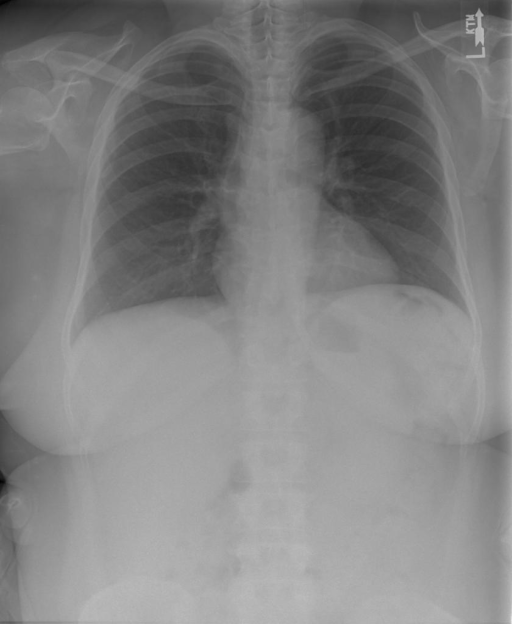

2

C:\Users\wangn\anaconda3\envs\pytorch\lib\site-packages\nltk\translate\bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\wangn\anaconda3\envs\pytorch\lib\site-packages\nltk\translate\bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\wangn\anaconda3\envs\pytorch\lib\site-packages\nltk\translate\bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram or

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： stable flattening the posterior diaphragm and scattered chronic appearing irregular interstitial markings with no focal alveolar consolidation   stable cardiomediastinal silhouette with normal heart size and aortic ectasiatortuosity stable mediastinal contours   no definite pleural effusion seen no typical findings pulmonary edema   following spine ossifications and marginal osteophytes again noted  


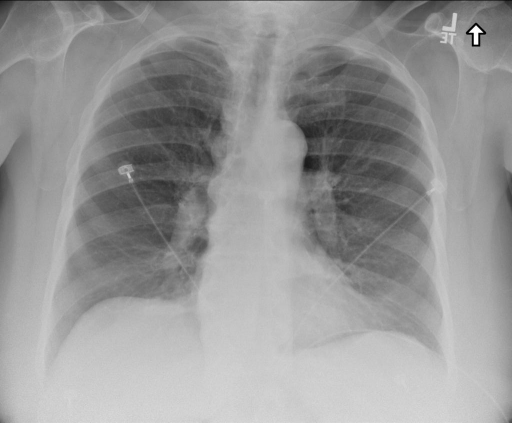

2

2it [00:01,  1.62it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs appear clear   the heart and pulmonary are normal   pleural spaces are clear   mediastinal contours are normal   patient status post sternotomy and cabg  


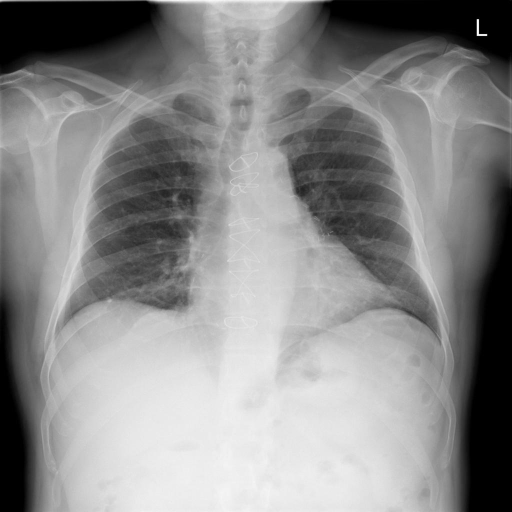

2

3it [00:01,  1.77it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart normal size   the mediastinum within normal limits   duallumen right catheter identified without pneumothora   the lungs are moderately hypoinflated with bibasilar opacities adjacent atelectasis   there illdefined density overlying the anterior left rib possibly healing deformity versus superimposition structures  


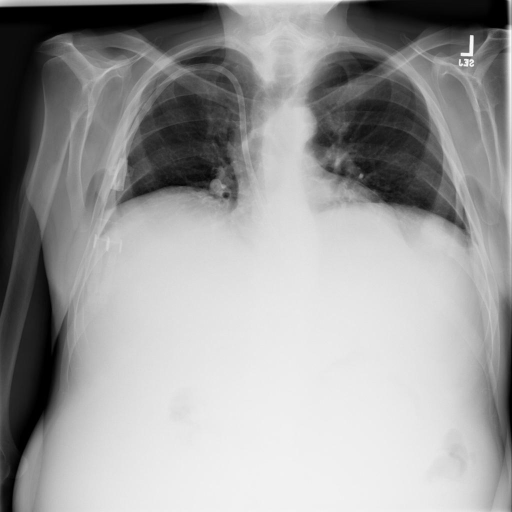

2

4it [00:02,  1.86it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： cardiac and mediastinal silhouette are unremarkable   lungs are clear   no focal consolidation pneumothora pleural effusion identified   and soft tissue are unremarkable  


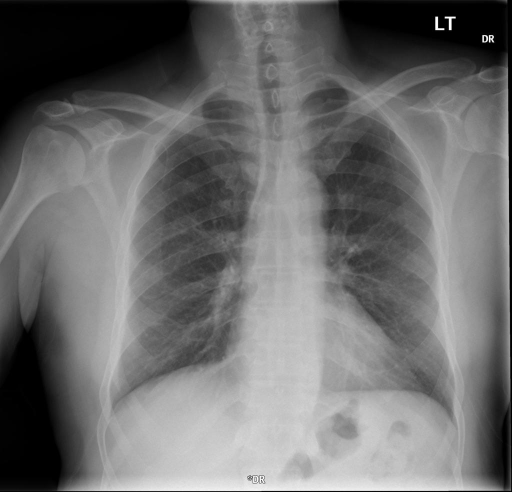

2

5it [00:02,  1.93it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs are clear   there no focal airspace consolidation   no pleural effusion pneumothora   heart size and mediastinal contour are within normal limits   there are multilevel degenerative changes the spine  


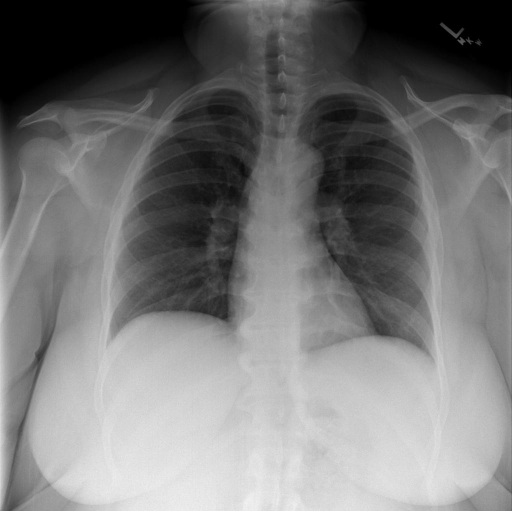

2

6it [00:03,  1.97it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size normal   right lung clear   granulomatous disease the bilateral   subsegmental atelectasis the left lower lung   no pneumothora   no pleural effusion  


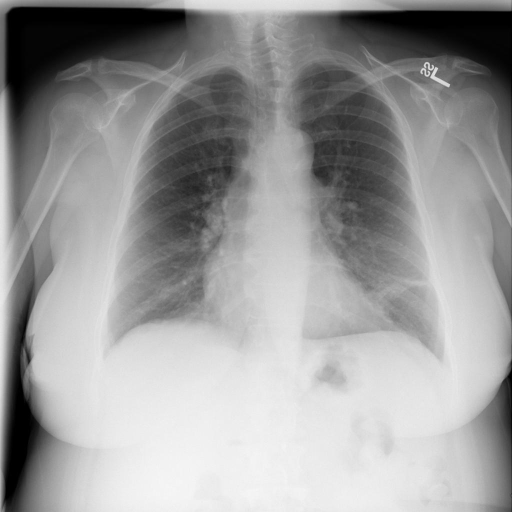

2

7it [00:03,  2.01it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart and lungs have the interval   both lungs are clear and epanded   heart and mediastinum normal  


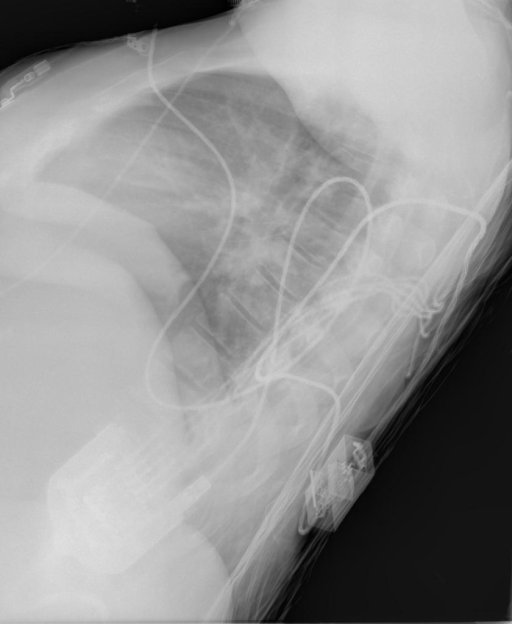

2

8it [00:04,  2.02it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size and pulmonary vascularity appear within normal limits   lungs are free focal airspace disease   no pleural effusion pneumothora seen  


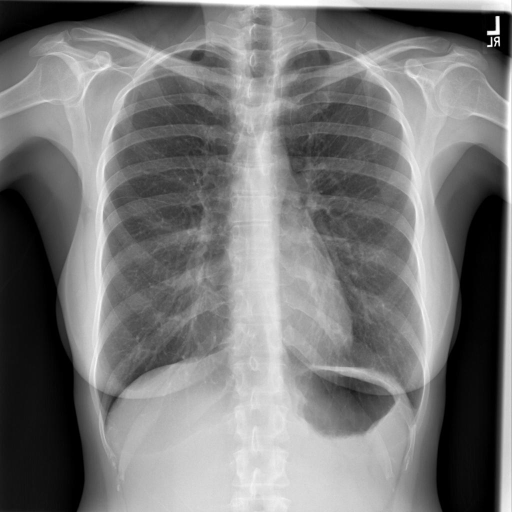

2

9it [00:04,  2.02it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： images   heart size upper limits normal   mediastinal contours are maintained   the patient mildly rotated   there small moderate sized right apical pneumothora which measures approimately cm   no focal airspace consolidation seen   left chest clear   no definite displaced bony injury seen   results called p  m  


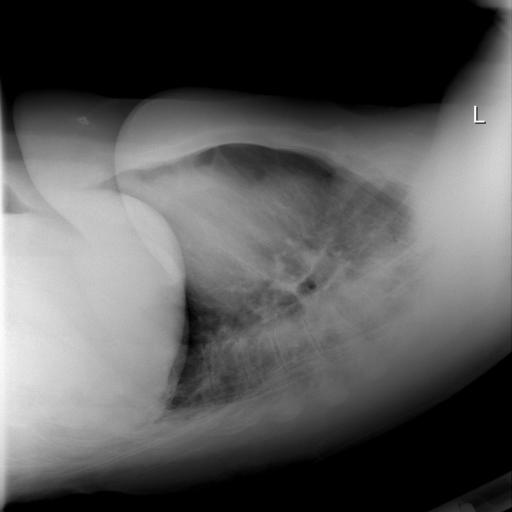

2

10it [00:05,  2.03it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size and pulmonary vascularity appear within normal limits   the lungs are free focal airspace disease   no pleural effusion pneumothora seen   vascular calcification noted  


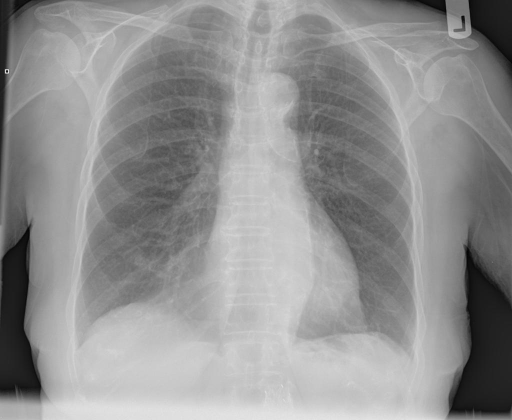

2

11it [00:05,  2.03it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size within normal limits stable mediastinal and hilar contours   no focal alveolar consolidation no definite pleural effusion seen   no typical findings pulmonary edema   no pneumothora   mild detrocurvature the spine again noted  


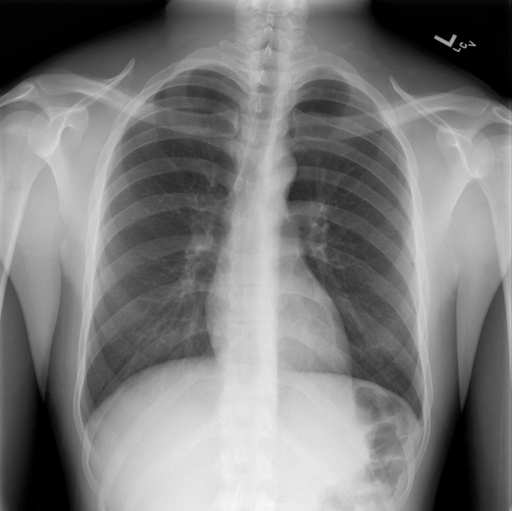

2

12it [00:06,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiac contours are normal   the lungs are clear   thoracic spondylosis  


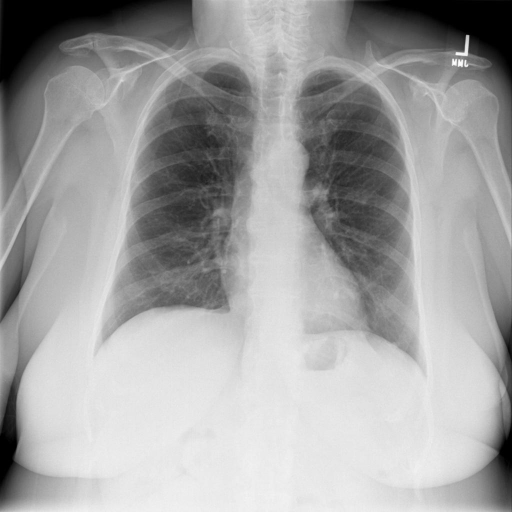

2

13it [00:06,  2.02it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size and mediastinal contours appear normal limits   no focal pulmonary opacity pleural effusion pneumothora   no acute bony abnormality   degenerative changes the spine  


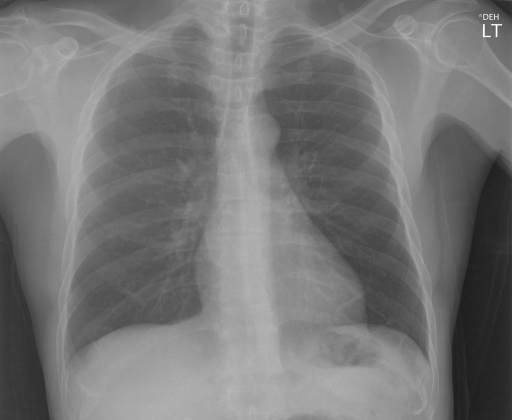

2

14it [00:07,  2.02it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： clear lungs   normal heart mediastinum   no pneumothora   no pleural effusion   no acute bony abnormality   nipple ring left  


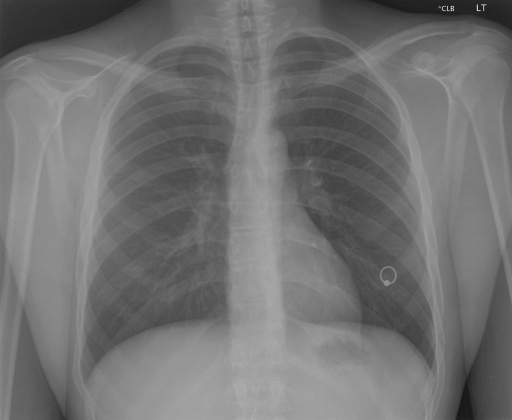

2

15it [00:07,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： there mild blunting the costophrenic there right basilar airspace disease   there no pneumothora   the cardiac mediastinal silhouettes are normal   pulmonary are slightly prominent   calcified hilar lymph no acute bony abnormalities  


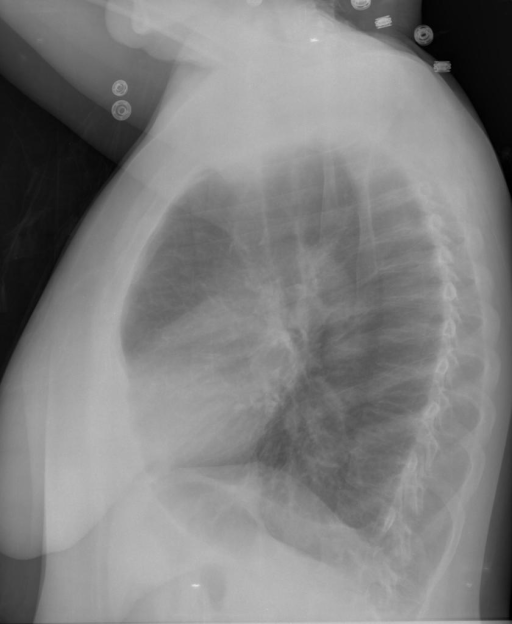

2

16it [00:08,  1.96it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： cardiomediastinal size and contour grossly normal for technique   there calcified granuloma the right lower lobe   the lungs are mildly hypoinflated but grossly clear focal airspace disease pneumothora pleural effusion   no acute displaced fractures are demonstrated  


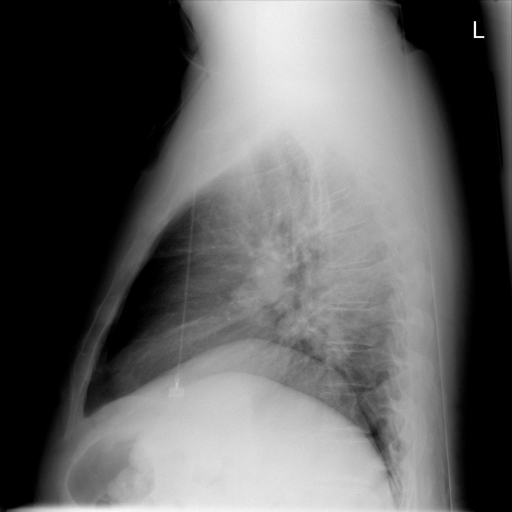

2

17it [00:08,  1.99it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart size normal   mediastinal contours are within normal limits   postsurgical changes left hemithora are stable   skin have been removed since prior study study   the left apical pneumothora has resolved   there are mild chronic opacities the left lung base with probable small residual effusion   the right lung grossly clear  


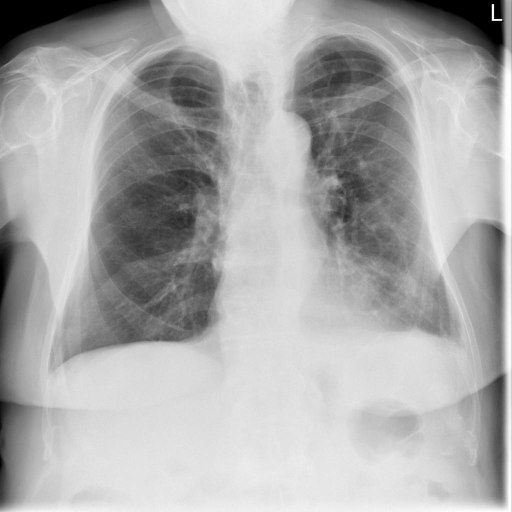

2

18it [00:09,  1.99it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the eamination consists frontal and lateral radiographs the chest   the cardiomediastinal contours are within normal limits   pulmonary vascularity within normal limits   no focal consolidation pleural effusion pneumothora identified   deformity the right clavicle related remote again seen   visualized upper abdomen grossly unremarkable  


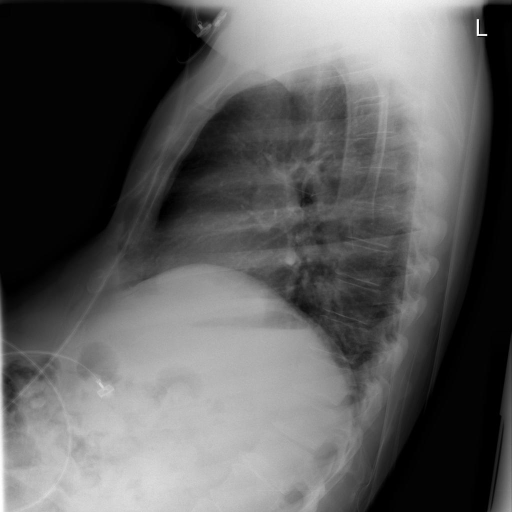

2

19it [00:09,  1.99it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： rotated eamination   tortuous aorta   moderate rightsided pleural effusion small left sided   no pneumothora   mied nodular interstitial opacities distributed through bilateral lungs right greater than left   cardiomediastinal silhouette mildly enlarged   obliquely oriented left humeral neck fracture transverse with displacement the distal fragment   limited evaluation the aorto iliac stent   no cavitary lesion suggest   active tuberculosis   large hiatal hernia  


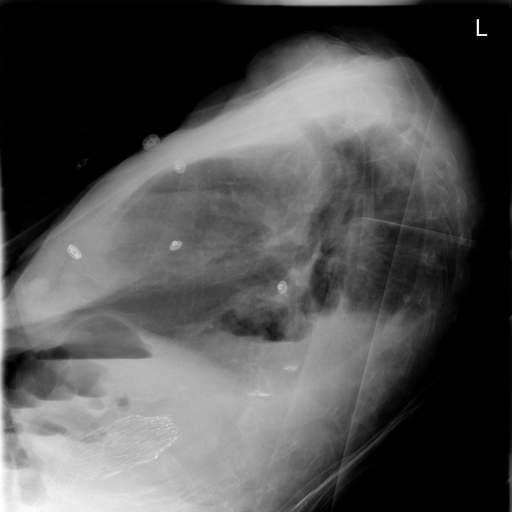

2

20it [00:10,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size within normal limits   there are surgical clips the left mediastinum   there no pneumothora   there small left pleural effusion   abnormal conveity within the mediastinum represents adenopathy which better demonstrated the prior


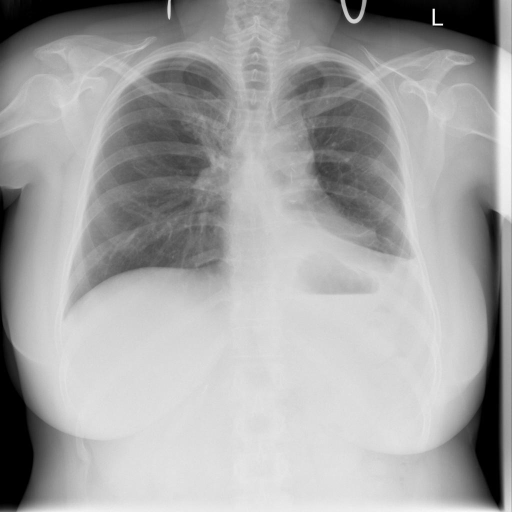

2

21it [00:10,  2.01it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size normal   no pneumothora   no large pleural effusions   no focal airspace opacities  


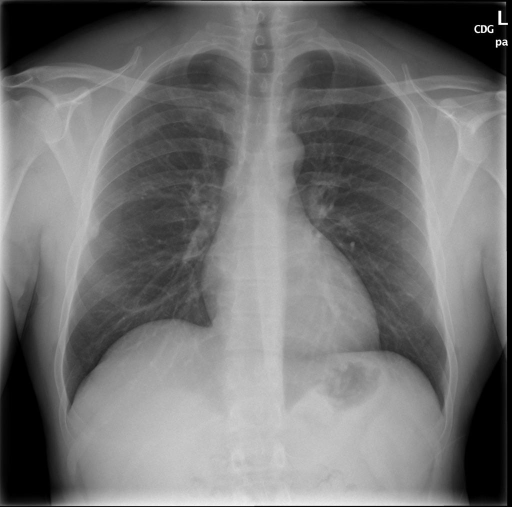

2

22it [00:11,  2.01it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size and vascularity normal   lungs clear   no effusions pneumothora   limited degenerative change the spine


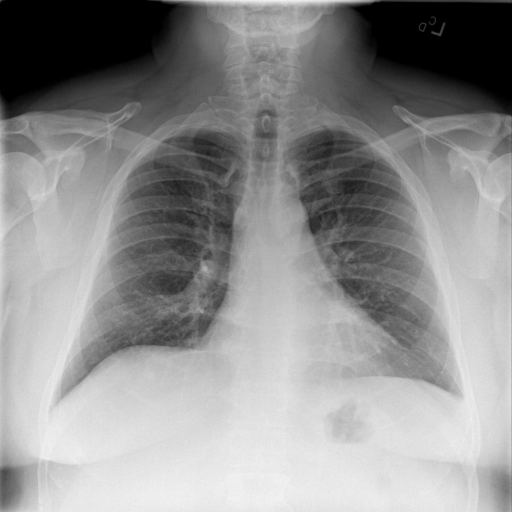

2

23it [00:11,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： lungs are clear   heart size normal   the are unremarkable  


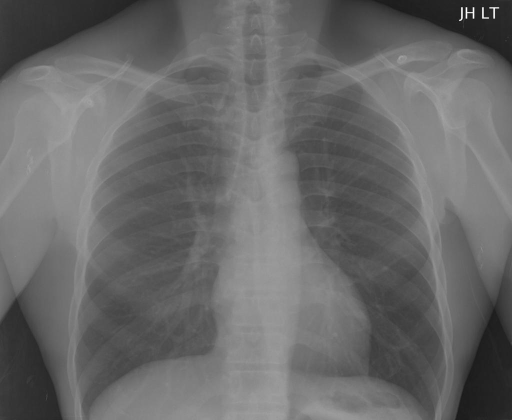

2

24it [00:12,  2.03it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： normal heart size and mediastinal contours   the lungs are hyperinflated but clear   no pneumothora pleural effusion   no acute bony abnormalities  


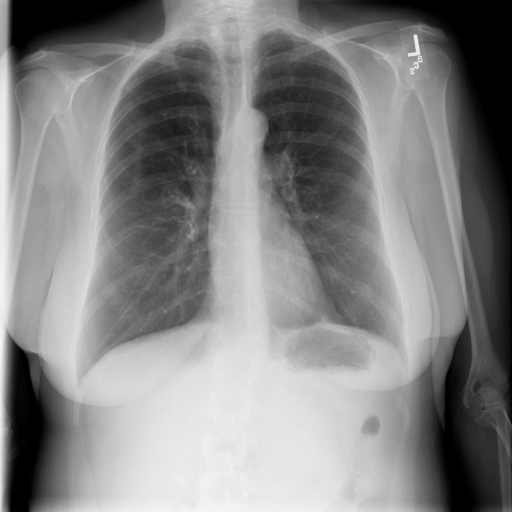

2

25it [00:12,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart the upper limits normal size   lungs are clear without focal infiltrates   no pneumothora pleural effusion   normal pulmonary vascularity  


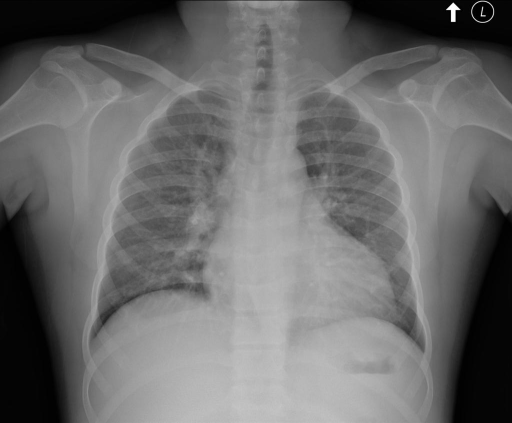

2

26it [00:13,  2.03it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs are clear   the heart and pulmonary are normal   the pleural spaces are clear   mediastinal contours are normal  


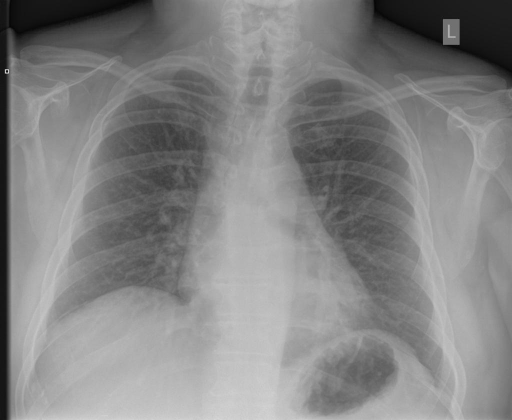

2

27it [00:13,  2.04it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size within normal limits   tortuous aorta   low lung volumes with no focal consolidations   no pneumothora effusion   moderate degenerative disc disease the midthoracic spine  


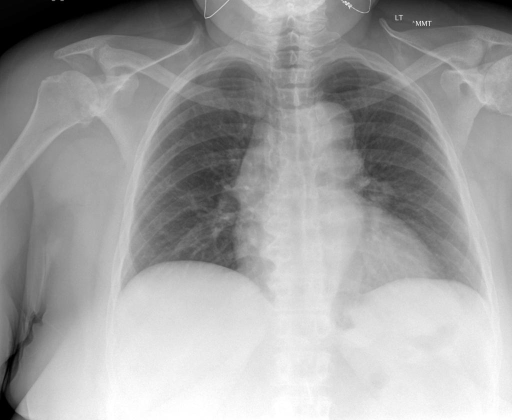

2

28it [00:14,  2.05it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： chest   both lungs are clear and epanded with no pleural air collections parenchymal consolidations   heart and mediastinum remain normal   lumbosacral spine   disc spaces and alignment are normal   sacrum and sacroiliac joints are normal  


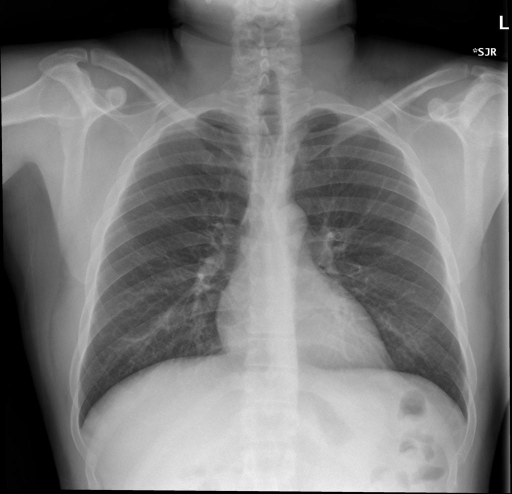

2

29it [00:14,  2.05it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： no focal consolidation suspicious pulmonary opacity definite pleural effusion   heart size and pulmonary vascularity within normal limits   stable mediastinal contour   calcified hilar lymph visualized osseous structures unremarkable  


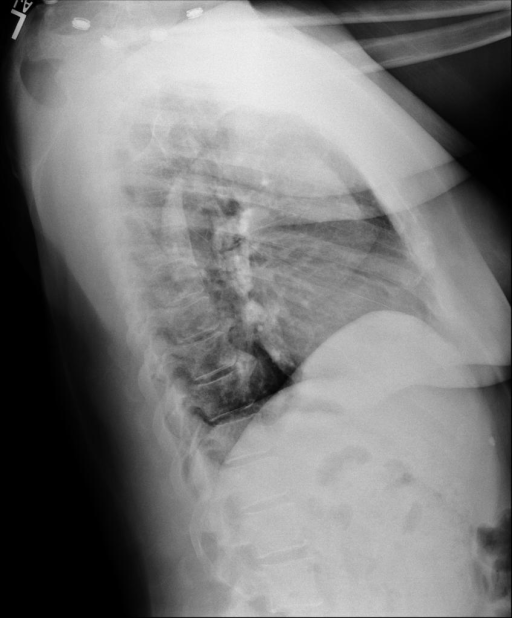

2

30it [00:15,  2.02it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： spinal stimulator lungs are clear without focal airspace disease   no pleural effusions pneumothoraces   heart and mediastinum normal size and contour   degenerative changes the thoracic spine  


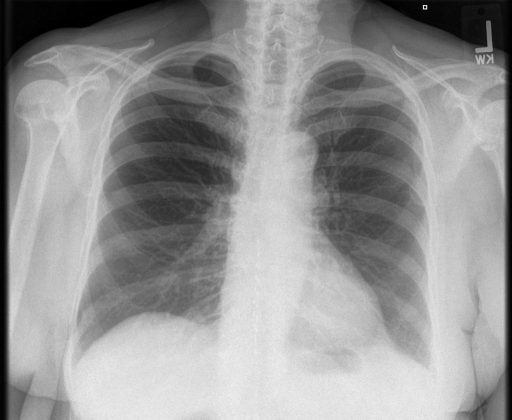

2

31it [00:15,  2.03it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart mediastinum bony structures and lung are unremarkable  


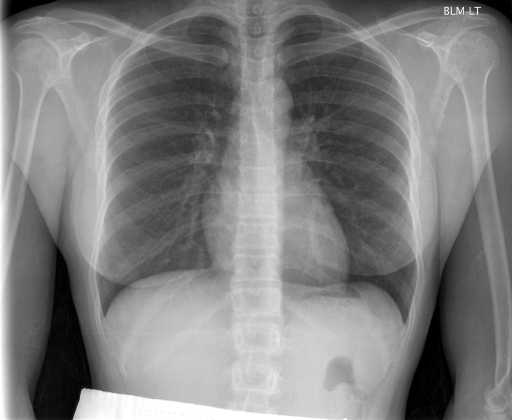

2

32it [00:16,  2.03it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： lungs are clear bilaterally with no focal infiltrate pleural effusion pneumothoraces   cardiomediastinal silhouette within normal limits   no acute bony soft tissue abnormality  


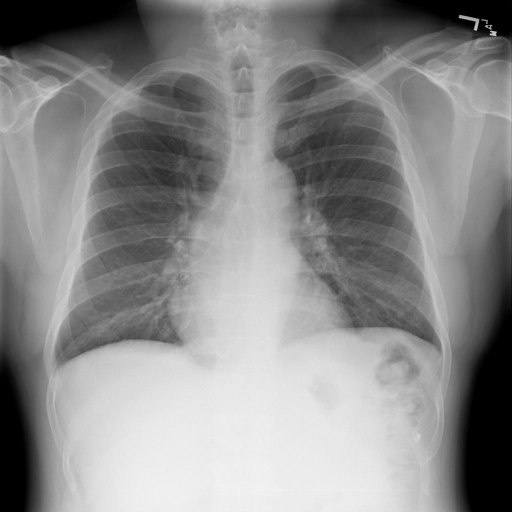

2

33it [00:16,  2.02it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： lungs are clear bilaterally with no focal infiltrate pleural effusion pneumothoraces   cardiomediastinal silhouette within normal limits   no acute bony soft tissue abnormality  


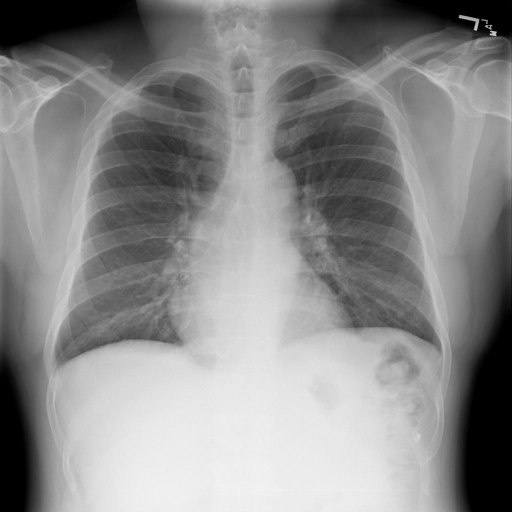

2

34it [00:17,  2.03it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： lungs are clear bilaterally with no focal infiltrate pleural effusion pneumothoraces   cardiomediastinal silhouette within normal limits   no acute bony soft tissue abnormality  


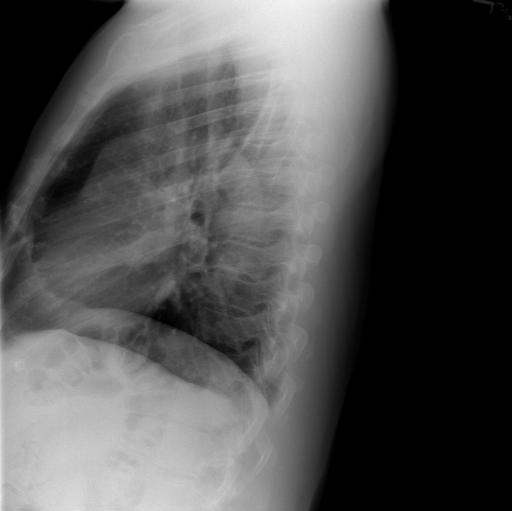

2

35it [00:17,  2.02it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart and mediastinal contours are unremarkable   the pulmonary vasculature normal appearance   the lung parenchyma clear without focal infiltrate   there are no pleural effusions and there no pneumothora   the visualized bony structures are grossly unremarkable   no displaced rib fractures   right nipple ring noted  


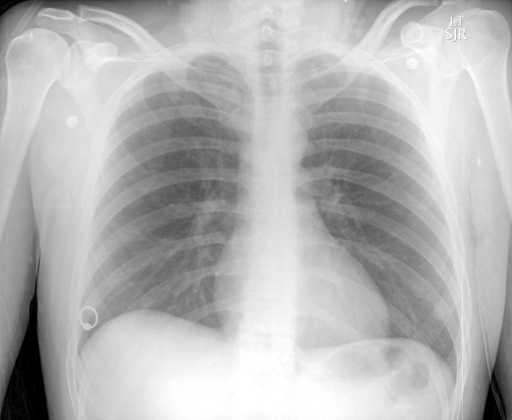

2

36it [00:18,  1.95it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart mildly enlarged   the aorta atherosclerotic and ectatic   chronic parenchymal changes are noted with mild scarring andor subsegmental atelectasis the right lung base   no focal consolidation significant pleural effusion identified   costophrenic are blunted  


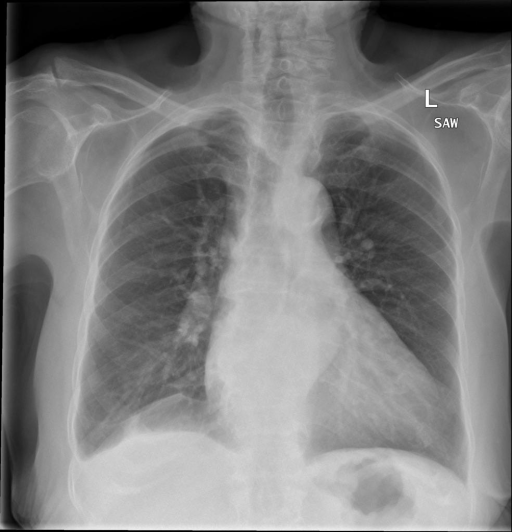

2

37it [00:18,  1.93it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： there has been interval removal rightsided central venous catheter   enteric tube again noted coursing below the diaphragm the tip which seen projecting over the epected location the body the stomach   the cardiomediastinal silhouette normal unchanged from prior   low lung volumes causing streaky bibasilar atelectasis and bronchovascular crowding   there no pneumothora   the visualized bony structures reveal no acute abnormalities   lateral view reveals mild degenerative changes the thoracic spine  


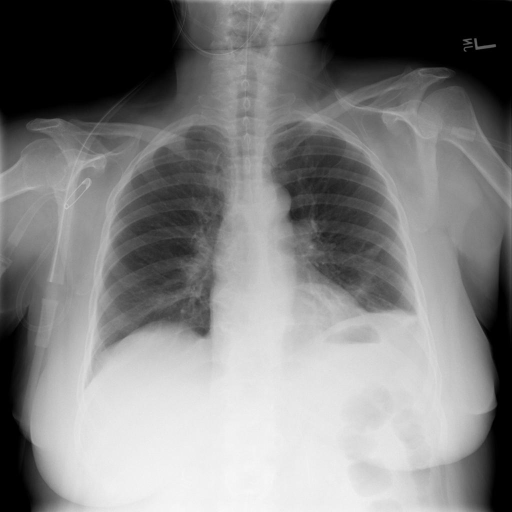

2

38it [00:19,  1.95it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size and mediastinal contours appear within normal limits   pulmonary vascularity within normal limits   no focal consolidation suspicious pulmonary opacity pneumothora definite pleural effusion   visualized osseous structures appear intact  


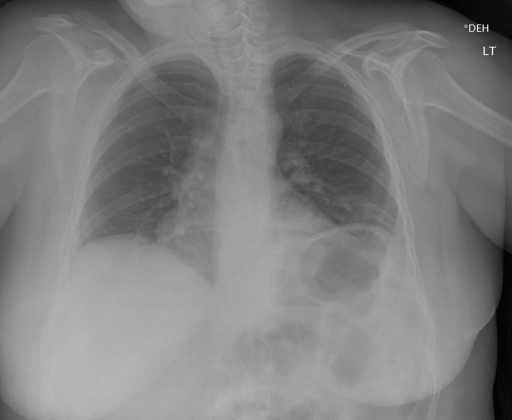

2

39it [00:19,  1.96it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： cardiomegaly present   the upper lobe pulmonary vascularity appears mildly prominent consistent with pulmonary venous hypertension   the lungs are free focal airspace disease   no pleural effusion pneumothora seen   there eventration the right hemidiaphragm   bony changes renal osteodystrophy are noted  


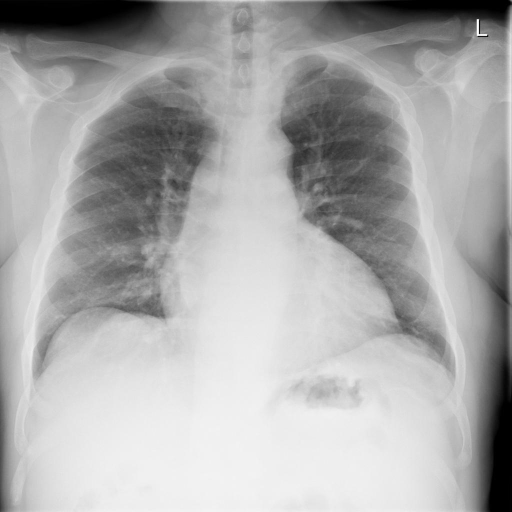

2

40it [00:20,  1.98it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： there are low volumes with bronchovascular crowding   no focal infiltrate effusion   heart and mediastinal contours within normal limits   no displaced fracture identified  


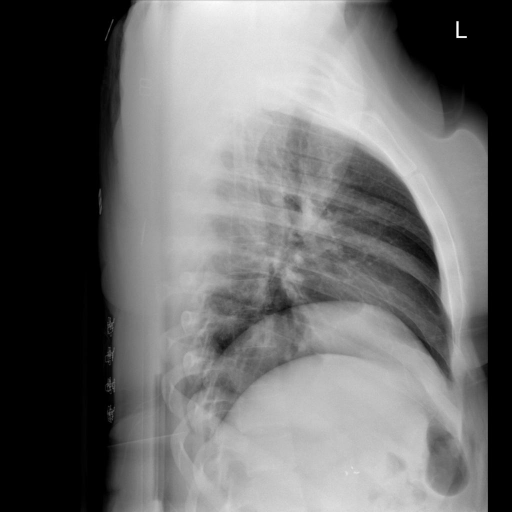

2

41it [00:20,  1.99it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart top normal size   the mediastinum stable   the aorta atherosclerotic   there are mild chronic changes without focal consolidation   no pleural effusion seen  


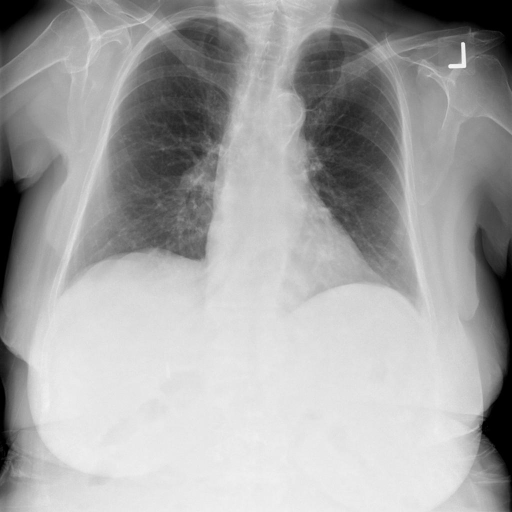

2

42it [00:21,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： and lateral chest eamination was obtained   the heart silhouette normal size and contour   there are calcified mediastinal perihilar pulmonary nodules consistent with sequela old granulomatous infection   no acute lung infiltrates   aortic appear unremarkable   there no effusion pneumothora  


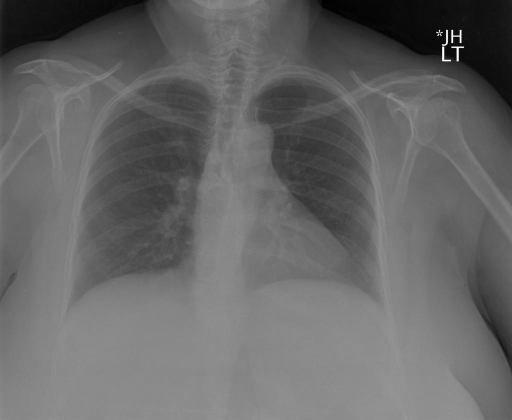

2

43it [00:21,  2.01it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： there are low lung volumes   there bronchovascular crowding   heart and mediastinal contours within normal limits   no focal infiltrate effusion   no pneumothora   visualized osseous structures intact  


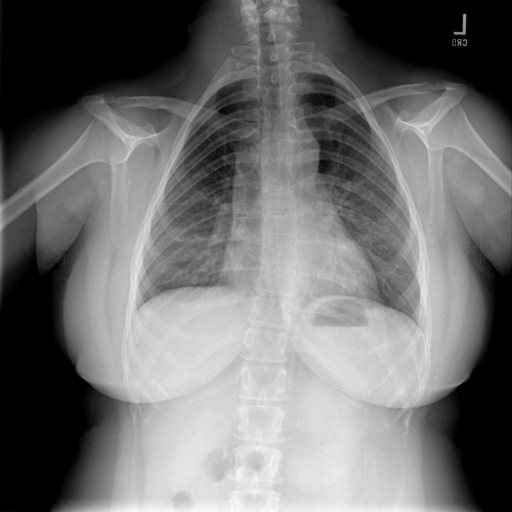

2

44it [00:22,  2.01it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiac contours are normal   cardiac valve replacement   the lungs are clear   thoracic spondylosis  


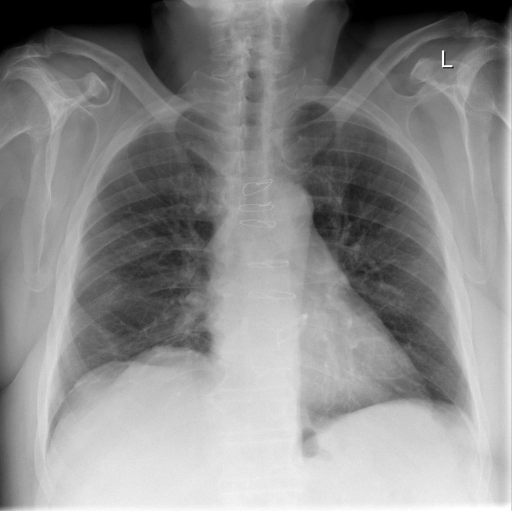

2

45it [00:22,  1.97it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs are clear   heart size normal   no pneumothora  


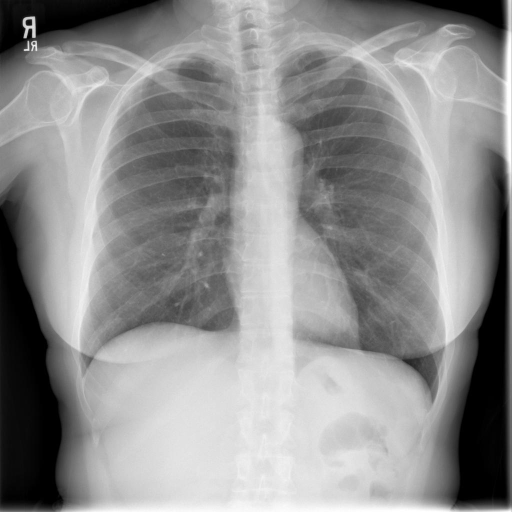

2

46it [00:23,  1.91it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： picc line catheter tip the right atrium   heart not enlarged   trachea and bronchi appear normal   lungs are mildly under epanded   no pneumothora   there are small areas patchy density the left lower lung there larger area patchy density the right mid and lower lungs with rightsided pleural effusion  


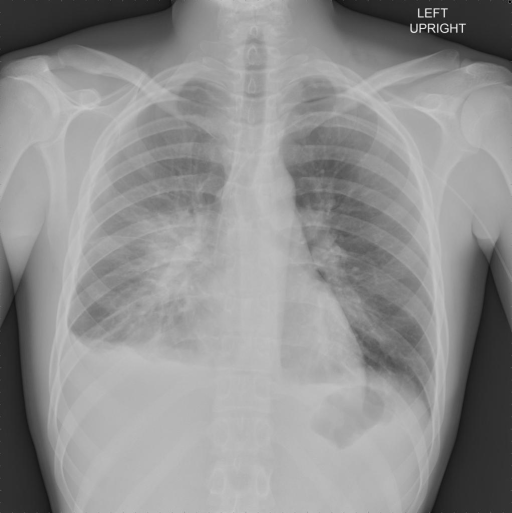

2

47it [00:23,  1.92it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： sternotomy are intact and unchanged position from prior eam   lungs are clear bilaterally with no focal infiltrate pleural effusion pneumothoraces   cardiomediastinal silhouette within normal limits   and soft tissues are unremarkable  


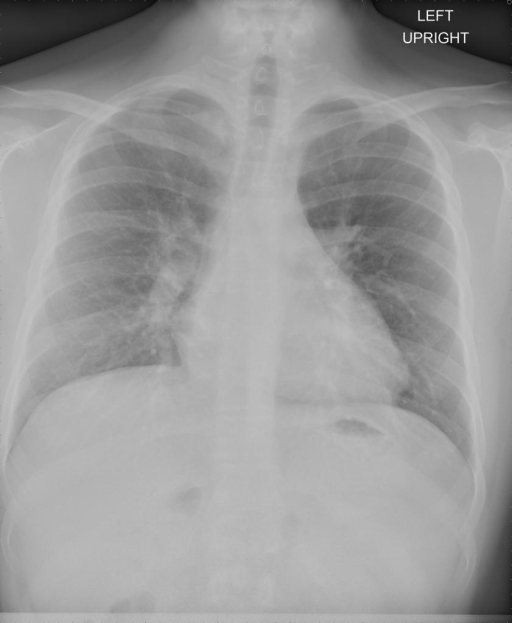

2

48it [00:24,  1.91it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： images   small centrally calcified granuloma within the lateral right lung base   otherwise the lungs are clear   heart size normal   no evidence for pleural effusion pneumothora  


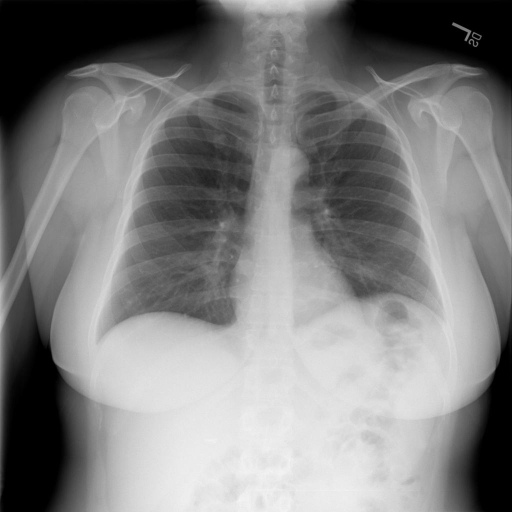

2

49it [00:24,  1.90it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size and pulmonary vascularity appear within normal limits   right picc line the tip has moved into the left innominate vein   there has been interval development several illdefined focal opacities the left and right mid lung zones   no pneumothora pleural effusion seen  


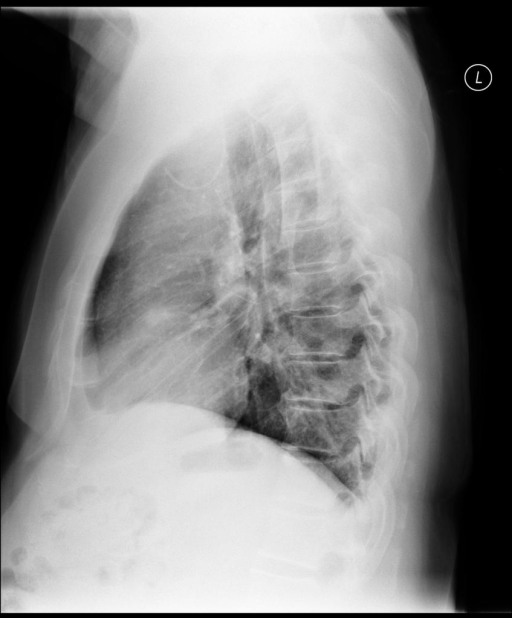

2

50it [00:25,  1.91it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs appear clear   the heart and pulmonary are normal   the pleural spaces are clear   surgical clips and suture material are noted the right hilar region suggesting prior lung surgery   the mediastinal contours are stable  


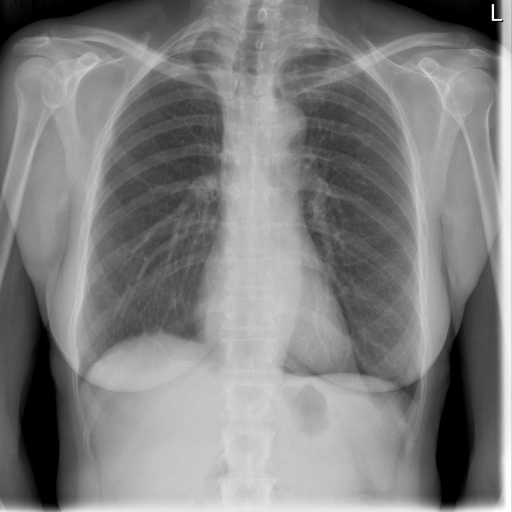

2

51it [00:25,  1.95it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart normal size and contour   there no mediastinal widening   the lungs are clear bilaterally   no large pleural effusion pneumothora   the are intact  


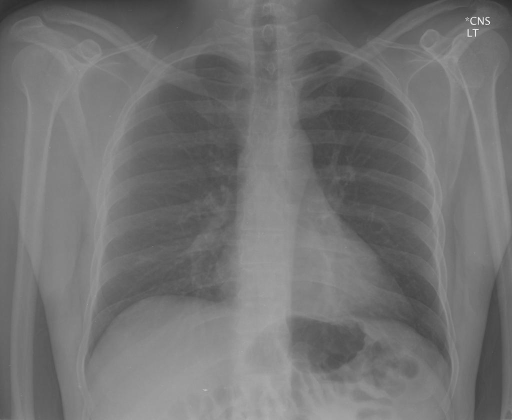

2

52it [00:26,  1.97it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the trachea midline   the cardiomediastinal silhouette normal and unchanged compared prior eamination   tubular densities overlying the heart are coronary artery stents   there are small round calcific densities the bilateral lobes which are unchanged from prior eam and represent sequelae from old granulomatous disease   otherwise lungs are clear without evidence acute infiltrate effusion   there no pneumothora   the visualized bony structures reveal no acute abnormalities   lateral view reveals mild degenerative changes the thoracic spine  


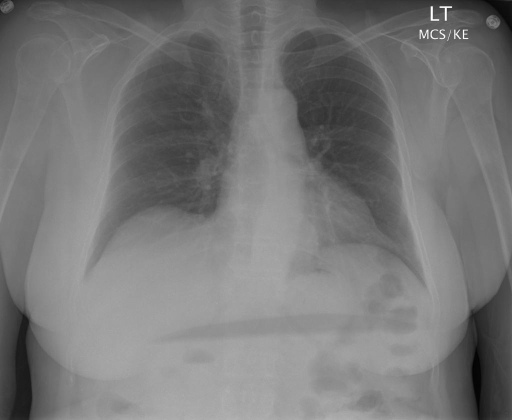

2

53it [00:26,  1.98it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： cardiomegaly with unfolded aorta   there no pulmonary edema   there no focal consolidation   there are no large pleural effusion   there no evidence pneumothora  


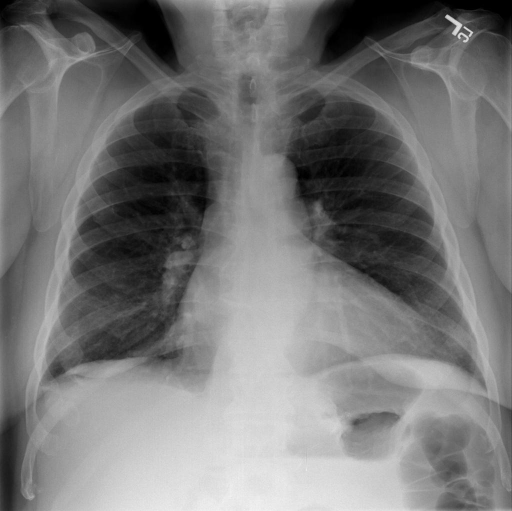

2

54it [00:27,  1.98it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiac silhouette the upper limits normal for size   there are low lung volumes with bronchovascular crowding   no focal areas pulmonary consolidation   no pneumothora   no pleural effusion   minimal degenerative endplate changes the thoracic spine  


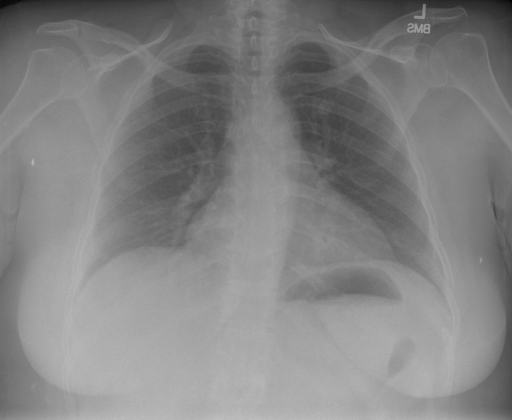

2

55it [00:27,  1.99it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： kub   centered over the mid abdomen there are multiple airfilled dilated loops small bowel measuring the which measure about diameter   there also etremely dilated the same region which measures diameter   there etensive soft tissue pannus   prior abdominal surgery   chest   there left basilar opacity   no visualized pneumothora   the heart size normal   there mild elevation the left hemidiaphragm   there are no large pleural effusions   there thickening the fissure  


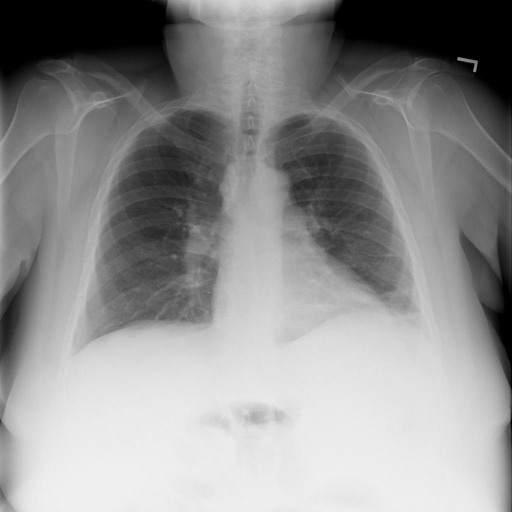

2

56it [00:28,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： three noncalcified lung nodules are present the left lower lobe   the largest measures diameter   another nodule present near the right hilum   approimately diameter   the and mediastinum appear normal   heart size normal  


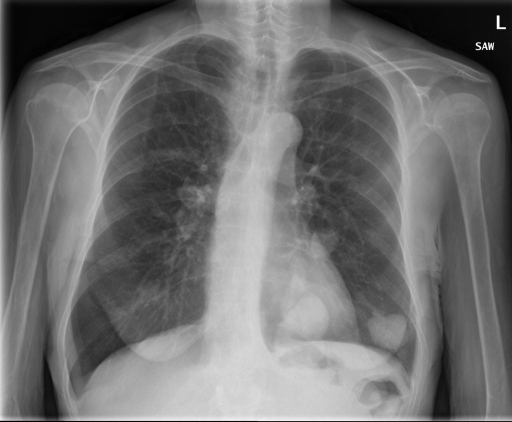

2

57it [00:28,  2.01it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart normal size and contour   the lungs are clear without evidence infiltrate   there no pneumothora effusion  


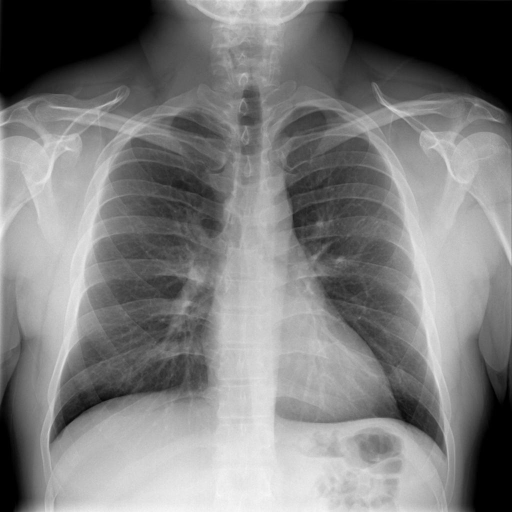

2

58it [00:29,  2.01it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： mediastinal contours are normal   lungs are clear   there no pneumothora large pleural effusion  


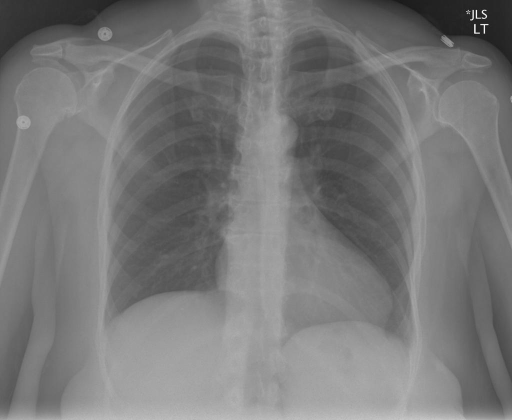

2

59it [00:29,  2.03it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart and cardiomediastinal silhouette are stable size and contour   there no focal airspace opacity pleural effusion pneumothora   the osseous structures are intact  


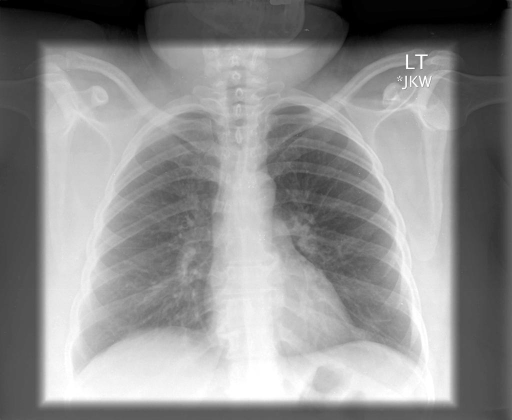

2

60it [00:30,  2.01it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs are clear   there are calcified granulomas   heart size normal   no pneumothora   there are endplate changes the spine  


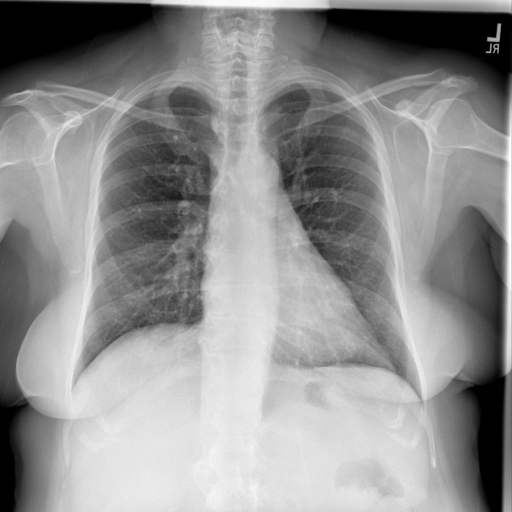

2

61it [00:30,  1.99it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： cardiomediastinal silhouettes are within normal limits   lungs are without focal consolidation pneumothora pleural effusion   grossly unchanged appearance calcified hilar lymph and scattered calcified granulomas   stable degenerative changes the spine  


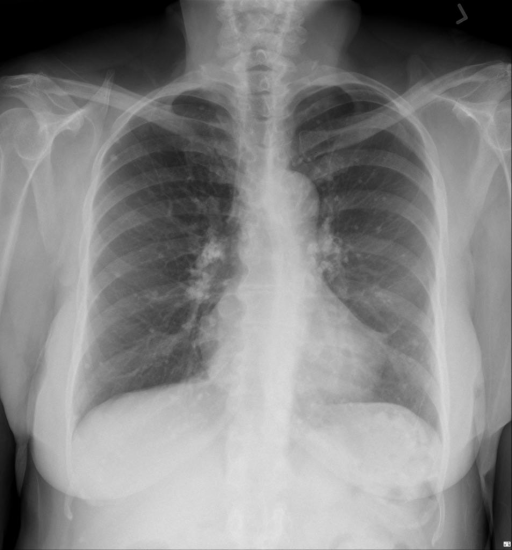

2

62it [00:31,  1.99it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiac silhouette and pulmonary vascularity are normal   the lungs are clear   there no evidence pleural effusion   postoperative changes are noted the mediastinum and lower cervical spine  


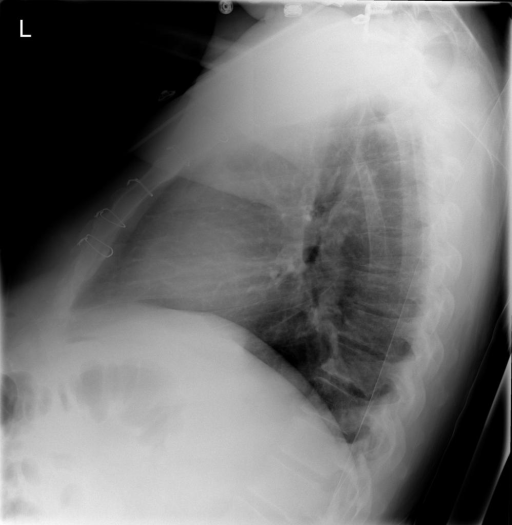

2

63it [00:31,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： there persistent mild elevation right hemidiaphragm   there suggestion subtle patchy opacities lower lung bilaterally   this similar scan   the heart normal   the aorta calcified and tortuous   the skeletal structures show scoliosis and arthritic changes  


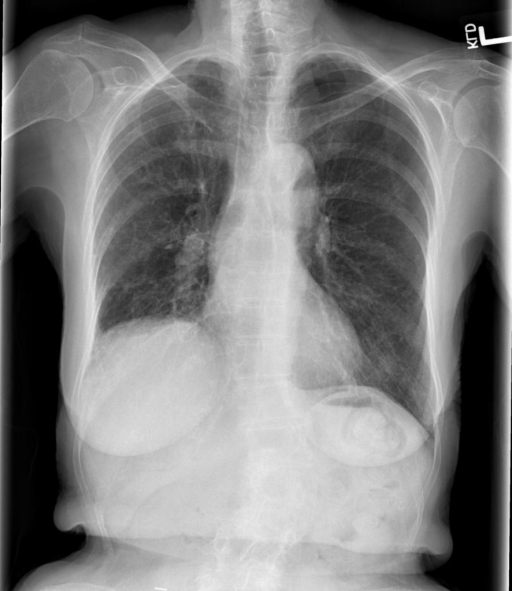

2

64it [00:32,  1.94it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： this study limited secondary patient body habitus   the lungs are clear   there no pleural effusion pneumothora   the heart and mediastinum are normal   the skeletal structures are normal  


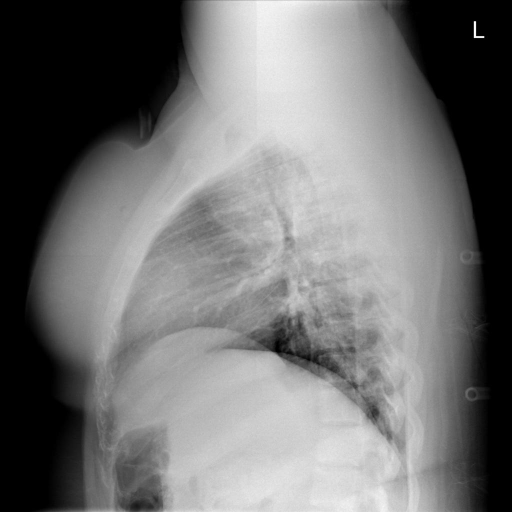

2

65it [00:32,  1.94it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： there obscuration the left hemidiaphragm suggesting left retrocardiac airspace disease   this not identified the lateral view which limited rotation   no evidence for effusion  


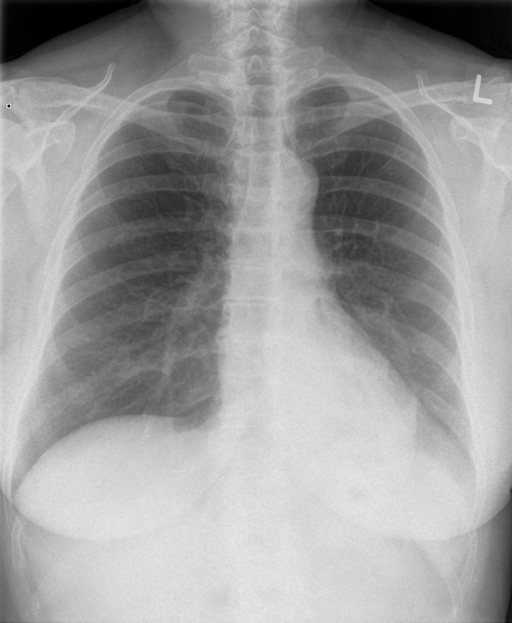

2

66it [00:33,  1.89it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiomediastinal silhouette normal size and contour   no focal consolidation pneumothora large pleural effusion   tspine osteophytes  


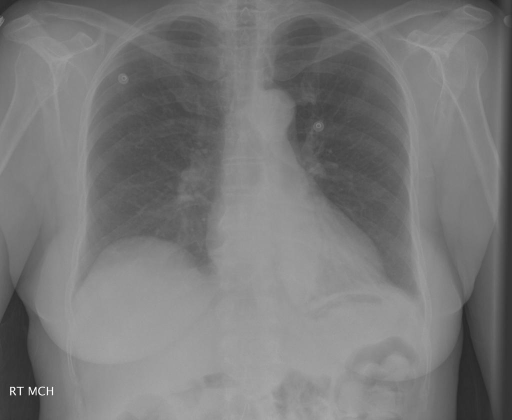

2

67it [00:33,  1.91it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： stable enlargement the cardiac silhouette stable mediastinal contours   increased interstitial markings the central lungs and bases right greater than left   opacity the lateral view over the heart also present the previous eam suggesting chronic subsegmental atelectasis scarring   no definite pleural effusion seen  


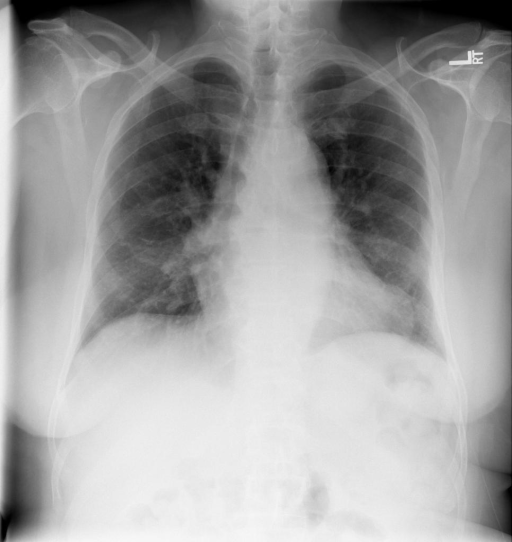

2

68it [00:34,  1.87it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiac contours are normal   basilar atelectasis   the lungs are clear   thoracic spondylosis   lower cervical arthritis  


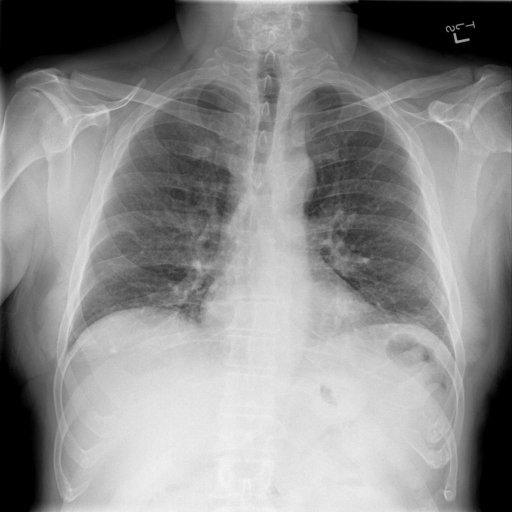

2

69it [00:35,  1.87it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： sequelae old granulomatous disease   lungs are clear without focal airspace disease   no pleural effusions pneumothoraces   heart and mediastinum normal size and contour  


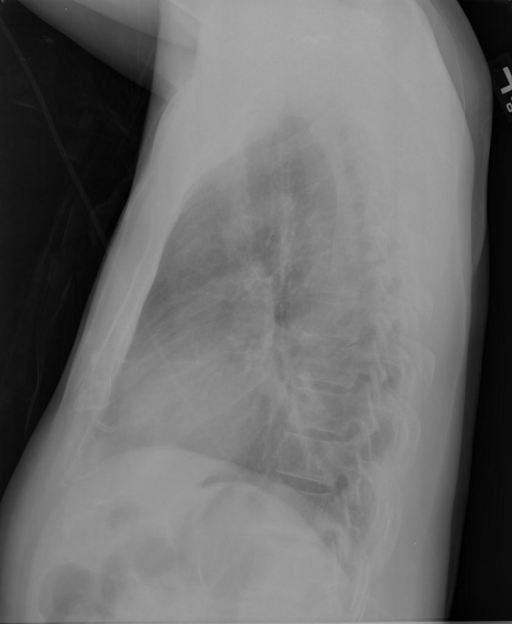

2

70it [00:35,  1.90it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart normal size and contour   there calcified granuloma the right lower lung   the lungs are clear without evidence infiltrate   there no pneumothora effusion   osteopenia with mild degenerative changes the thoracic spine noted  


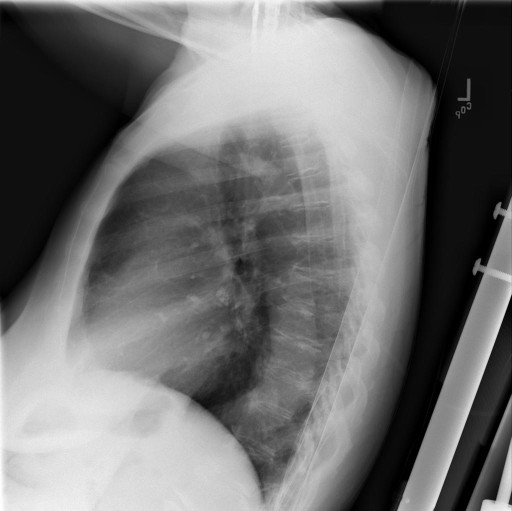

2

71it [00:36,  1.94it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： there are postsurgical and postradiation changes the left lung with spiculated hyperdense scar the left upper thora   there loss lung volume the left due postsurgical change   deviation towards the left   right lung hyperepanded   the right lung clear   heart size and vascularity within normal limits  


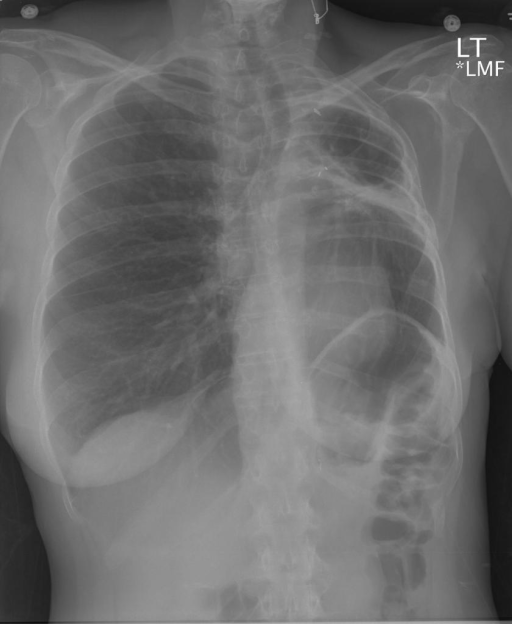

2

72it [00:36,  1.93it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the left lung grossly clear   the right lung demonstrates large right pleural effusion with associated atelectatic collapse the right middle lobe and partial collapse the right lower lobe   opacities are seen within the aerated right lung subsegmental atelectasis   no focal consolidation pneumothora identified   no acute osseous abnormality   cardio mediastinal silhouette stable compared prior eaminations  


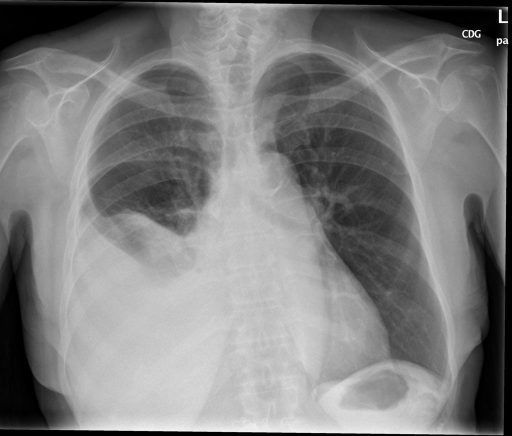

2

73it [00:37,  1.94it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiomediastinal silhouette normal size and contour   no focal consolidation pneumothora large pleural effusion   negative for acute bone abnormality  


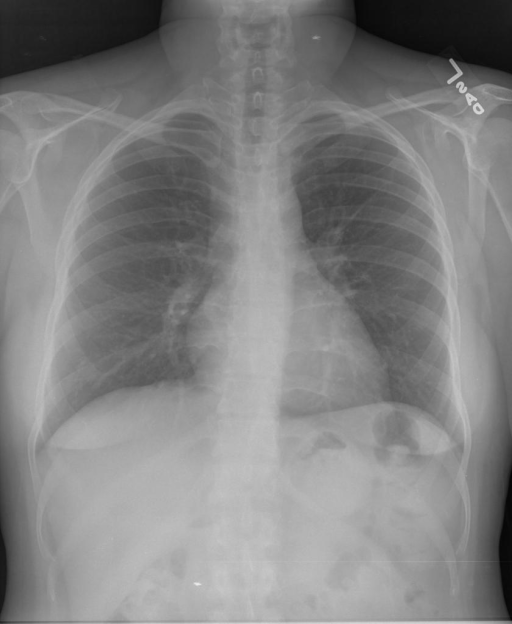

2

74it [00:37,  1.93it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： stable cardiomediastinal silhouette with normal heart size and aortic ectasiatortuosity   no focal alveolar consolidation no definite pleural effusion seen   mild bronchovascular crowding without typical findings pulmonary edema   distal clavicle shortening also present the previous eam possibly posttraumatic postsurgical  


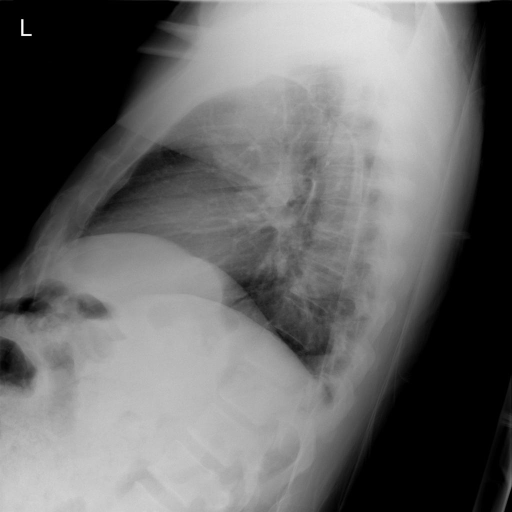

2

75it [00:38,  1.92it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size normal   lungs are clear   are normal   no pneumonia effusions edema pneumothora adenopathy nodules masses  


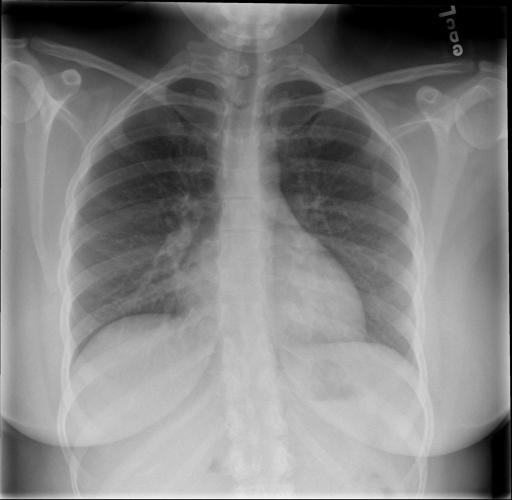

2

76it [00:38,  1.92it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： no pleural effusion pneumothora focal airspace opacities   cardiomediastinal silhouette within normal limits   the trachea midline   no free subdiaphragmatic air   the included osseous structures are grossly intact  


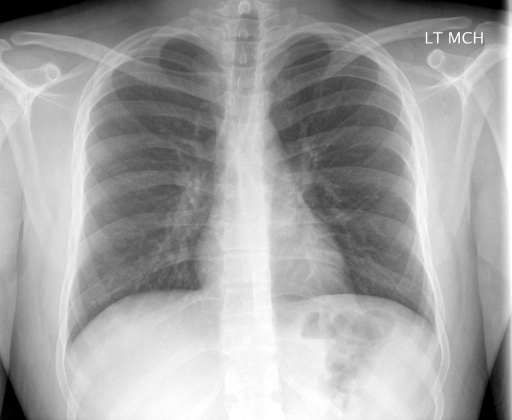

2

77it [00:39,  1.93it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size normal   the lungs are clear   there are no focal air space consolidations   no pleural effusions pneumothoraces   aortic vascular calcifications   normal pulmonary vascularity   fracturedislocation the right shoulder   bone demineralization   scoliosis which possibly positional  


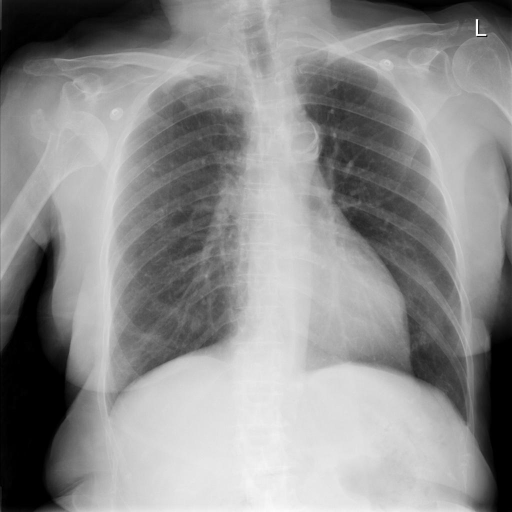

2

78it [00:39,  1.91it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart upper limits normal size   the lungs are clear without evidence infiltrate   there no pneumothora effusion  


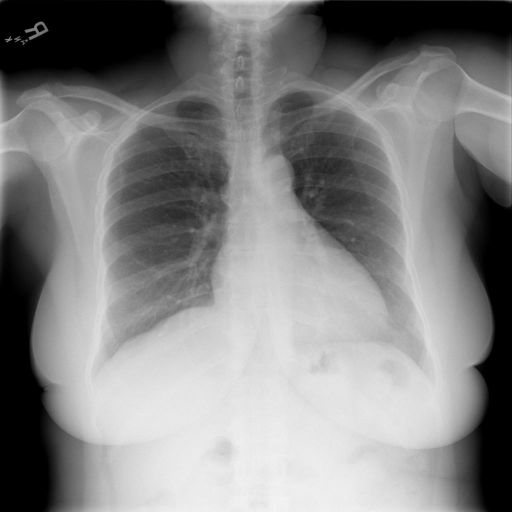

2

79it [00:40,  1.92it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： stable normal cardiac size and contour with unremarkable mediastinal silhouette   normal pulmonary no active airspace diseaseinfiltrate   no pleural effusion pneumothora   calcified granuloma right upper lobe  


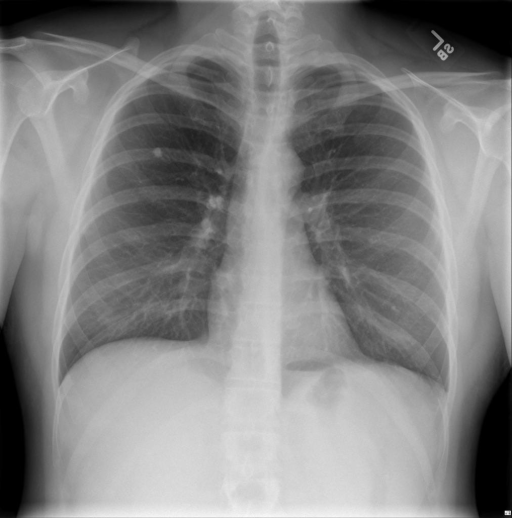

2

80it [00:40,  1.92it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： calcified granulomas are noted within the lung bases and stable compared with prior study   the cardiac silhouette and mediastinal contours are within normal limits   there no pneumothora   there no focal opacity   no large pleural effusion   minimal retrolisthesis two lower thoracic vertebral bodies  


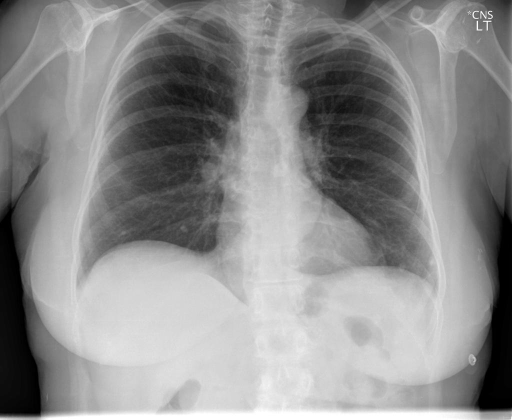

2

81it [00:41,  1.96it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs are mildly hyperepanded   there no focal airspace consolidation suggest pneumonia   no pleural effusion pneumothora   normal heart size and mediastinal contour  


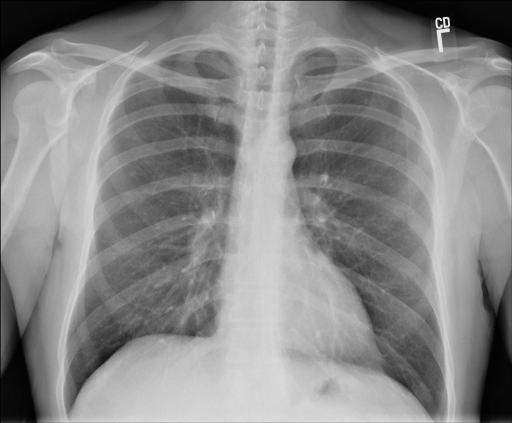

2

82it [00:41,  1.96it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs are mildly hyperepanded   there no focal airspace consolidation suggest pneumonia   no pleural effusion pneumothora   normal heart size and mediastinal contour  


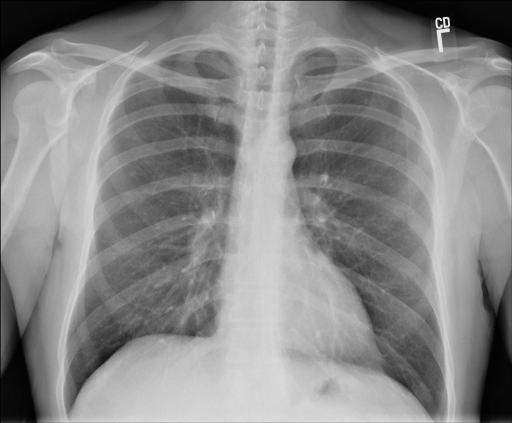

2

83it [00:42,  1.96it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs are mildly hyperepanded   there no focal airspace consolidation suggest pneumonia   no pleural effusion pneumothora   normal heart size and mediastinal contour  


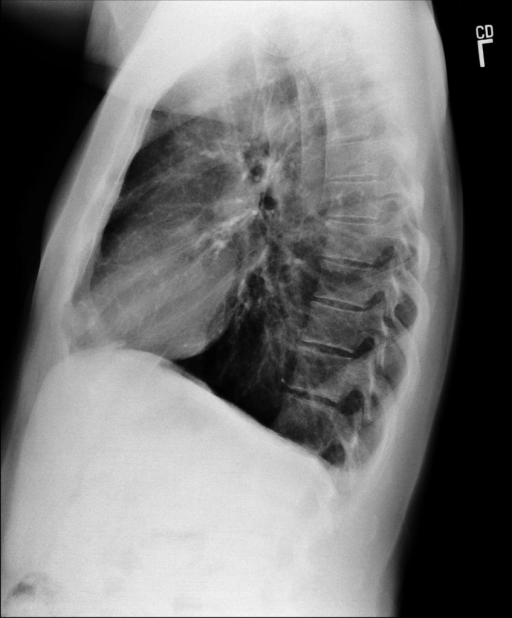

2

84it [00:42,  1.93it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： central venous catheter tip the right atrium   heart size and shape are normal   trachea and bronchi appear normal   the lungs are reasonably well epanded   there and patchy nodular densities both lower lung more marked the right than the left   there scattered areas bronchial wall thickening wellseen the left upper lobe   there loss definition part the left heart no effusions no pneumothora  


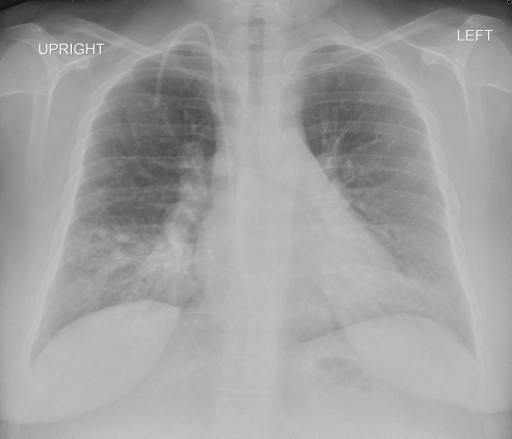

2

85it [00:43,  1.96it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： stable scarring near the right lung ape along the lateral aspect   lungs are otherwise clear   no pleural effusions pneumothoraces   heart and mediastinum normal size and contour   degenerative changes the spine  


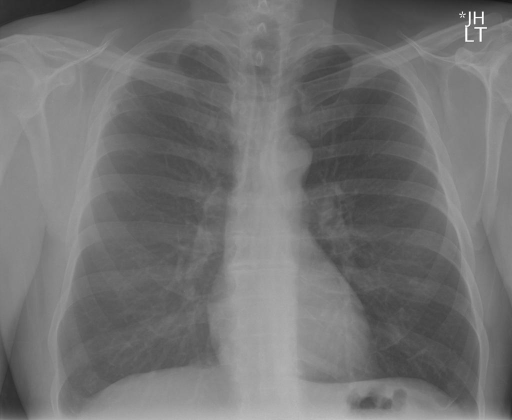

2

86it [00:43,  1.95it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： stable scarring near the right lung ape along the lateral aspect   lungs are otherwise clear   no pleural effusions pneumothoraces   heart and mediastinum normal size and contour   degenerative changes the spine  


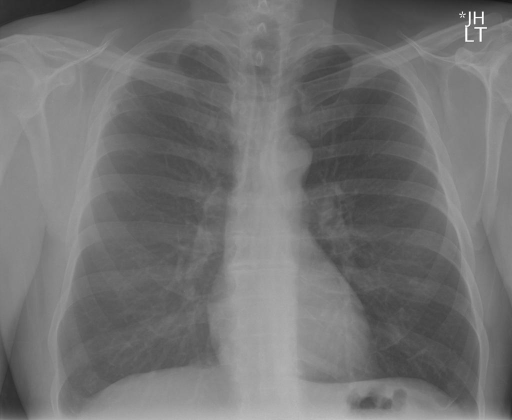

2

87it [00:44,  1.95it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： stable scarring near the right lung ape along the lateral aspect   lungs are otherwise clear   no pleural effusions pneumothoraces   heart and mediastinum normal size and contour   degenerative changes the spine  


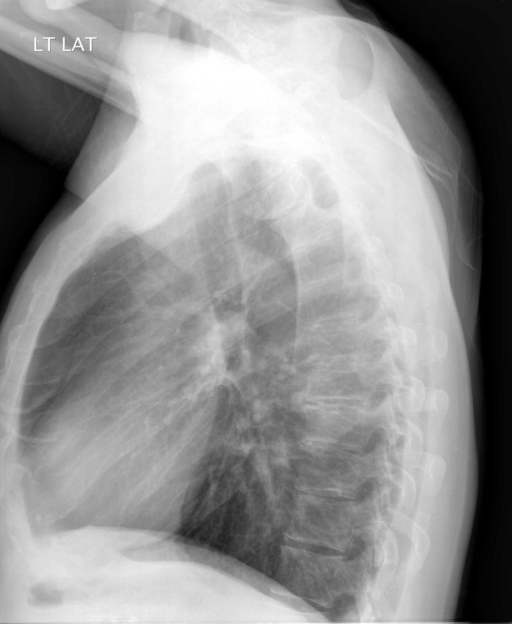

2

88it [00:44,  1.92it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： there chronic asymmetric elevation the right hemidiaphragm   compared with the prior study there mildly increased streaky airspace disease the right lung base   hilar prominence appears stable   there no pneumothora large pleural effusion   heart size stable and grossly normal   there no acute bony findings  


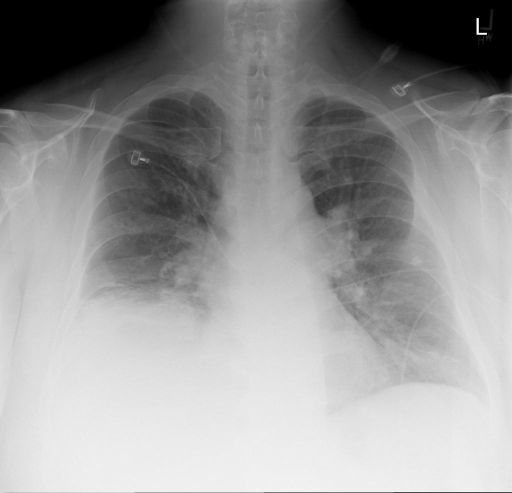

2

89it [00:45,  1.96it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart normal size   the mediastinum unremarkable   the lungs are clear  


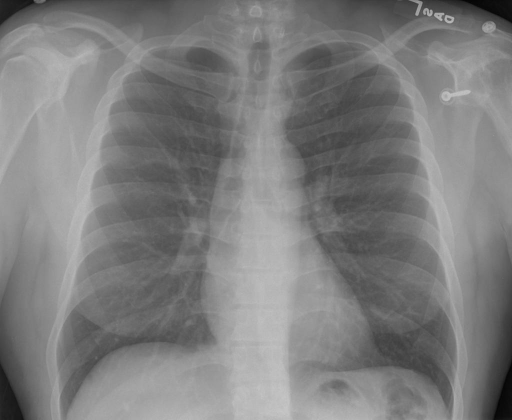

2

90it [00:45,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs are clear   there no pleural effusion pneumothora   the heart and mediastinum are normal   there mild scoliosis the spine  


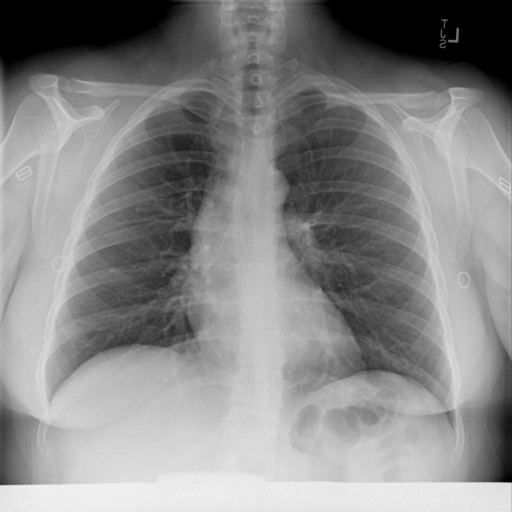

2

91it [00:46,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： lungs are clear without focal consolidation effusion pneumothora   normal heart size   bony thora and soft tissues grossly unremarkable  


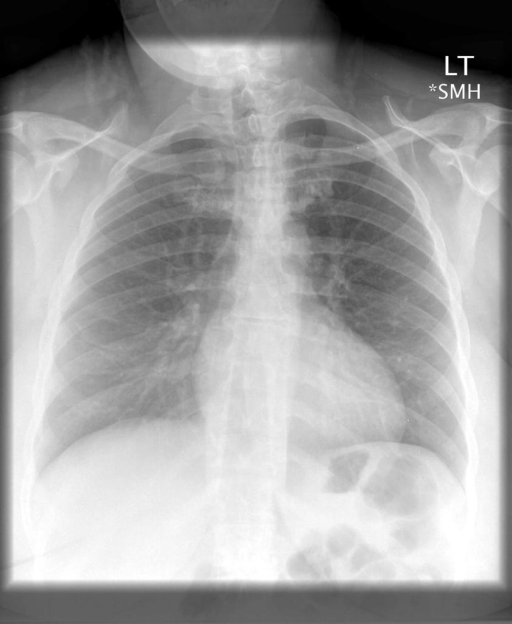

2

92it [00:46,  1.99it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiac silhouette upper mediastinum and pulmonary vasculature are within normal limits   there no acute air space infiltrate pleural effusion pneumothora  


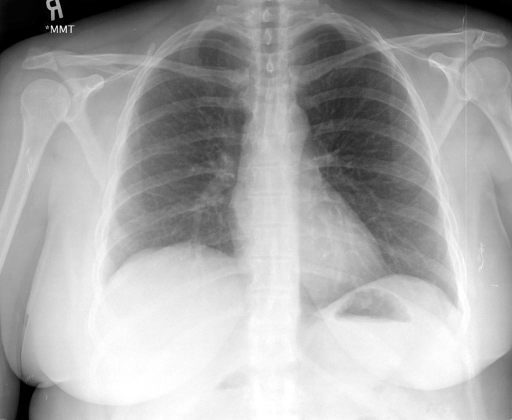

2

93it [00:47,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： lungs are clear   no pleural effusions pneumothoraces   heart and mediastinum normal size and contour  


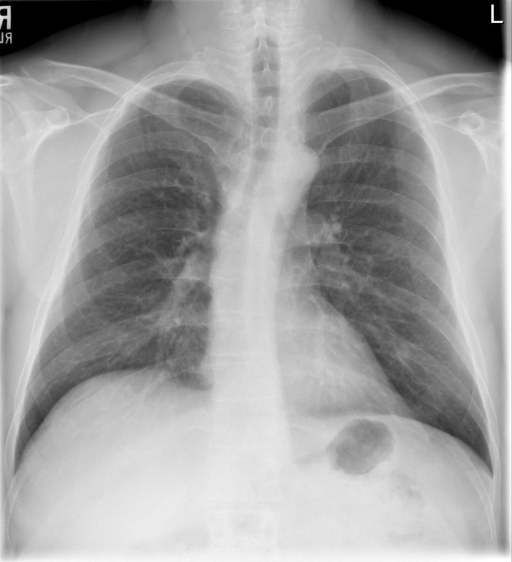

2

94it [00:47,  1.99it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size within normal limits stable mediastinal and hilar contours   no focal alveolar consolidation no definite pleural effusion seen   no typical findings pulmonary edema   no pneumothora  


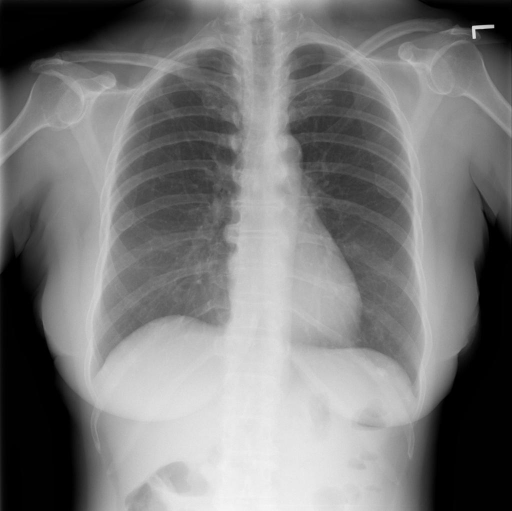

2

95it [00:48,  2.00it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the heart pulmonary and mediastinum are within normal limits   there no pleural effusion pneumothora   there bilateral basilar opacity compatible with atelectasis   there are somewhat low lung volumes   there calcified right hilar lymph node  


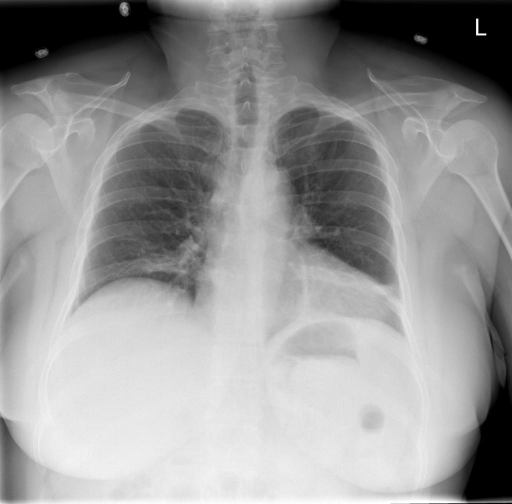

2

96it [00:48,  1.98it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiomediastinal silhouette within normal limits   lungs are clear without areas focal consolidation   no pneumothora large pleural effusion  


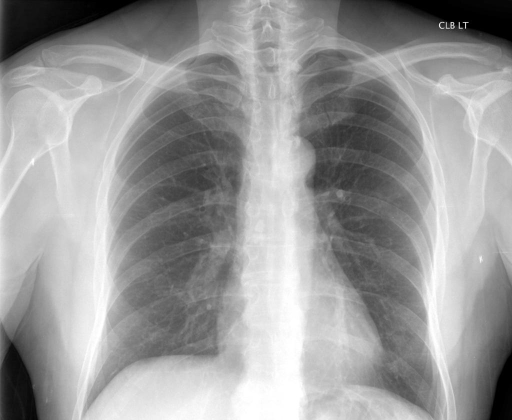

2

97it [00:49,  2.01it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiomediastinal silhouette within normal limits   lungs are clear without areas focal consolidation   no pneumothora large pleural effusion  


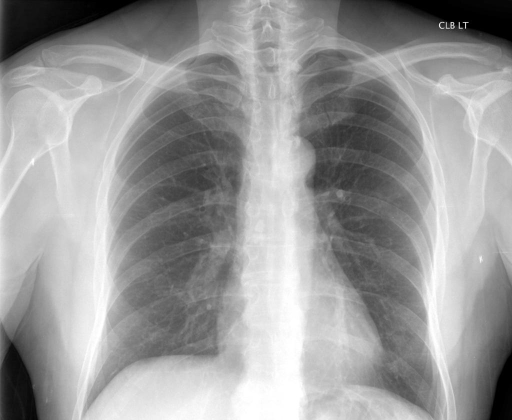

2

98it [00:49,  2.02it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the cardiomediastinal silhouette within normal limits   lungs are clear without areas focal consolidation   no pneumothora large pleural effusion  


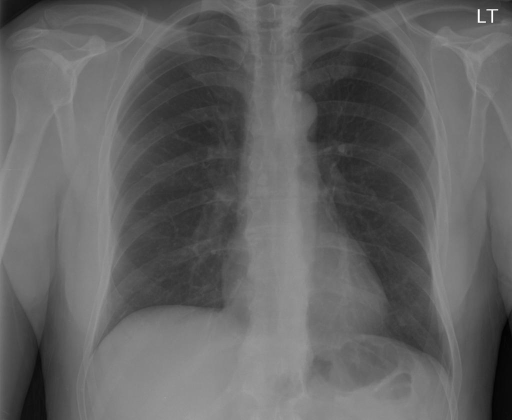

2

99it [00:50,  2.01it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size within normal limits   prominent right perihilar density consistent with lymphadenopathy previously partially demonstrated abdomen and pelvis negative for focal pulmonary consolidation pleural effusion pneumothora   tips noted  


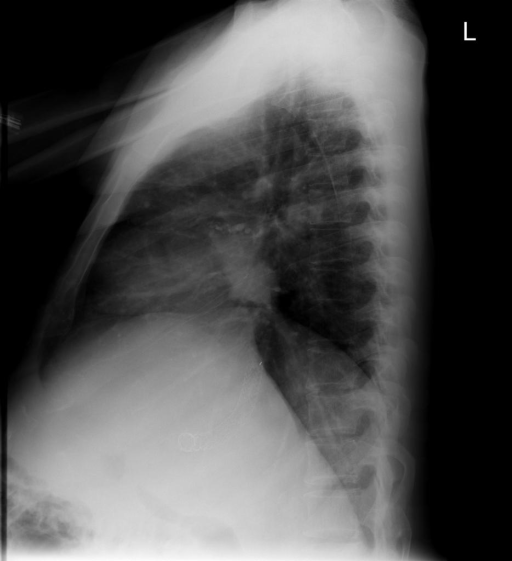

2

100it [00:50,  1.97it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the interval diameter nodule has developed the posterior segment the left lower lobe   not calcified   no other infiltrates masses the lungs   heart and pulmonary are normal   are normal  


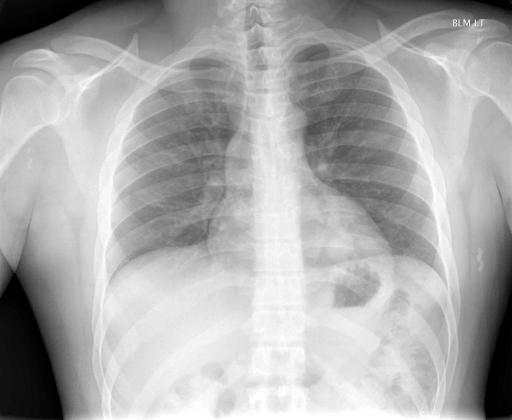

2

101it [00:51,  1.96it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： no focal consolidation pneumothora pleural effusion identified   however there nodular opacity within the right hilum which may represent partially calcified granuloma lymphadenopathy   scattered calcified granulomas also seen   heart size upper limit normal   no acute bony abnormality  


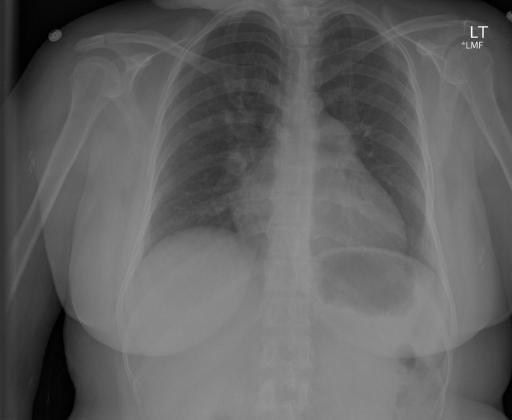

2

102it [00:51,  1.99it/s]

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： the lungs are clear and without focal air space opacity   the cardiomediastinal silhouette normal size and contour   there no pneumothora large pleural effusion  


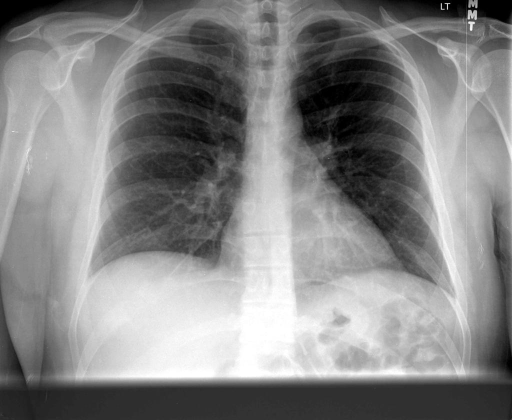

2

103it [00:52,  1.96it/s]


KeyboardInterrupt: 

In [91]:
# 验证数据集
from IPython.display import display
from PIL import Image
import numpy as np
from tqdm import tqdm

path = '../data/NLMCXR/NLMCXR_png/'
csvData = pd.read_csv('Test_Data.csv')
h5f = h5py.File('../../CLIP-out/h5/test_clip_features1.h5','r')
data = csvData.iloc[:,:]
scores = []

Beam_Size = 3
for idx,data_ in tqdm(enumerate(data.iterrows())):
    Person_id = data_[1][0]
    F_name = data_[1][1]
    F_text = data_[1][3]

    img_name = F_name.split('/')[-1]
    
    h5f_name = Person_id
    
    img_feature = np.array(h5f[h5f_name])
    
    img_path = F_name
    
    img_feature = torch.tensor(img_feature)
    
    img_feature = img_feature.to(device)
    model_pred.to(device)
    results = model_pred.generate(img_feature,beam_size=Beam_Size)

    print('预测结果：',results[Beam_Size-1])
    print('正确结果：',F_text)

    img = Image.open(img_path).convert('RGB')
    display(img, Image.BILINEAR)
    
    # 计算BLUE
    from nltk.translate.bleu_score import sentence_bleu
    reference = [F_text.split(' ')]
    candidate = results[Beam_Size-1].split(' ')
    score = sentence_bleu(reference,candidate)
    scores.append(score)

print('预测结果：',results[Beam_Size-1])
print('正确结果：',F_text)
print('BLEU:',np.mean(scores))
img = Image.open(img_path).convert('RGB')
display(img, Image.BILINEAR)

预测结果： the size the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs the lungs
正确结果： heart size within normal limits   negative for focal pulmonary consolidation pleural effusion pneumothora   there hyperepansion the lungs   mild degenerative changes are present the spine  
BLEU: 9.225353055953022e-156


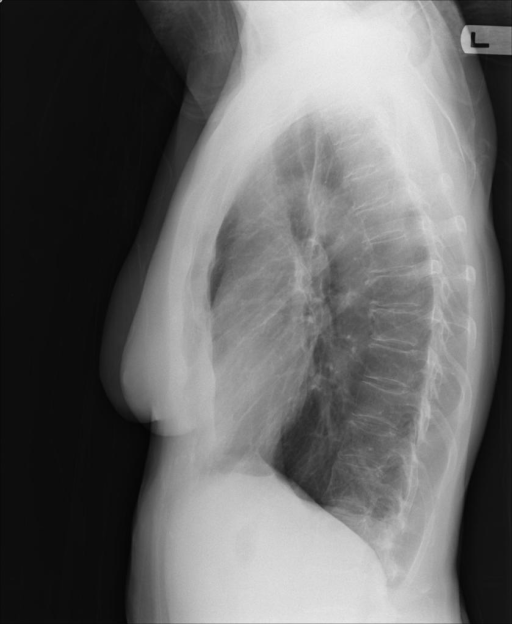

2

In [92]:
print('预测结果：',results[Beam_Size-1])
print('正确结果：',F_text)
print('BLEU:',np.mean(scores))
img = Image.open(img_path).convert('RGB')
display(img, Image.BILINEAR)

In [67]:
h5f_name

'../data/NLMCXR/NLMCXR_png/CXR636_IM-2215_0'

In [60]:
h5f.close()

In [73]:
h5f1

<HDF5 file "train_clip_features1.h5" (mode r)>

预测结果： the lungs the size the size the size the size the size the size the size the size the size the size the size the size the size the size the size the size the size the size the size
正确结果： increased opacity the right upper lobe with associated atelectasis may represent focal consolidation mass lesion with atelectasis   recommend chest ct for further evaluation   opacity overlying the left rib may represent focal airspace disease  


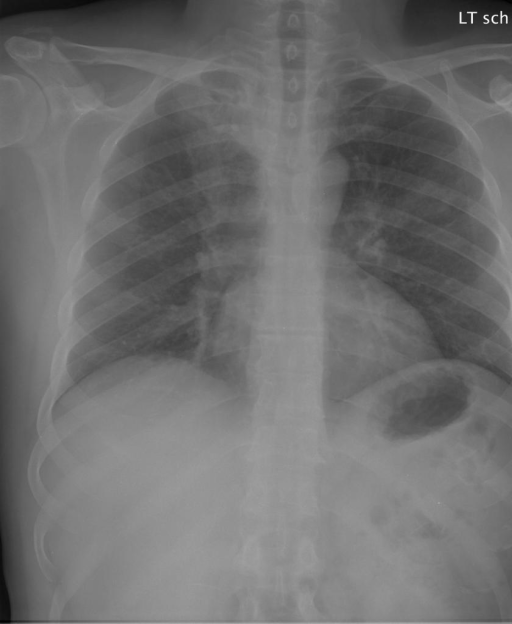

2

C:\Users\wangn\anaconda3\envs\pytorch\lib\site-packages\nltk\translate\bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\wangn\anaconda3\envs\pytorch\lib\site-packages\nltk\translate\bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
C:\Users\wangn\anaconda3\envs\pytorch\lib\site-packages\nltk\translate\bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram or

In [74]:
Person_id = '../data/NLMCXR/NLMCXR_png/CXR1000_IM-0003_0'
F_name = '../data/NLMCXR/NLMCXR_png/CXR1000_IM-0003-1001.png'
F_text = 'increased opacity the right upper lobe with associated atelectasis may represent focal consolidation mass lesion with atelectasis   recommend chest ct for further evaluation   opacity overlying the left rib may represent focal airspace disease  '

img_name = F_name.split('/')[-1]

h5f_name = Person_id

img_feature = np.array(h5f1[h5f_name])

img_path = F_name

img_feature = torch.tensor(img_feature)

img_feature = img_feature.to(device)
model_pred.to(device)
results = model_pred.generate(img_feature,beam_size=Beam_Size)

print('预测结果：',results[Beam_Size-1])
print('正确结果：',F_text)

img = Image.open(img_path).convert('RGB')
display(img, Image.BILINEAR)

# 计算BLUE
from nltk.translate.bleu_score import sentence_bleu
reference = [F_text.split(' ')]
candidate = results[Beam_Size-1].split(' ')
score = sentence_bleu(reference,candidate)
scores.append(score)

In [17]:
epoch = 15
batch_size = 16
learning_rate = 5e-5

loss_img = nn.CrossEntropyLoss().to(device)
loss_txt = nn.CrossEntropyLoss().to(device)
optimizer = optim.Adam(model.parameters(), lr=learning_rate, betas=(0.9, 0.98), eps=1e-6, weight_decay=0.2)

In [18]:
def convert_models_to_fp32(model):
    for p in model.parameters():
        p.data = p.data.float()
        p.grad.data = p.grad.data.float()

In [23]:
for i in range(epoch):
    print('----[%d] epoch---' % (i + 1))
    for batch in train_loader:

        images, report, person_id = batch
        report = clip.tokenize(texts=report, truncate=True).to(device)#truncate=True截断句子
        # images = images.to(device)
        image1 = images[0].to(device)
        image2 = images[1].to(device)

        # 通过logits_per_image, logits_per_text = model(images, texts)可以得到预测结果，与torch.arange(N)计算交叉熵进行优化
        logits_per_image1, logits_per_text = model(image1, report)
        if device == "cpu":
            ground_truth = torch.arange(batch_size).long().to(device)
            print("cpu")
        else:
            ground_truth = torch.arange(batch_size, dtype=torch.long, device=device)

        # 反向传播
        total_loss = (loss_img(logits_per_image1, ground_truth) + loss_txt(logits_per_text, ground_truth)) / 2
        optimizer.zero_grad()
        total_loss.backward()
        if device == "cpu":
            optimizer.step()
        else:
            convert_models_to_fp32(model)
            optimizer.step()
            clip.model.convert_weights(model)

    print('[%d] loss: %.6f' % (i + 1, total_loss))
torch.save(model, 'D:/coding/Jupyter/CLIP-out/model1.pkl')

----[1] epoch---
[1] loss: 2.791016
----[2] epoch---
[2] loss: 2.769531
----[3] epoch---
[3] loss: 2.775391
----[4] epoch---
[4] loss: 2.777344
----[5] epoch---
[5] loss: 2.777344
----[6] epoch---
[6] loss: 2.761719
----[7] epoch---
[7] loss: 2.769531
----[8] epoch---
[8] loss: 2.773438
----[9] epoch---
[9] loss: 2.773438
----[10] epoch---
[10] loss: 2.773438
----[11] epoch---
[11] loss: 2.773438
----[12] epoch---
[12] loss: 2.773438
----[13] epoch---
[13] loss: 2.773438
----[14] epoch---
[14] loss: 2.773438
----[15] epoch---
[15] loss: 2.773438
